# Feature Extraction Notebook - ChirPy
This notebook details the methods used to pre-process audio data for the ChirPy classifier. All default values are specific to BirdCLEF 2021 kaggle challenge, but can be changed in the Global Config section

Written by Eric Gonzalez

### Import Packages

In [145]:
import os
import matplotlib.pyplot as plt
import librosa
import librosa.display
import IPython.display as ipd
from scipy import stats
from copy import copy
import numpy as np
import logging
import pandas as pd
from scipy import signal
import scipy
from scipy import ndimage
from dateutil.parser import parse
from time import time
from datetime import date
from glob import glob
# logging options
#logging.basicConfig(filename='analysis_tools.log',filemode='w',level=logging.DEBUG)
logging.basicConfig(level=logging.INFO)


### Global Configuration Variables

In [2]:
# path to kaggle data folder, based on user system
rel_path = '../Bird Data/'

# path to location where feature extraction dataframes will be saved
save_path = rel_path+'processed_data/'
# create save path if it does not exist
if not os.path.exists(save_path): os.mkdir(save_path)

# paths relative to kaggle
metadata_path      = rel_path+'train_metadata.csv'
short_audio_path   = rel_path+'train_short_audio/'
long_audio_path    = rel_path+'train_soundscapes/'
long_metadata_path = rel_path+'train_soundscape_labels.csv'
long_loc_path      = rel_path+'test_soundscapes/'

# default values for various quantities
default_sample_rate  = 32000
default_n_fft_fine   = 2048
default_n_fft_coarse = 1024
default_audio_extension = ['.ogg']
default_alpha = 0.25
default_peak_pad = 0.15

## Data Loading Functions

First we will define functions to read the audio data from a specified path. 

In [3]:
# function for loading all audio clips in a directory
# default extension: .ogg
# audio_fpath is the relative or absolute path to the folder containing audio files of interest
def load_audio_files(audio_fpath,ext=default_audio_extension):
    #initialize list for holding audio files
    audio_files = []
    #recursively load audio, then filter based on specified extension(s)
    for root,dirs,files in os.walk(audio_fpath):
        for file in files:
            if file.endswith(tuple(ext)):
                audio_files.append(root+'/'+file)
    # retuns a list with path to all audio files with specified extension(s)
    return audio_files

# define a function to quickly and easily load audio files for testing/writing functions
def test_audio(short_path=short_audio_path,long_path=long_audio_path):
    #use function on both paths
    short_audio_files = load_audio_files(short_path)
    long_audio_files  = load_audio_files(long_path)
    return short_audio_files[:10], long_audio_files[:10]

Now we can make use of the `librosa` package to easily load audio data from file path. 
* We take the convention that `x` is the time series data and `X` is the frequency domain data. In general, time series data and its variations will be lower case while frequency domain data will be upper case.
* The `smoothing` boolean enables smoothing via a gaussian filter. The `gsigma` option is the standard deviation of the gaussian kernel.
* The parameter `sr` is the sample rate of the audio file. The default is $32,000\ \text{Hz}$.
* When possible, time series data is windowed prior to a fourier transformation to suppress spectral leakage. A tukey window is chosen as it does not modify transient signals as much as other window choices [1,2].
* The parameter `alpha` is a shape parameter, from the `scipy` documentation: "Shape parameter of the Tukey window, representing the faction of the window inside the cosine tapered region. If zero, the Tukey window is equivalent to a rectangular window. If one, the Tukey window is equivalent to a Hann window."
* Returns the original, unwindowed time series data, `x`, the stft of the time data, `X`, and an array of the frequencies corresponding to `X`, `freqs`. We also return `window_function` in case we need to invert the transformation and obtain the data from inverting the fourier transform on `X`.

In [4]:
# function for loading both time series data x and 
def librosa_load_both(audio_file,sr=default_sample_rate,\
              window='tukey',alpha=default_alpha,n_fft=default_n_fft_fine,smoothing=True,gsigma=1):
    #librosa takes audio clip path and loads it as a waveform array
    x, sr = librosa.load(audio_file,sr=sr)
    
    # perform gaussian smoothing
    x = ndimage.gaussian_filter1d(x,gsigma)
    
    # use window function to suppress spectral leakage
    if window == 'tukey':
        window_function = signal.windows.tukey(x.shape[0],alpha)
    elif window =='none':
    # option to use no is kept, in case it is needed
        window_function = 1
    else: 
        valid_windows = ['tukey','none']
        statement = """Window function \'{}\' has not been implemented or does not exist.
            Please select from {}""".format(window,valid_windows)
        raise ValueError(statement)

    # window the time series data
    x_win = x.copy()
    x_win *= window_function
    
    #librosa's short time ft
    X = librosa.stft(x_win,n_fft=n_fft)
    freqs = np.arange(0, 1 + n_fft / 2) * sr / n_fft
    return x, X, freqs, window_function

One low level, but extremely useful feature is the power spectral density. The power spectral density $S(f)$ or `psd` is given by the diagonal terms of the covariance matrix, $C_{i,j}$ of the frequency domain data `X`. The following function returns the power spectrum of `X` along with the mean `mu` and variance `sigma` of said power spectrum.

In [5]:
def compute_psd_data(X):
    Xcov = np.cov(X)
    psd = np.abs(np.diag(Xcov))
    mu = np.mean(psd)
    sigma = np.std(psd)
    return psd, mu, sigma

## Data Visualization I

Basic audio visualization plots: Time Series Plot,  Spectrogram, Power Spectral Density, and Covariance Matrix

In [41]:
def basic_plots(x,X,freqs,sr=default_sample_rate):
    # set up plotting canvas
    fig = plt.figure(figsize=(12,16))
    gs  = fig.add_gridspec(3,2,wspace=0.2,hspace=0.4)
    ax1 = fig.add_subplot(gs[0,:])
    # librosa has useful plotting functions
    # plot the time series data
    ax1.set_title('Waveplot of Time Series Data')
    librosa.display.waveplot(x,sr)
    
    # create a spectrogram
    ax2 = fig.add_subplot(gs[1,0])
    ax2.set_title('Spectrogram of Frequency Domain')
    Xdb = librosa.amplitude_to_db(abs(X))
    librosa.display.specshow(Xdb,sr=sr,x_axis='time',y_axis='log')
    plt.colorbar(label='Amplitude (db)')
    
    # alongside the spectrogram, display the covariance matrix
    ax3 = fig.add_subplot(gs[1,1])
    ax3.set_title('Covariance Matrix of Frequency Domain Data')
    Xcov = np.cov(X)
    Xdbcov = librosa.amplitude_to_db(abs(Xcov))
    librosa.display.specshow(Xdbcov,sr=sr,x_axis='log',y_axis='log')
    plt.colorbar(label='Amplitude')
    
    #compute psd for plotting
    psd,psd_mu,psd_sigma = compute_psd_data(X)
    # plot the power spectrum
    ax4 = fig.add_subplot(gs[2,:])
    ax4.set_title('Power Spectral Density')
    ax4.plot(freqs,psd+1,c='k')
    ax4.set_xlabel('Frequency ($Hz$)')
    plt.show()

### Testing Functions, First Visualization

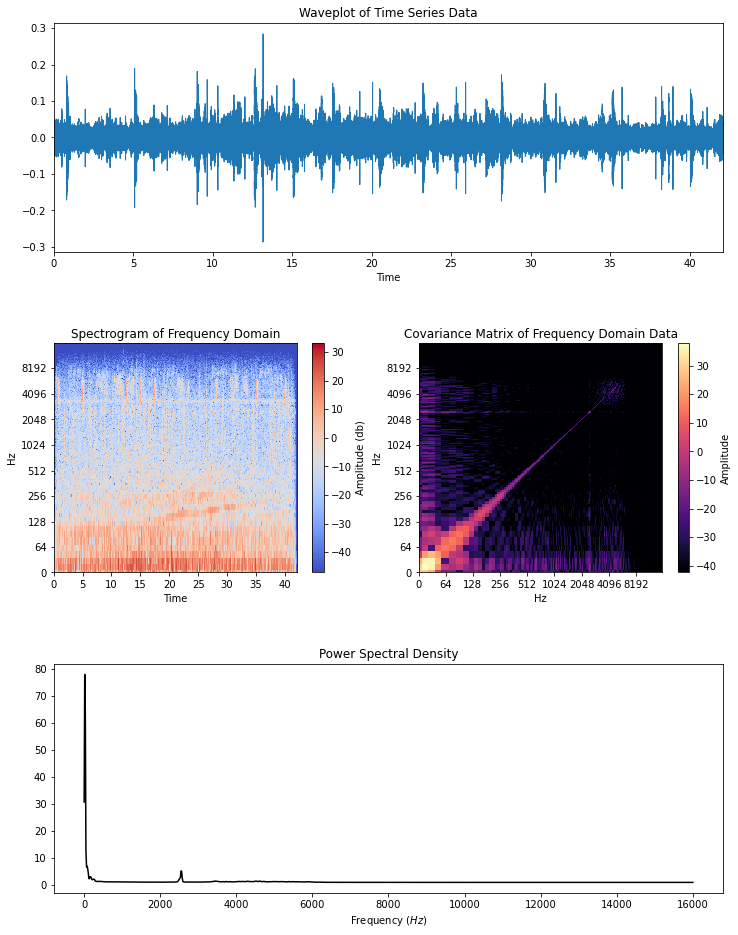

In [7]:
short_audio,long_audio = test_audio()
x,X,freqs,window_function = librosa_load_both(short_audio[5])
#x,X,freqs,window_function = librosa_load_both(long_audio[5])
basic_plots(x,X,freqs)
ipd.Audio(x,rate=default_sample_rate)

## Noise Reduction and Event Localization

In principle, we can reduce the noise in our samples by estimating the power spectrum of the noise and using our estimation to remove the noise from the audio data by rescaling the frequency in each bin in `X` according to the amplitude of the noise in that bin. The noise reduced signal $X_\text{NR}$ with equally weighted bins is then [2]

$$X_\text{NR}(f)= \frac{X(f)}{\left[S(f)\right]^{1/2}}$$

The $0^\text{th}$ order estimation of the noise would be to take the power spectrum of the entire clip; for a long enough clip the noise would be dominant. This may work for the long $10\ \text{min}$ clips but the short training clips are on the order of $30-60\ \text{sec}$, in which case it is harder to justify.

The $1^\text{st}$ order correction to our estimate would be to remove any signal events from the clip, then take the power spectrum of the residual time series data. We write the following functions to make these estimates.

### Noise Reduction 

First we can test the $0^\text{th}$ order estimate by taking clips and rescaling by the overall power. The following function performs this task and returns a new set nose reduced of time and frequency domain data, `x_NR` and `X_NR` respectively.

In [64]:
def noise_reduction(x,X,window_function,sr=default_sample_rate,n_fft=default_n_fft_fine,filter_red=False,filter_red_val=128):
    # we use the fft from the windowed function to find the power spectrum
    psd,psd_mu,psd_sigma = compute_psd_data(X)
    # compute amplitude of noise in each bin
    noise_amp = np.sqrt(np.abs(psd))
    
    # use new instance of stft as X came from a windowed x
    X_NR = librosa.stft(x*window_function)
    # iterate over frequency bins
    for i,amplitude in enumerate(noise_amp):
        # divide all samples of a given frequency in the spectrogram by the psd amplitude
        # avoid amplifying bins with no power using min function
        X_NR[i,:] /= amplitude+1
    
    # invert fft onrescaled spectral data
    ## normalize time series data to unit variance
    #x_NR /= np.std(x_NR)
    # compute frequency based on n_ffts
    freqs = np.arange(0, 1 + n_fft / 2) * sr / n_fft
    
    if filter_red: 
        def filter_scaling(freq):
            return psd_mu*(np.exp(-((freq-filter_red_val)**2)/(2*filter_red_val**2)))
        
        for i,freq in enumerate(freqs):
            if freq < filter_red_val:
                X_NR[i,:] = filter_scaling(freq)
            elif freq >= filter_red_val:
               break
    
    x_NR = librosa.istft(X_NR)
    
    return x_NR,X_NR,freqs

We can also define plotting functions to compare before and after the noise reduction.

In [9]:
def plot_denoise_comparisons(x,X,x_NR,X_NR,sr=default_sample_rate):
        # set up plotting canvas
    fig = plt.figure(figsize=(12,16))
    gs  = fig.add_gridspec(4,2,wspace=0.2,hspace=0.4)
    
    # create waveplots
    ax1 = fig.add_subplot(gs[0,:])
    ax1.set_title('Waveplot of Time Series Data')
    librosa.display.waveplot(x,sr)
        
    ax2 = fig.add_subplot(gs[1,:])
    ax2.set_title('Waveplot of Time Series Data after Denoising')
    librosa.display.waveplot(x_NR,sr)
    
    # create spectrograms
    ax3 = fig.add_subplot(gs[2,0])
    ax3.set_title('Spectrogram of Frequency Domain')
    Xdb = librosa.amplitude_to_db(abs(X))
    librosa.display.specshow(Xdb,sr=sr,x_axis='time',y_axis='log')
    plt.colorbar(label='Amplitude (db)')
    
    ax4 = fig.add_subplot(gs[2,1])
    ax4.set_title('Spectrogram of Frequency Domain after Denoising')
    Xdb_NR = librosa.amplitude_to_db(abs(X_NR))
    librosa.display.specshow(Xdb_NR,sr=sr,x_axis='time',y_axis='log')
    plt.colorbar(label='Amplitude (db)')

    #compute psd for plotting
    psd,psd_mu,psd_sigma = compute_psd_data(X)
    psd_NR,psd_mu_NR,psd_sigma_NR = compute_psd_data(X_NR)
    # plot the power spectrum
    ax5 = fig.add_subplot(gs[3,:])
    ax5.set_title('Power Spectral Density with and without Denoising')
    ax5.plot(freqs,psd,c='k',label='with noise')
    ax5.plot(freqs,psd_NR,'k-.',label='denoised')
    ax5.set_xlabel('Frequency ($Hz$)')
    ax5.legend()
    plt.show()

### Testing Noise Reduction

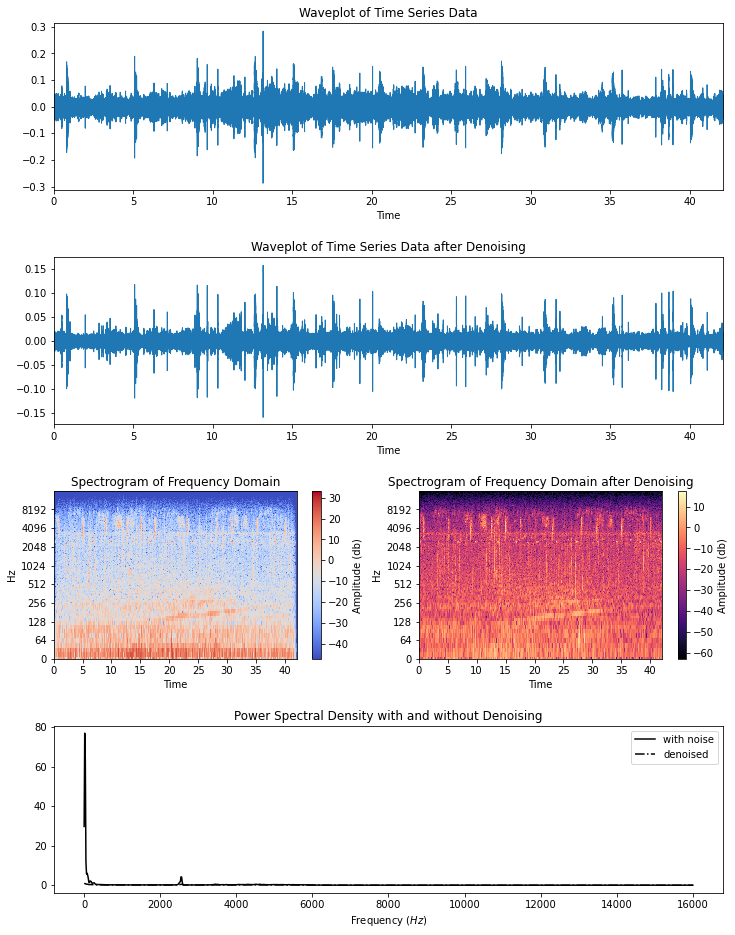

In [10]:
x_NR,X_NR,freqs = noise_reduction(x,X)
plot_denoise_comparisons(x,X,x_NR,X_NR)

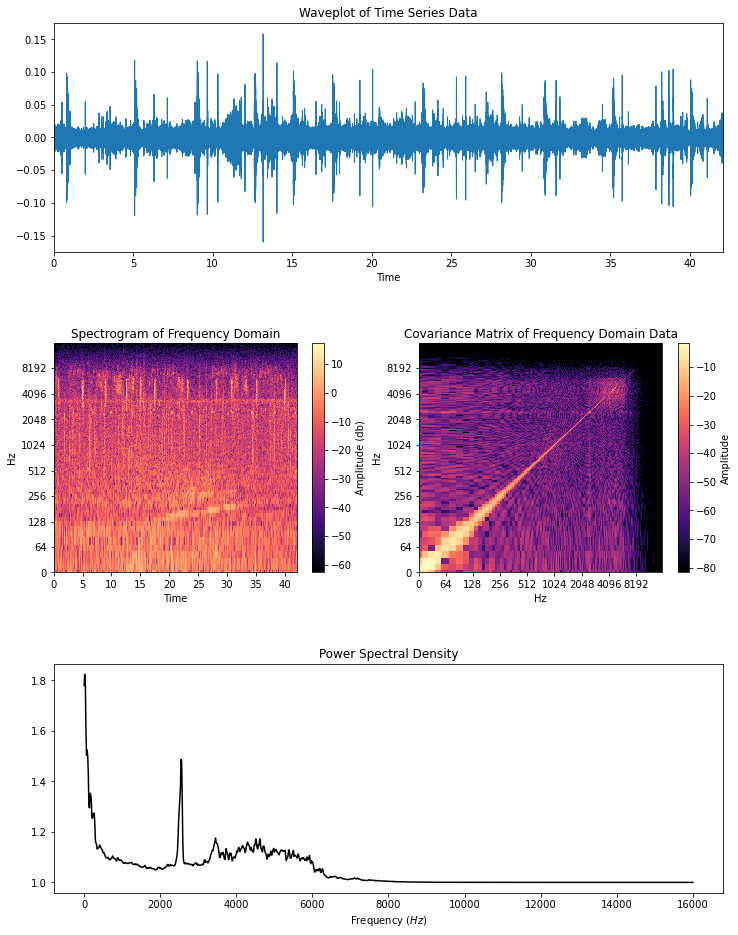

In [11]:
basic_plots(x_NR,X_NR,freqs)
ipd.Audio(x_NR,rate=default_sample_rate)

This method of noise reduction is simple and straightforward. Clearly the information in the power spectrum is erased in the denoised clip since all bins are weighted equally; the interesting information lies in the localized events. The denoising made peaks in the time series data more prominent, and this can help us perform the first order correction to the denoising. 

### Event Localization

In order to identify events in the time series data, we can make use of the `scipy.signal` package, namely two methods `find_peaks` and `find_peaks_cwt`.

The `find_peaks` method finds all local maxima by comaring neighboring values. Peaks can be filtered by selecting optional arguments in the `find_peaks` method, of interest to us are
* The `prominence` parameter, according to `scipy.signal` documentation is "how much a peak stands out from the surrounding baseline of the signal and is defined as the vertical distance between the peak and its lowest contour line."
* The `width` parameter can filter by requiring peaks to have a minimum width (and maximum width when two elements are specified), which is useful especially in the case where the width of the pulse can be approximated.

The `find_peaks_cwt` method uses a continuous wavelet transformation to determine the peak locations. This method convolves the time series data with a wavelet selected by the `wavelet` parameter with the wavelet size specified by `widths`. This method searches for ridge lines in originating from local maxima of wavelet coefficients at `widths` length scales, and accepts a peak if ridge lines indicate the relative maxima appears in successive length scales. We can perform a continuous wavelet transformation on the time series data to see the ridge lines and visualize the process.

In [12]:
def cwt_visualization(x,wavelet=signal.ricker,widths=np.logspace(9,14,base=2,num=100)):
    cwt_matrix = signal.cwt(np.abs(x),wavelet=wavelet,widths=widths)
    plt.figure(figsize=(8,8))
    plt.imshow(cwt_matrix,aspect='auto',vmax=abs(cwt_matrix).max(),vmin=0)
    plt.show()

In [13]:
#cwt_visualization(x_NR)

The strategy for peak finding is to cross reference these two methods for agreement. First, we write a function to perform `find_peaks` on the time series data. We also write a function for visualization. In the peak finding function, we note:
* Since the denoised data has prominent peak, the peaks will mostly be filtered by their `prominence`. The `prominence` threshold is `6*np.std(x)` to ensure we only catch signal peaks, if the noise is gaussian distributed then this should effectively filter out noise peaks.
* The `width` parameter needs to be specified in order for the method to return the peak width. It is important to return the peak width as it will be used to estimate the event duration and perhaps determine the scale for `widths` in `find_peaks_cwt`. We don't really care about filtering by width, we expect prominence to filter, so we cast a wide net with `widths=[0.5,5000]`.

In [14]:
def find_x_peaks(x,wavelet=signal.ricker,widths=[1,5000],prominence=None):
    # compute prominence, cannot set as default value due to x dependence
    if type(prominence) == type(None): prominence = np.std(x)*5
    # use method to find peaks, returns location of peak by index of x and the features of each peak.
    peaks,peak_features = signal.find_peaks(np.abs(x),width=widths,prominence=prominence)
    peak_features['indices'] = peaks
    return peaks,pd.DataFrame(peak_features)

def plot_x_peaks(x,sr=default_sample_rate,wavelet=signal.ricker,widths=[1,5000],prominence=None):
    # find peaks
    peaks,peak_features = find_x_peaks(x,wavelet=wavelet,widths=widths,prominence=prominence)
    # create time array for plotting
    time = np.arange(len(x))/sr
    
    plt.figure(figsize=(12,8))
    plt.plot(time,x)
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title('Peaks Found using `find_peaks` Method')
    
    # plotting peak center and width on a line above the time series data
    peak_line_height = 1.1*x.max()
    
    for i,peak_f in peak_features.iterrows():
        # find index of lower bound of width
        # max between lb and 0 to ensure we don't return negative index
        # subtract 1 for narrow peaks so lower edge doesn't coincide with center
        lb = max(int(peak_f['indices'] - (peak_f['widths'])/2 - 1),0)
        # repeat with upper bound, similar logic
        ub = min(int(peak_f['indices'] + peak_f['widths']/2 + 2),len(x))
        # compute width
        wd = ub-lb
        # create line from width
        wd_line = np.ones(wd)*peak_line_height
        # now plot line in correct time window
        plt.scatter(time[lb:ub],wd_line,c='k')

    plt.show()

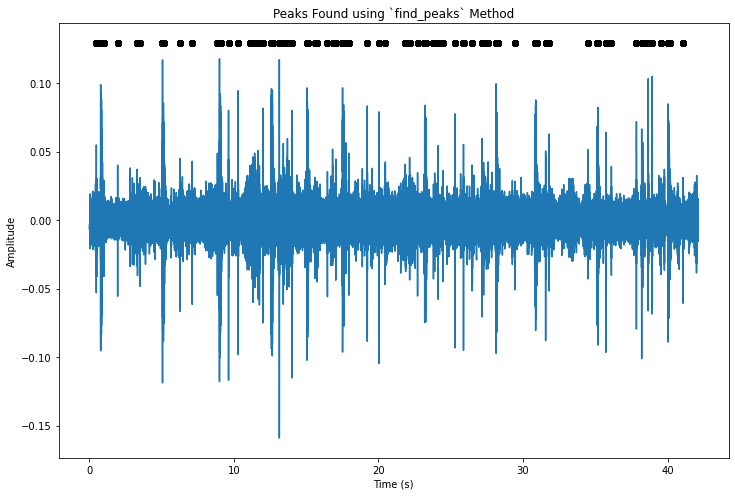

In [15]:
plot_x_peaks(x_NR)

Now we can try the `find_peak_cwt` method. The method in question only returns peak locations, not peak features so we don't need to write a function. Instead, we directly compute and plot the peaks from `find_peak_cwt`.

In [16]:
def plot_x_peaks_cwt(x,sr=default_sample_rate,widths=np.logspace(11,13,base=2,num=100)):
    
    # use method to find peaks, returns location of peak by index of x and the features of each peak.
    peaks = signal.find_peaks_cwt(x,widths=widths)
    
    # create time array for plotting
    time = np.arange(len(x))/sr
    
    plt.figure(figsize=(8,8))
    plt.plot(time,x)
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    
    # plotting peak center and width on a line above the time series data
    peak_points = np.ones(len(peaks))*1.1*x.max()
    plt.scatter(time[peaks],peak_points,c='k')
    
    plt.show()

In [17]:
#plot_x_peaks_cwt(x_NR)

It looks like the `find_peak_cwt` method is not suitable for this application, likely because the time series data has a relatively high sample rate. This causes the computation to take very long, so we will not be using it for this application.

## Noise and Signal Separation

Now that we have developed a method for selecting signal peaks, we can use this to separate the noise from the signals. The following function separates the time series by selecting all data that is at $x_\text{peak}\pm x_\text{pad}$ with the default value $x_\text{pad}=0.2\ \text{ms}$ is set by `default_peak_pad = 0.2`. Since our peak features extraction functions also estimate the width, the duration corresponding to one Full Width Half Maximum (FWHM) is included in $x_\text{peak}$. The argument `peak_features` is the dataframe returned from the `find_x_features` function, allowing for flexibility in peak localization implementation (rather than just calling `find_x_features` inside the function).
First we write a function to simply split the audio that is considered noise from the signal, without any additional processing.

In [18]:

def split_signal_noise_audio(x,peak_features,sr=default_sample_rate,peak_pad=default_peak_pad):
    #convert peak pad units ms to time index 
    signal_half_duration = peak_pad*sr
    # peak time span list initialization
    peak_time_list = []
    for i,peak_f in peak_features.iterrows():
        # find index of lower bound of width
        # max between lb and 0 to ensure we don't return negative index
        lb = int(peak_f['indices'] - (peak_f['widths'])/2)
        lb -= signal_half_duration
        lb = max(lb,0)
        # repeat with upper bound, similar logic
        ub = int(peak_f['indices'] + peak_f['widths']/2)
        ub += signal_half_duration 
        ub = min(ub,len(x)-1)
        
        # with foresight for dropping repeated indexes, we will convert a numpy array of the range to a pandas series
        peak_time = np.arange(lb,ub)
        peak_time_list.append(peak_time.copy())
    peak_time_series = pd.Series(peak_time_list,name='peak times').explode().drop_duplicates()
    peak_time_series = peak_time_series.astype(int).values
    
    time = np.arange(0,len(x))*default_sample_rate
    signal = x[peak_time_series]
    
    noise_time_series = np.delete(np.arange(len(x)),peak_time_series)
    noise = x[noise_time_series]
    
    fig = plt.figure(figsize=(12,8))
    gs  = fig.add_gridspec(2,1,wspace=0.2,hspace=0.4)
    
    ax1 = fig.add_subplot(gs[0,0])
    ax1.set_title('Waveplot of Time Series Signal Data')
    librosa.display.waveplot(signal,sr)
        
    ax2 = fig.add_subplot(gs[1,0])
    ax2.set_title('Waveplot of Time Series Noise Data')
    librosa.display.waveplot(noise,sr)
    return signal,noise
        


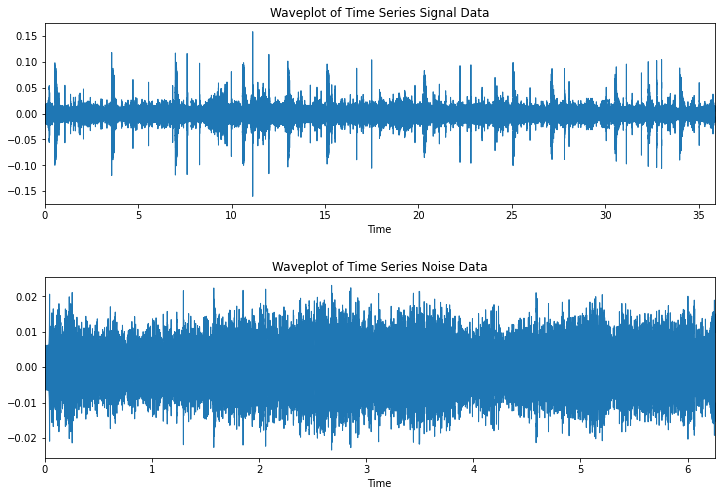

In [19]:
peaks,p_features = find_x_peaks(x_NR,prominence=np.std(x_NR)*3)
sig,noise = split_signal_noise_audio(x_NR,p_features)

#### Signal Audio

In [20]:
ipd.Audio(sig,rate=default_sample_rate)

#### Noise Audio

In [21]:
ipd.Audio(noise,rate=default_sample_rate)

There are still some calls in the background of the noise, we could in principle repeat the procedure but removing surious signals becomes much more difficult. We could also attempt to implement the `cwt` but in the interest of time we will skip it for now. Ultimately, this is a good approximation because we care about the overall features of the power spectrum with noise removed, with clean power spectral features the random forest will perform well.

### Noise Reduction Revisited

In order to make use of the clipped data, the noise clips must be appropriately windowed otherwise we risk adding spectral leakage due to discontinuities in the clip. We will reuse some of the above code to find the time span of the noise for appropriate windowing. The following function does index gymnastics to massage the estimated peak locations into two `pandas` dataframes, `peaks_df` and `noise_df`. Both dataframes have pairs of indexes which correspond to the edges of the peaks and noise in the time series data. This allows us to clip the audio for analysis.

In [153]:
def split_signal_noise(x,peak_features,sr=default_sample_rate,peak_pad=default_peak_pad):
    #convert peak pad units ms to time index 
    signal_half_duration = peak_pad*sr
    #initialize a dataframe to hold the peak bounds
    columns = ['lower bound','upper bound']
    peaks_df = pd.DataFrame(data=None,columns=columns)
    for i,peak_f in peak_features.iterrows():
        bound_dict = {}
        
        # find index of lower bound of width
        # max between lb and 0 to ensure we don't return negative index
        lb = int(peak_f['indices'] - (peak_f['widths'])/2)
        lb -= signal_half_duration
        lb = max(lb,0)
        bound_dict['lower bound'] = int(lb)
        # repeat with upper bound, similar logic
        ub = int(peak_f['indices'] + peak_f['widths']/2)
        ub += signal_half_duration 
        ub = min(ub,len(x)-1)
        bound_dict['upper bound'] = int(ub)
        peaks_df = peaks_df.append(bound_dict,ignore_index=True)
        
    # now that the df holds all the peak bounds, and is already organized in ascenting order,
    # we can merge peak windows
    # make array to hold indices to be dropped so we don't mess up the iteration
    to_drop_list = []
    
    for i,bounds in peaks_df[:-1].iterrows():
        #check for upper edge
        if bounds['upper bound'] < len(x)-1:
            if peaks_df.iloc[i+1]['lower bound'] <= bounds['upper bound'] and  \
                            bounds['upper bound'] <= peaks_df.iloc[i+1]['upper bound']:
                #if conditions are met, the peaks overlap
                bounds['upper bound'] = peaks_df.iloc[i+1]['upper bound']
                to_drop_list.append(i)
    peaks_df = peaks_df.drop(to_drop_list,axis=0)
    peaks_df = peaks_df.reset_index().drop('index',axis=1)
    
    if not peaks_df.empty:
        noise_bottom_edge = pd.Series([0],name='lower bound')
        noise_upper_edge  = pd.Series([len(x)],name='upper bound')
        noise_lb = pd.Series(peaks_df['upper bound'],name='lower bound')
        noise_ub = pd.Series(peaks_df['lower bound'],name='upper bound')

        if noise_ub.iloc[0]==0:
            noise_ub = noise_ub[1:]
        else:
            noise_lb = noise_bottom_edge.append(noise_lb)

        if noise_lb.iloc[-1]==len(x):
            noise_lb = noise_lb[:-1]
        else:
            noise_ub = noise_ub.append(noise_upper_edge)
        
        noise_lb = noise_lb.reset_index().drop('index',axis=1)
        noise_ub = noise_ub.reset_index().drop('index',axis=1)
        noise_df = pd.concat([noise_lb,noise_ub],axis=1)
    
    elif peaks_df.empty:
        noise_dict = {}
        noise_dict['upper bound'] = len(x)
        noise_dict['lower bound'] = 0
        noise_df = pd.DataFrame(data=noise_dict)
    
    return peaks_df,noise_df
        
def characterize_noise_psd(x,peak_features,alpha=0.5):
    peak_df,noise_df = split_signal_noise(x,peak_features)
    
    x_clipped = x.copy()
    for i,bounds in peak_df.iterrows():
        x_clipped[bounds['lower bound']:bounds['upper bound']] = 0
    x_unwindowed = x_clipped.copy()
    for i,bounds in noise_df.iterrows():
        lb = bounds['lower bound']
        ub = bounds['upper bound']
        x_clip = x[lb:ub].copy()
        window_function = signal.windows.tukey(x_clip.shape[0],alpha)
        x_clip *= window_function
        x_clipped[lb:ub] = x_clip[:]

    #full_clip = pd.Series(full_clip_list).explode()
    #x_clipped[:] = full_clip[:]
    #print(type(full_clip))
        #print(full_clip[:])
    X_clipped = librosa.stft(x_clipped)
    psd,mu,sigma = compute_psd_data(X_clipped)
    return psd,x_clipped,X_clipped

In [23]:
peaks,peak_features=find_x_peaks(x_NR)
mean_noise_psd,x_c,X_c = characterize_noise_psd(x_NR,peak_features)

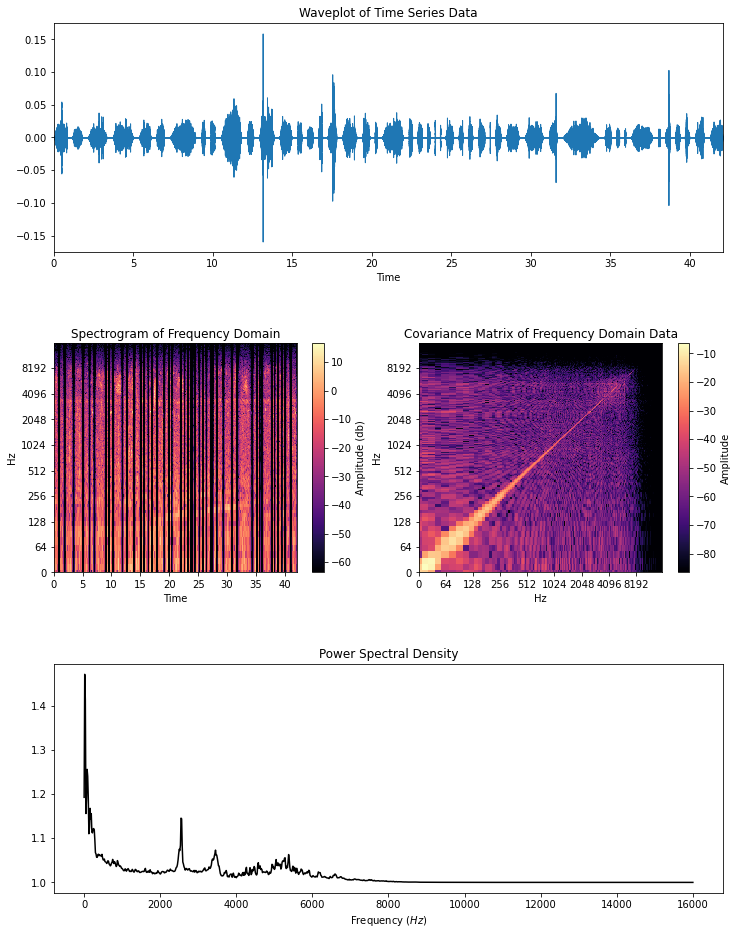

In [24]:
basic_plots(x_c,X_c,freqs)
ipd.Audio(x_c,rate=default_sample_rate)

In [38]:
x_NR2,X_NR2,freqs = noise_reduction(x,X_c,filter_red=False,filter_red_val=128)

In [26]:
ipd.Audio(x,rate=default_sample_rate)

In [27]:
ipd.Audio(x_NR,rate=default_sample_rate)

In [28]:
ipd.Audio(x_NR2,rate=default_sample_rate)

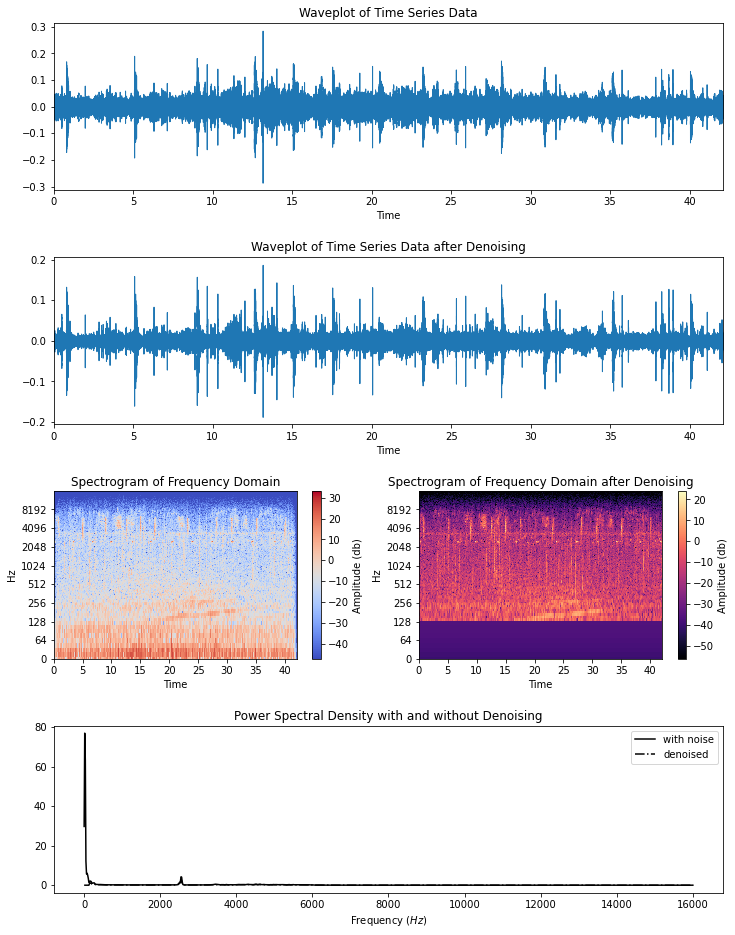

In [44]:
plot_denoise_comparisons(x,X,x_NR2,X_NR2)

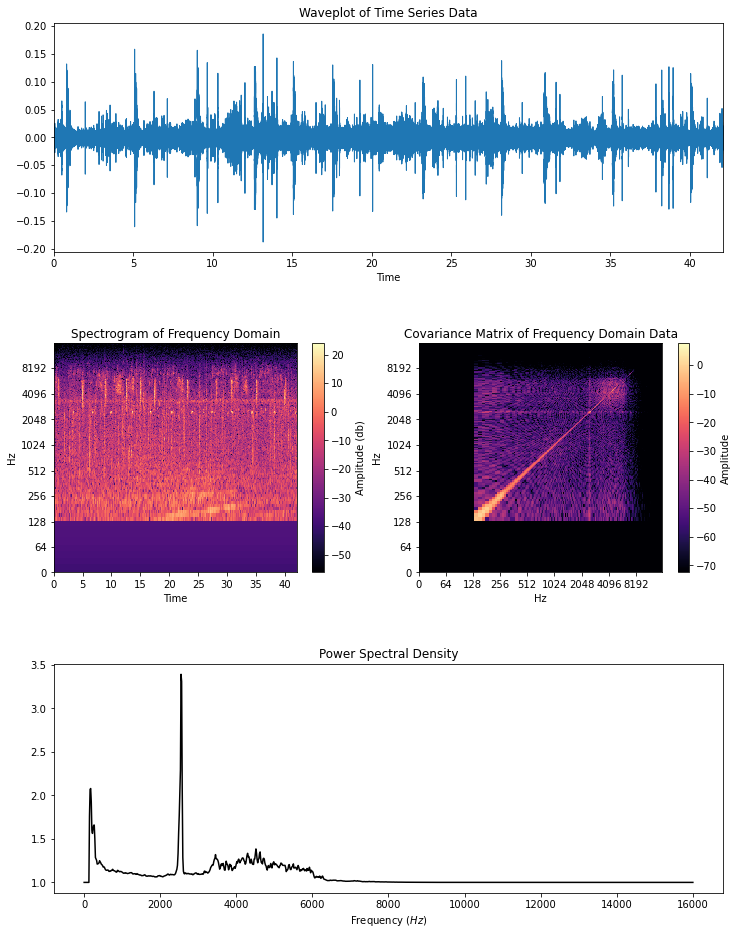

In [43]:
x_NR2,X_NR2,freqs = noise_reduction(x,X_c,filter_red=True,filter_red_val=128)
basic_plots(x_NR2,X_NR2,freqs)

## Feature Extraction

### Spectral Features

Compute basic spectral features in the following functions.

In [73]:
def spectral_descriptors(spectrum,freqs,ext=''):
    label_centr = 'centroid' + ext
    spec_desc = {}
    centr = np.sum(spectrum*freqs)/np.sum(spectrum)
    spec_desc[label_centr] = centr
    
    label_RMS = 'RMS' + ext
    spread = np.sqrt(  
        np.sum(((freqs-centr)**2)*spectrum) / np.sum(spectrum)  )
    spec_desc[label_RMS] = spread
    
    label_skew = 'skew' + ext
    skew = ( np.sum(((freqs-centr)**3)*spectrum) /
        (np.sum(spectrum)*(spread**3)) )
    spec_desc[label_skew] = skew
    
    label_kurto = 'kurtosis' + ext
    kurto = ( np.sum(((freqs-centr)**4)*spectrum) /
        (np.sum(spectrum)*(spread**4)) )
    spec_desc[label_kurto] = kurto
    
    label_entropy = 'entropy' + ext
    entropy = -np.sum(spectrum*np.log(spectrum))
    spec_desc[label_entropy] = entropy
    
    return spec_desc


def sig_peak_finder_internal(input_signal,freqs,primary_widths=[1,200],prominence_limit=0.1,n_peaks=3):
    peaks,peak_features= signal.find_peaks(input_signal,width=[1,200],prominence=prominence_limit)
    peak_features['indexes'] = peaks
    peak_features['frequency'] = freqs[peaks]
    df = pd.DataFrame(peak_features)
    top_peaks = df.sort_values(df.columns[0],ascending=False,axis=0).head(n_peaks).reset_index()
    feature_dict = {}
    iter_freq = []
    iter_prom = []
    iter_width = []
    iter_acc = []
    iter_index = []
    iter_wh = []
    iterable_features = {}
    
    for index,peak in top_peaks.iterrows():
        ipsd = peak['indexes']
        secondary_width = peak['widths']
        lower_limit = max([0,int(ipsd-secondary_width-1)])
        upper_limit = min([int(ipsd+secondary_width+2),len(input_signal)])
        sig_window = input_signal[lower_limit:upper_limit]
        if len(sig_window) == 0: continue
        peaks = signal.find_peaks_cwt(sig_window,widths=np.arange(1,int(secondary_width+1)),wavelet=signal.ricker)+lower_limit
        acc_check = pd.Series([(np.abs(peaks-ipsd))/secondary_width,1]).explode().values
        accuracy = 1 - min(acc_check)
        
        label_freq = 'peak%i_freqency'%index
        label_prom = 'peak%i_prominence'%index
        label_width = 'peak%i_width'%index
        label_agr = 'peak%i_agreement'%index
        label_index = 'peak%i_index'%index
        label_wh = 'peak%s_width_height'%index
        
        feature_dict[label_freq] = peak['frequency']
        feature_dict[label_prom] = peak['prominences']
        feature_dict[label_width] = secondary_width
        feature_dict[label_agr] = accuracy
        #feature_dict[label_index] = int(ipsd)
        feature_dict[label_wh] = peak['width_heights']
        
        iter_freq.append(peak['frequency'])
        iter_prom.append(peak['prominences'])
        iter_width.append(secondary_width)
        iter_acc.append(accuracy)
        iter_index.append(int(ipsd))
        iter_wh.append(peak['width_heights'])
        
    iterable_features['frequencies'] = iter_freq
    iterable_features['prominences'] = iter_prom
    iterable_features['widths'] = iter_width
    iterable_features['accuracies'] = iter_acc
    iterable_features['indexes'] = iter_index
    iterable_features['width_heights'] = iter_wh
        
    return feature_dict,iterable_features


def sig_peak_finder(input_signal,freqs,primary_widths=[1,200],prominence_limit=0.1,n_peaks=5,label_prefix='peak',extend_label=False,extension='_autocorr'):
    peaks,peak_features= signal.find_peaks(input_signal,width=[1,200],prominence=prominence_limit)
    peak_features['indexes'] = peaks
    peak_features['frequency'] = freqs[peaks]
    df = pd.DataFrame(peak_features)
    top_peaks = df.sort_values(df.columns[0],ascending=False,axis=0).head(n_peaks).reset_index()
    feature_dict = {}
    
    for index,peak in top_peaks.iterrows():
        ipsd = peak['indexes']
        secondary_width = peak['widths']
        lower_limit = max([0,int(ipsd-secondary_width)])
        upper_limit = min([int(ipsd+secondary_width+1),len(input_signal)])
        sig_window = psd[lower_limit:upper_limit]/input_signal_var
        if len(sig_window) == 0: continue
        peaks = signal.find_peaks_cwt(sig_window,widths=np.arange(1,int(secondary_width+1)),wavelet=signal.ricker)+lower_limit
        acc_check = pd.Series([(np.abs(peaks-ipsd))/secondary_width,1]).explode().values
        accuracy = 1 - min(acc_check)
        
        s_index = label_prefix+str(index)
        if extend_label: s_index+=extension
        
        label_freq = '%s_freqency'%s_index
        label_prom = '%s_prominence'%s_index
        label_width = '%s_width'%s_index
        label_acc = '%s_agreement'%s_index
        label_index = '%s_index'%s_index
        label_wh = '%s_width_height'%s_index
        
        feature_dict[label_freq] = peak['frequency']
        feature_dict[label_prom] = peak['prominences']
        feature_dict[label_width] = secondary_width
        feature_dict[label_acc] = accuracy
        #feature_dict[label_index] = int(ipsd)
        feature_dict[label_wh] = peak['width_heights']
        
    return feature_dict



Features of interest for long audio include:
* `primary_label`
* geo-spatial data: `longitude`, `latitude`, and `date`
* clip window `seconds` in `train_soundscape_labels`
* spectral features

The test data are labeled by date and location, so it is best to parse info from the files names in `train_soundscape` for labeling instead of going directly to the metadata. The following function parses a file and returns the relevant metadata.

In [ ]:
def long_audio_metadata(file_path,long_location_path=long_loc_path,ext=default_audio_extension[0]):
    metadata_dict = {}
    filename_index = file_path.rfind('/')
    filename = file_path[filename_index+1:]
    logging.info('Filename recovered: %s'%filename)
    metadata_dict['filename'] = filename
    
    file_id,location,date = filename.split('_')
    date = date[:-4]
    date = parse(date).date()
    logging.info('id: %s, loc: %s, date: %s'%(file_id,location,date))
    metadata_dict['date'] = date
    metadata_dict['audio_id'] = file_id
    metadata_dict['site'] = location
    location_file_ext = '_recording_location.txt'
    location_file = long_location_path + location + location_file_ext
    logging.info('location file path: %s'%location_file)
    with open(location_file,'r') as f:
        lines = f.readlines()
        lat  = float(str(lines[3]).split(':')[1])
        long = float(str(lines[4]).split(':')[1])
        logging.info('%s: latitude %f, longitude %f'%(location,lat,long))
    metadata_dict['longitude'] = long
    metadata_dict['latitude']  = lat
    return metadata_dict
        
def short_audio_metadata(file_path,metadata_path=metadata_path):
    columns = ['primary_label','secondary_labels','latitude','longitude','date','filename']
    metadata = pd.read_csv(metadata_path)
    filename_index = file_path.rfind('/')
    filename = file_path[filename_index+1:]
    metadata = metadata.loc[metadata['filename']==filename]
    metadata = metadata[columns]
    return metadata.to_dict(orient='records')[0]

def extract_spectral_features_short(audio_path):
    t0 = time()
    #load short metadata
    export_dict = short_audio_metadata(audio_path)
    #logging.info('Beginning extraction of {} at {}'.format(
    #    export_dict['filename'].values,date.fromtimestamp(time())))
    
    # load and stft
    x,X,freqs,window_function = librosa_load_both(audio_path)
    # noise reduction 0th order
    x_NR2,X_NR2,freqs = noise_reduction(x,X,window_function)
    # find peaks for second noise reduction
    #peaks, peaks_df = find_x_peaks(x_NR)
    #psd,x_c,X_c = characterize_noise_psd(x_NR,peaks_df)
    # noise reduction 1st order
    #x_NR2,X_NR2,freqs = noise_reduction(x,X_c,window_function,filter_red=True,filter_red_val=128)
    #analyze denoised signal
    psd_NR2,mu,sigma = compute_psd_data(X_NR2)
    #psd_NR2,mu,sigma = compute_psd_data(X_NR)
    
    #extract features from final denoised signal
    features_dict,features_iter = sig_peak_finder_internal(psd_NR2,freqs,n_peaks=3)
    export_dict.update(features_dict)
    
    psd,psd_mu,psd_std = compute_psd_data(X_NR2)
    spectral_desc = spectral_descriptors(psd,freqs)
    export_dict.update(spectral_desc)
    
    Xcov_NR2 = np.cov(X_NR2)
    for index,peak_index in enumerate(features_iter['indexes']):
        cov_spectrum = Xcov_NR2[peak_index,:]
        cov_spec_desc = spectral_descriptors(cov_spectrum,freqs,ext='_crosscor%s'%str(index))
        export_dict.update(cov_spec_desc.copy())
    tf = time()
    logging.info('Finished processing %s'%audio_path)
    logging.info('Time elapsed: %f seconds'%(tf-t0))
        
    return export_dict

def extract_spectral_features_long(audio_path,sr=default_sample_rate,n_fft=default_n_fft_fine,\
                   train_metadata=False,train_metadata_path=long_metadata_path):
    if train_metadata: t_df = pd.read_csv(train_metadata_path)
    t0 = time()
    #load short metadata
    metadata_dict = long_audio_metadata(audio_path)
    #logging.info('Beginning extraction of {} at {}'.format(
    #    export_dict['filename'].values,date.fromtimestamp(time())))
    x_precut = librosa.load(audio_path,sr=default_sample_rate)
    
    export_dict_list = []
    chunk_length = 5*default_sample_rate
    elapsed = 0
    length = len(x_precut)
    
    while elapsed < length:
        export_dict = {}
        export_dict.update(metadata_dict.copy())
        if elapsed == 0:
            x_noise_estimator = x_precut[elapsed+chunk_length:elapsed+3*chunk_length].copy()
            x_signal_region   = x_precut[elapsed:elapsed+chunk_length].copy()
        elif elapsed+chunk_length > length:
            x_noise_estimator = x_precut[elapsed-2*chunk_length:elapsed].copy()
            x_signal_region   = x_precut[elapsed:length].copy()
        else:
            x_noise_estimator = x_precut[int(elapsed-1.5*chunk_length):int(elapsed+1.5*chunk_length)].copy()
            x_signal_region   = x_precut[elapsed:elapsed+chunk_length].copy()
        
        wf = signal.windows.tukey(x_noise_estimator.shape[0],default_alpha)
        
        X_noise_estimator = librosa.stft(wf*x_noise_estimator)
        freqs = np.arange(0, 1 + n_fft / 2) * sr / n_fft

        # load and stft
        # noise reduction 0th order
        x_NR,X_NR,freqs = noise_reduction(x_noise_estimator,X_noise_estimator,window_function)
        # find peaks for noise reduction
        peaks, peaks_df = find_x_peaks(x_NR)
        psd,x_c,X_c = characterize_noise_psd(x_NR,peaks_df)
        # noise reduction 1st order
        x_NR2,X_NR2,freqs = noise_reduction(x,X_c,window_function,filter_red=True,filter_red_val=128)
        #analyze denoised signal
        psd_NR2,mu,sigma = compute_psd_data(X_NR2)

    #extract features from final denoised signal
        features_dict,features_iter = sig_peak_finder_internal(psd_NR2,freqs,n_peaks=3)
        export_dict.update(features_dict)

        spectral_desc = spectral_descriptors(psd_NR2,freqs)
        export_dict.update(spectral_desc)

        Xcov_NR2 = np.cov(X_NR2)
        for index,peak_index in enumerate(features_iter['indexes']):
            cov_spectrum = Xcov_NR2[peak_index,:]
            cov_spec_desc = spectral_descriptors(cov_spectrum,freqs,ext='_crosscor%s'%str(index))
            export_dict.update(cov_spec_desc.copy())
            
        elapsed_seconds = int(elapsed/32000)+5
        row_id_str = '{}_{}_{}'.format(metadata_dict['audio_id'],metadata_dict['site'],elapsed_seconds)
        row_id_dict = {'row_id':row_id_str}
        row_id_dict.update({'seconds':elapsed_seconds.copy()})
        export_dict.update(row_id_dict)
        if train_metadata:
            birds_value = train_metadata.loc[train_metadata['seconds']==elapsed_seconds]['birds'].values
            birds_dict = {'birds':birds_value}
            export_dict.update(birds_dict)
        elapsed += chunk_length
        export_dict_list.append(export_dict.copy())
    tf = time()
    logging.info('Finished processing %s'%audio_path)
    logging.info('Time elapsed: %f seconds'%(tf-t0))

    return export_dict_list

def preprocess_short_audio(range_specify=False,range_upper=397,range_lower=0):
    if not os.path.exists(save_path): os.mkdir(save_path)
    bird_list = glob(short_audio_path+'*')
    if range_specify:
        bird_list = bird_list[range_lower:range_upper]
    
    for bird_name in bird_list:
        df_name = bird_name + '_preprocess.csv'
        df = pd.DataFrame(data=None)
        short_audio = load_audio_files(bird_name,ext=default_audio_extension)
        for audio_file in short_audio:
            export_dict = extract_spectral_features_short(audio_file)
            df = df.append(export_dict,ignore_index=True)
        df.to_csv(df_name)
        
def preprocess_long_audio(range_specify=False,range_upper=20,range_lower=0):
    if not os.path.exists(save_path): os.mkdir(save_path)
    bird_list = glob(long_audio_path+'*')
    if range_specify:
        bird_list = bird_list[range_lower:range_upper]
    
        df_name = bird_name[:-4] + '_preprocess_long.csv'
        df = pd.DataFrame(data=None)
        short_audio = load_audio_files(short_audio_path,ext=default_audio_extension)
        for audio_file in short_audio:
            export_dict_list = extract_spectral_features_short(audio_file)
            df = df.append(export_dict_list,ignore_index=True)
        df.to_csv(df_name)
        



In [ ]:
preprocess_short_audio()

INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC109605.ogg
INFO:root:Time elapsed: 0.994174 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC11209.ogg
INFO:root:Time elapsed: 0.396570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC127032.ogg
INFO:root:Time elapsed: 0.789638 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC129974.ogg
INFO:root:Time elapsed: 0.385067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC129981.ogg
INFO:root:Time elapsed: 0.705624 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC130056.ogg
INFO:root:Time elapsed: 0.724627 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC130133.ogg
INFO:root:Time elapsed: 1.010178 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC130140.ogg
INFO:root:Time elapsed: 0.599105 seconds
INFO:root:Finished proces

INFO:root:Time elapsed: 4.572803 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC321796.ogg
INFO:root:Time elapsed: 0.563598 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC324813.ogg
INFO:root:Time elapsed: 0.390069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC324915.ogg
INFO:root:Time elapsed: 0.896157 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC324931.ogg
INFO:root:Time elapsed: 0.404071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC326699.ogg
INFO:root:Time elapsed: 2.166882 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC328245.ogg
INFO:root:Time elapsed: 0.492587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC340324.ogg
INFO:root:Time elapsed: 0.641613 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acafly/XC342676.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC124489.ogg
INFO:root:Time elapsed: 0.588603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC125254.ogg
INFO:root:Time elapsed: 0.315511 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC125478.ogg
INFO:root:Time elapsed: 0.682620 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC125508.ogg
INFO:root:Time elapsed: 0.434576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC129244.ogg
INFO:root:Time elapsed: 1.176207 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC129250.ogg
INFO:root:Time elapsed: 2.342411 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC135949.ogg
INFO:root:Time elapsed: 0.501588 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC135964.ogg
INFO:root:Time elapsed: 0.333558 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.474583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC323863.ogg
INFO:root:Time elapsed: 0.648114 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC323864.ogg
INFO:root:Time elapsed: 0.682621 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC323865.ogg
INFO:root:Time elapsed: 0.350561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC323867.ogg
INFO:root:Time elapsed: 0.707124 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC323869.ogg
INFO:root:Time elapsed: 0.576601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC323870.ogg
INFO:root:Time elapsed: 0.824145 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC323871.ogg
INFO:root:Time elapsed: 1.093193 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC328514.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC451278.ogg
INFO:root:Time elapsed: 0.800855 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC451363.ogg
INFO:root:Time elapsed: 1.073189 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC452359.ogg
INFO:root:Time elapsed: 0.999175 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC452360.ogg
INFO:root:Time elapsed: 0.570100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC453076.ogg
INFO:root:Time elapsed: 0.931663 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC466411.ogg
INFO:root:Time elapsed: 2.875797 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC466412.ogg
INFO:root:Time elapsed: 2.863003 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\acowoo/XC466413.ogg
INFO:root:Time elapsed: 0.991674 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.458080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC142066.ogg
INFO:root:Time elapsed: 0.335559 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC142067.ogg
INFO:root:Time elapsed: 0.597605 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC142068.ogg
INFO:root:Time elapsed: 0.387068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC142329.ogg
INFO:root:Time elapsed: 0.443578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC144099.ogg
INFO:root:Time elapsed: 0.371066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC144672.ogg
INFO:root:Time elapsed: 4.434779 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC144674.ogg
INFO:root:Time elapsed: 0.796640 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC144675.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC215908.ogg
INFO:root:Time elapsed: 0.323057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC215909.ogg
INFO:root:Time elapsed: 0.376332 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC215911.ogg
INFO:root:Time elapsed: 0.434576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC215912.ogg
INFO:root:Time elapsed: 0.806642 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC215913.ogg
INFO:root:Time elapsed: 0.671118 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC215915.ogg
INFO:root:Time elapsed: 0.666617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC215919.ogg
INFO:root:Time elapsed: 0.562099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC215932.ogg
INFO:root:Time elapsed: 0.852649 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.188209 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC302253.ogg
INFO:root:Time elapsed: 1.014678 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC31060.ogg
INFO:root:Time elapsed: 0.896658 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC31209.ogg
INFO:root:Time elapsed: 0.579102 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC31210.ogg
INFO:root:Time elapsed: 1.121697 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC313135.ogg
INFO:root:Time elapsed: 0.450640 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC317112.ogg
INFO:root:Time elapsed: 3.328085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC317903.ogg
INFO:root:Time elapsed: 0.367064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC318444.ogg
INFO:root:Time elapsed: 0.5

INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC599831.ogg
INFO:root:Time elapsed: 1.525269 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC600279.ogg
INFO:root:Time elapsed: 2.714977 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC600655.ogg
INFO:root:Time elapsed: 0.713125 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC604913.ogg
INFO:root:Time elapsed: 0.582102 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC604914.ogg
INFO:root:Time elapsed: 0.861650 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC604916.ogg
INFO:root:Time elapsed: 1.013678 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC605054.ogg
INFO:root:Time elapsed: 0.796139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\aldfly/XC611771.ogg
INFO:root:Time elapsed: 0.608107 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.096692 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC115429.ogg
INFO:root:Time elapsed: 0.641613 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC115938.ogg
INFO:root:Time elapsed: 0.948666 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC115939.ogg
INFO:root:Time elapsed: 0.968171 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC115940.ogg
INFO:root:Time elapsed: 0.966169 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC121396.ogg
INFO:root:Time elapsed: 2.108871 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC122378.ogg
INFO:root:Time elapsed: 1.035182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC122380.ogg
INFO:root:Time elapsed: 1.211713 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC122636.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC253628.ogg
INFO:root:Time elapsed: 0.316056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC253973.ogg
INFO:root:Time elapsed: 0.701623 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC264942.ogg
INFO:root:Time elapsed: 0.377066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC266710.ogg
INFO:root:Time elapsed: 1.184209 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC268481.ogg
INFO:root:Time elapsed: 3.118547 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC279721.ogg
INFO:root:Time elapsed: 0.708125 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC279723.ogg
INFO:root:Time elapsed: 0.320608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC279748.ogg
INFO:root:Time elapsed: 0.832629 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.759133 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC425502.ogg
INFO:root:Time elapsed: 0.408572 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC425504.ogg
INFO:root:Time elapsed: 0.478337 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC448753.ogg
INFO:root:Time elapsed: 1.464757 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC451028.ogg
INFO:root:Time elapsed: 1.373204 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC451209.ogg
INFO:root:Time elapsed: 0.737792 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC451491.ogg
INFO:root:Time elapsed: 0.413573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC452143.ogg
INFO:root:Time elapsed: 0.580603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC452517.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC578154.ogg
INFO:root:Time elapsed: 0.368564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC58460.ogg
INFO:root:Time elapsed: 2.502444 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC58475.ogg
INFO:root:Time elapsed: 0.471084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC595332.ogg
INFO:root:Time elapsed: 0.281050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC596195.ogg
INFO:root:Time elapsed: 0.391568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC599335.ogg
INFO:root:Time elapsed: 0.379066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC599687.ogg
INFO:root:Time elapsed: 5.079892 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amecro/XC600280.ogg
INFO:root:Time elapsed: 0.578102 seconds
INFO:root:Finished process

INFO:root:Time elapsed: 0.944166 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC215339.ogg
INFO:root:Time elapsed: 0.886655 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC217005.ogg
INFO:root:Time elapsed: 0.666117 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC236563.ogg
INFO:root:Time elapsed: 0.516591 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC237029.ogg
INFO:root:Time elapsed: 0.431076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC239645.ogg
INFO:root:Time elapsed: 0.383068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC239646.ogg
INFO:root:Time elapsed: 0.338560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC243428.ogg
INFO:root:Time elapsed: 0.260545 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC243792.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC433206.ogg
INFO:root:Time elapsed: 0.314055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC437593.ogg
INFO:root:Time elapsed: 1.466262 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC451733.ogg
INFO:root:Time elapsed: 0.916660 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC452142.ogg
INFO:root:Time elapsed: 0.388568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC453111.ogg
INFO:root:Time elapsed: 1.988349 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC453934.ogg
INFO:root:Time elapsed: 0.356062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC454621.ogg
INFO:root:Time elapsed: 0.323558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amegfi/XC462056.ogg
INFO:root:Time elapsed: 0.603606 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.680604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC214257.ogg
INFO:root:Time elapsed: 0.317555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC214259.ogg
INFO:root:Time elapsed: 0.318556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC216657.ogg
INFO:root:Time elapsed: 0.411572 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC238264.ogg
INFO:root:Time elapsed: 0.393568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC250844.ogg
INFO:root:Time elapsed: 0.383066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC253328.ogg
INFO:root:Time elapsed: 0.371067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC253935.ogg
INFO:root:Time elapsed: 0.402570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC253951.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC598756.ogg
INFO:root:Time elapsed: 0.983172 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC598758.ogg
INFO:root:Time elapsed: 0.465581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC603740.ogg
INFO:root:Time elapsed: 0.465081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC606523.ogg
INFO:root:Time elapsed: 0.490586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amekes/XC614738.ogg
INFO:root:Time elapsed: 1.199711 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC111040.ogg
INFO:root:Time elapsed: 0.616108 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC111041.ogg
INFO:root:Time elapsed: 0.595605 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC111042.ogg
INFO:root:Time elapsed: 0.551597 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.366564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC338292.ogg
INFO:root:Time elapsed: 0.296552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC339906.ogg
INFO:root:Time elapsed: 0.368066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC341450.ogg
INFO:root:Time elapsed: 0.323557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC342803.ogg
INFO:root:Time elapsed: 0.293552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC358830.ogg
INFO:root:Time elapsed: 0.385067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC358842.ogg
INFO:root:Time elapsed: 0.403571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC358862.ogg
INFO:root:Time elapsed: 0.291551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amepip/XC382376.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC139938.ogg
INFO:root:Time elapsed: 1.364740 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC142339.ogg
INFO:root:Time elapsed: 0.601605 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC142592.ogg
INFO:root:Time elapsed: 1.790314 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC144562.ogg
INFO:root:Time elapsed: 0.356062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC144666.ogg
INFO:root:Time elapsed: 0.741630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC145610.ogg
INFO:root:Time elapsed: 0.264046 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC147064.ogg
INFO:root:Time elapsed: 1.111696 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC147170.ogg
INFO:root:Time elapsed: 0.277548 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.685121 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC243789.ogg
INFO:root:Time elapsed: 0.328057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC243793.ogg
INFO:root:Time elapsed: 0.431576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC244412.ogg
INFO:root:Time elapsed: 0.505193 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC244534.ogg
INFO:root:Time elapsed: 1.009677 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC245807.ogg
INFO:root:Time elapsed: 0.359063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC246036.ogg
INFO:root:Time elapsed: 0.267547 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC246779.ogg
INFO:root:Time elapsed: 0.457080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC247312.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC333385.ogg
INFO:root:Time elapsed: 0.666617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC334892.ogg
INFO:root:Time elapsed: 2.132874 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC334893.ogg
INFO:root:Time elapsed: 1.032182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC334894.ogg
INFO:root:Time elapsed: 0.648884 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC334895.ogg
INFO:root:Time elapsed: 1.223716 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC339961.ogg
INFO:root:Time elapsed: 0.523841 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC351638.ogg
INFO:root:Time elapsed: 0.310010 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC353867.ogg
INFO:root:Time elapsed: 0.859151 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.857150 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC477187.ogg
INFO:root:Time elapsed: 0.883155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC478597.ogg
INFO:root:Time elapsed: 0.352062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC479494.ogg
INFO:root:Time elapsed: 0.700123 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC479495.ogg
INFO:root:Time elapsed: 1.048683 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC479496.ogg
INFO:root:Time elapsed: 0.624610 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC482459.ogg
INFO:root:Time elapsed: 0.451579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC483145.ogg
INFO:root:Time elapsed: 0.428575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amered/XC483200.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC138063.ogg
INFO:root:Time elapsed: 2.495938 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC138237.ogg
INFO:root:Time elapsed: 0.638613 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC138319.ogg
INFO:root:Time elapsed: 0.768635 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC138709.ogg
INFO:root:Time elapsed: 0.317055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC138712.ogg
INFO:root:Time elapsed: 0.729128 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC139054.ogg
INFO:root:Time elapsed: 0.781638 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC139086.ogg
INFO:root:Time elapsed: 0.447579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC139885.ogg
INFO:root:Time elapsed: 0.622109 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 3.414099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC165309.ogg
INFO:root:Time elapsed: 0.530593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC165310.ogg
INFO:root:Time elapsed: 1.791797 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC165311.ogg
INFO:root:Time elapsed: 0.537094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC165312.ogg
INFO:root:Time elapsed: 2.547447 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC165313.ogg
INFO:root:Time elapsed: 0.913401 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC168640.ogg
INFO:root:Time elapsed: 0.323556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC168641.ogg
INFO:root:Time elapsed: 0.412072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC16914.ogg
INFO:root:Time elapsed: 0

INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC253844.ogg
INFO:root:Time elapsed: 1.964345 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC253960.ogg
INFO:root:Time elapsed: 0.747631 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC254483.ogg
INFO:root:Time elapsed: 0.591104 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC254484.ogg
INFO:root:Time elapsed: 0.549096 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC264344.ogg
INFO:root:Time elapsed: 0.689621 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC265455.ogg
INFO:root:Time elapsed: 0.622335 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC267722.ogg
INFO:root:Time elapsed: 5.788017 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC268001.ogg
INFO:root:Time elapsed: 2.121637 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.767387 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC326838.ogg
INFO:root:Time elapsed: 0.765635 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC328203.ogg
INFO:root:Time elapsed: 0.757132 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC329905.ogg
INFO:root:Time elapsed: 0.410073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC337918.ogg
INFO:root:Time elapsed: 1.139201 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC338199.ogg
INFO:root:Time elapsed: 0.915161 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC339513.ogg
INFO:root:Time elapsed: 0.419574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC351861.ogg
INFO:root:Time elapsed: 1.581278 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC351863.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC445783.ogg
INFO:root:Time elapsed: 0.459080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC446457.ogg
INFO:root:Time elapsed: 1.165039 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC446458.ogg
INFO:root:Time elapsed: 2.016642 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC446460.ogg
INFO:root:Time elapsed: 0.518591 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC446462.ogg
INFO:root:Time elapsed: 1.644288 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC448270.ogg
INFO:root:Time elapsed: 1.718144 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC448271.ogg
INFO:root:Time elapsed: 1.105194 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC448273.ogg
INFO:root:Time elapsed: 0.912663 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.293053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC504446.ogg
INFO:root:Time elapsed: 2.090867 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC505384.ogg
INFO:root:Time elapsed: 0.534096 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC510857.ogg
INFO:root:Time elapsed: 1.581778 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC512248.ogg
INFO:root:Time elapsed: 1.357738 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC517735.ogg
INFO:root:Time elapsed: 0.684050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC522325.ogg
INFO:root:Time elapsed: 1.094192 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC524254.ogg
INFO:root:Time elapsed: 0.427575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC524255.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC568588.ogg
INFO:root:Time elapsed: 0.654616 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC568591.ogg
INFO:root:Time elapsed: 0.542095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC569292.ogg
INFO:root:Time elapsed: 0.892656 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC570391.ogg
INFO:root:Time elapsed: 0.517591 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC570392.ogg
INFO:root:Time elapsed: 0.451579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC570791.ogg
INFO:root:Time elapsed: 0.691121 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC571269.ogg
INFO:root:Time elapsed: 0.485823 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amerob/XC572221.ogg
INFO:root:Time elapsed: 0.503588 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.308554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amewig/XC172890.ogg
INFO:root:Time elapsed: 0.378567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amewig/XC187408.ogg
INFO:root:Time elapsed: 0.300054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amewig/XC187411.ogg
INFO:root:Time elapsed: 0.368064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amewig/XC298401.ogg
INFO:root:Time elapsed: 0.286551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amewig/XC301850.ogg
INFO:root:Time elapsed: 0.389569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amewig/XC335125.ogg
INFO:root:Time elapsed: 0.887155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amewig/XC335126.ogg
INFO:root:Time elapsed: 0.851150 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amewig/XC379016.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\amtspa/XC210762.ogg
INFO:root:Time elapsed: 0.303553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amtspa/XC210765.ogg
INFO:root:Time elapsed: 1.138685 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amtspa/XC210766.ogg
INFO:root:Time elapsed: 0.695622 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amtspa/XC210768.ogg
INFO:root:Time elapsed: 0.448078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amtspa/XC236564.ogg
INFO:root:Time elapsed: 0.340560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amtspa/XC297854.ogg
INFO:root:Time elapsed: 0.769881 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amtspa/XC301854.ogg
INFO:root:Time elapsed: 4.018705 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\amtspa/XC306498.ogg
INFO:root:Time elapsed: 0.789138 seconds
INFO:root:Finished proce

INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC164.ogg
INFO:root:Time elapsed: 0.511590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC167973.ogg
INFO:root:Time elapsed: 0.871150 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC167974.ogg
INFO:root:Time elapsed: 1.414249 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC180384.ogg
INFO:root:Time elapsed: 0.275048 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC180385.ogg
INFO:root:Time elapsed: 0.397070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC183739.ogg
INFO:root:Time elapsed: 2.071366 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC186791.ogg
INFO:root:Time elapsed: 0.286551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC187002.ogg
INFO:root:Time elapsed: 0.574101 seconds
INFO:root:Finished 

INFO:root:Time elapsed: 0.390568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC276219.ogg
INFO:root:Time elapsed: 0.740133 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC277421.ogg
INFO:root:Time elapsed: 0.605606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC278312.ogg
INFO:root:Time elapsed: 0.537094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC293265.ogg
INFO:root:Time elapsed: 0.692122 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC298905.ogg
INFO:root:Time elapsed: 0.598606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC299693.ogg
INFO:root:Time elapsed: 1.094177 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC302210.ogg
INFO:root:Time elapsed: 0.531570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC30336.ogg
INFO:root:Time el

INFO:root:Time elapsed: 2.097316 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC532639.ogg
INFO:root:Time elapsed: 1.554273 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC532640.ogg
INFO:root:Time elapsed: 1.008677 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC532641.ogg
INFO:root:Time elapsed: 0.450565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC532642.ogg
INFO:root:Time elapsed: 0.925663 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC532643.ogg
INFO:root:Time elapsed: 2.148377 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC532644.ogg
INFO:root:Time elapsed: 1.852325 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC532645.ogg
INFO:root:Time elapsed: 0.715581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\andsol1/XC533072.ogg
INFO:root:Time e

INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC151103.ogg
INFO:root:Time elapsed: 0.381067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC153035.ogg
INFO:root:Time elapsed: 0.669118 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC156822.ogg
INFO:root:Time elapsed: 0.890428 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC157666.ogg
INFO:root:Time elapsed: 1.396746 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC160906.ogg
INFO:root:Time elapsed: 0.350062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC160907.ogg
INFO:root:Time elapsed: 1.103194 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC160908.ogg
INFO:root:Time elapsed: 0.349562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC160910.ogg
INFO:root:Time elapsed: 0.362565 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.746807 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC501895.ogg
INFO:root:Time elapsed: 0.800139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC513711.ogg
INFO:root:Time elapsed: 0.314054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC519013.ogg
INFO:root:Time elapsed: 0.332058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC519014.ogg
INFO:root:Time elapsed: 1.765309 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC524667.ogg
INFO:root:Time elapsed: 0.379566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC524805.ogg
INFO:root:Time elapsed: 0.739630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC524806.ogg
INFO:root:Time elapsed: 0.374568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\annhum/XC524809.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC122909.ogg
INFO:root:Time elapsed: 0.422074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC122910.ogg
INFO:root:Time elapsed: 0.537594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC122911.ogg
INFO:root:Time elapsed: 2.596957 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC122912.ogg
INFO:root:Time elapsed: 2.710477 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC122913.ogg
INFO:root:Time elapsed: 1.649031 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC122914.ogg
INFO:root:Time elapsed: 2.067864 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC122915.ogg
INFO:root:Time elapsed: 3.161555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC122916.ogg
INFO:root:Time elapsed: 0.685121 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.851650 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC286920.ogg
INFO:root:Time elapsed: 0.382067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC289048.ogg
INFO:root:Time elapsed: 1.627786 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC289069.ogg
INFO:root:Time elapsed: 1.627786 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC292604.ogg
INFO:root:Time elapsed: 0.355207 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC292666.ogg
INFO:root:Time elapsed: 0.353490 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC292765.ogg
INFO:root:Time elapsed: 0.281049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC301232.ogg
INFO:root:Time elapsed: 0.600106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC302536.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC520478.ogg
INFO:root:Time elapsed: 0.687124 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC534474.ogg
INFO:root:Time elapsed: 0.279550 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC540021.ogg
INFO:root:Time elapsed: 0.368565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC548177.ogg
INFO:root:Time elapsed: 0.603606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC548592.ogg
INFO:root:Time elapsed: 0.906520 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC551029.ogg
INFO:root:Time elapsed: 0.676619 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC551409.ogg
INFO:root:Time elapsed: 0.391068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\astfly/XC551592.ogg
INFO:root:Time elapsed: 1.047683 seconds
INFO:root:Finished proce

INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC145518.ogg
INFO:root:Time elapsed: 0.588603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC146361.ogg
INFO:root:Time elapsed: 0.449078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC147957.ogg
INFO:root:Time elapsed: 0.832146 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC148157.ogg
INFO:root:Time elapsed: 0.388568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC152901.ogg
INFO:root:Time elapsed: 0.452144 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC153778.ogg
INFO:root:Time elapsed: 0.943170 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC1540.ogg
INFO:root:Time elapsed: 0.615608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC154587.ogg
INFO:root:Time elapsed: 0.484545 seconds
INFO:root:Finished

INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC250086.ogg
INFO:root:Time elapsed: 0.324557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC250097.ogg
INFO:root:Time elapsed: 1.027733 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC250126.ogg
INFO:root:Time elapsed: 0.455580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC250127.ogg
INFO:root:Time elapsed: 0.579082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC250194.ogg
INFO:root:Time elapsed: 0.331059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC250195.ogg
INFO:root:Time elapsed: 0.326057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC250294.ogg
INFO:root:Time elapsed: 0.374065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC254148.ogg
INFO:root:Time elapsed: 0.459807 seconds
INFO:root:Finish

INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC387062.ogg
INFO:root:Time elapsed: 0.318556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC388029.ogg
INFO:root:Time elapsed: 0.318557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC388037.ogg
INFO:root:Time elapsed: 0.455080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC388929.ogg
INFO:root:Time elapsed: 0.399070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC389767.ogg
INFO:root:Time elapsed: 0.537330 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC390788.ogg
INFO:root:Time elapsed: 0.723628 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC391618.ogg
INFO:root:Time elapsed: 0.584102 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC395079.ogg
INFO:root:Time elapsed: 0.718626 seconds
INFO:root:Finish

INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC546592.ogg
INFO:root:Time elapsed: 0.285549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC54854.ogg
INFO:root:Time elapsed: 0.306553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC554765.ogg
INFO:root:Time elapsed: 0.532593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC554976.ogg
INFO:root:Time elapsed: 0.415573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC558284.ogg
INFO:root:Time elapsed: 0.396569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC568167.ogg
INFO:root:Time elapsed: 0.440077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC57009.ogg
INFO:root:Time elapsed: 0.339524 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\azaspi1/XC57010.ogg
INFO:root:Time elapsed: 1.296727 seconds
INFO:root:Finished 

INFO:root:Time elapsed: 0.820051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\babwar/XC486852.ogg
INFO:root:Time elapsed: 1.351737 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\babwar/XC497161.ogg
INFO:root:Time elapsed: 0.336483 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\babwar/XC522367.ogg
INFO:root:Time elapsed: 0.474583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\babwar/XC558919.ogg
INFO:root:Time elapsed: 0.977672 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\babwar/XC560746.ogg
INFO:root:Time elapsed: 0.490086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\babwar/XC589543.ogg
INFO:root:Time elapsed: 0.603106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\babwar/XC600297.ogg
INFO:root:Time elapsed: 1.041683 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\babwar/XC67171.ogg
INFO:root:Time elapsed: 0

INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC101614.ogg
INFO:root:Time elapsed: 0.646113 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC122013.ogg
INFO:root:Time elapsed: 2.434428 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC134872.ogg
INFO:root:Time elapsed: 2.199886 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC135781.ogg
INFO:root:Time elapsed: 0.739629 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC138325.ogg
INFO:root:Time elapsed: 0.713128 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC139089.ogg
INFO:root:Time elapsed: 0.713125 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC139586.ogg
INFO:root:Time elapsed: 0.302553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC139729.ogg
INFO:root:Time elapsed: 0.485085 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.550097 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC315277.ogg
INFO:root:Time elapsed: 1.439253 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC315312.ogg
INFO:root:Time elapsed: 0.663617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC317288.ogg
INFO:root:Time elapsed: 0.417573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC318680.ogg
INFO:root:Time elapsed: 0.313982 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC319839.ogg
INFO:root:Time elapsed: 1.275224 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC321077.ogg
INFO:root:Time elapsed: 1.120197 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC321078.ogg
INFO:root:Time elapsed: 1.253220 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC322224.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC550408.ogg
INFO:root:Time elapsed: 0.475083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC552079.ogg
INFO:root:Time elapsed: 0.623610 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC552882.ogg
INFO:root:Time elapsed: 0.580604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC555447.ogg
INFO:root:Time elapsed: 0.682120 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC562396.ogg
INFO:root:Time elapsed: 0.337060 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC562404.ogg
INFO:root:Time elapsed: 0.355062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC564811.ogg
INFO:root:Time elapsed: 1.393745 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\balori/XC564813.ogg
INFO:root:Time elapsed: 0.508305 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.448578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC192713.ogg
INFO:root:Time elapsed: 0.358063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC195411.ogg
INFO:root:Time elapsed: 0.765134 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC196395.ogg
INFO:root:Time elapsed: 0.620608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC196680.ogg
INFO:root:Time elapsed: 0.509089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC196681.ogg
INFO:root:Time elapsed: 0.667116 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC196682.ogg
INFO:root:Time elapsed: 0.515786 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC196936.ogg
INFO:root:Time elapsed: 0.812644 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC197514.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC277010.ogg
INFO:root:Time elapsed: 0.428076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC277013.ogg
INFO:root:Time elapsed: 0.976172 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC283825.ogg
INFO:root:Time elapsed: 0.713625 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC284997.ogg
INFO:root:Time elapsed: 0.490586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC28577.ogg
INFO:root:Time elapsed: 0.306554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC287776.ogg
INFO:root:Time elapsed: 1.064187 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC288516.ogg
INFO:root:Time elapsed: 1.221846 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC288954.ogg
INFO:root:Time elapsed: 0.409564 seconds
INFO:root:Finished proces

INFO:root:Time elapsed: 1.045183 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC397320.ogg
INFO:root:Time elapsed: 0.556598 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC397480.ogg
INFO:root:Time elapsed: 0.483585 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC401626.ogg
INFO:root:Time elapsed: 0.310054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC403852.ogg
INFO:root:Time elapsed: 0.952168 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC406935.ogg
INFO:root:Time elapsed: 0.969670 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC409350.ogg
INFO:root:Time elapsed: 0.536097 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC411998.ogg
INFO:root:Time elapsed: 0.389568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC413191.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC520821.ogg
INFO:root:Time elapsed: 0.606107 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC520822.ogg
INFO:root:Time elapsed: 0.481585 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC520823.ogg
INFO:root:Time elapsed: 0.310055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC523829.ogg
INFO:root:Time elapsed: 0.729041 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC523830.ogg
INFO:root:Time elapsed: 1.236217 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC523831.ogg
INFO:root:Time elapsed: 0.789139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC523832.ogg
INFO:root:Time elapsed: 0.441077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banana/XC523833.ogg
INFO:root:Time elapsed: 0.630611 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.534594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC142649.ogg
INFO:root:Time elapsed: 0.625610 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC142650.ogg
INFO:root:Time elapsed: 0.517090 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC144271.ogg
INFO:root:Time elapsed: 0.326557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC181785.ogg
INFO:root:Time elapsed: 0.420573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC183801.ogg
INFO:root:Time elapsed: 0.301052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC184443.ogg
INFO:root:Time elapsed: 0.331058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC184444.ogg
INFO:root:Time elapsed: 0.336558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC184445.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC380000.ogg
INFO:root:Time elapsed: 0.329557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC380014.ogg
INFO:root:Time elapsed: 0.548096 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC380186.ogg
INFO:root:Time elapsed: 0.278050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC380321.ogg
INFO:root:Time elapsed: 0.292551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC380322.ogg
INFO:root:Time elapsed: 2.678471 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC380736.ogg
INFO:root:Time elapsed: 2.134875 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC399828.ogg
INFO:root:Time elapsed: 0.355562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banswa/XC413318.ogg
INFO:root:Time elapsed: 0.468081 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.560598 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC152800.ogg
INFO:root:Time elapsed: 0.321055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC166221.ogg
INFO:root:Time elapsed: 0.302053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC166222.ogg
INFO:root:Time elapsed: 0.298052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC168020.ogg
INFO:root:Time elapsed: 0.444080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC168415.ogg
INFO:root:Time elapsed: 0.662116 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC179354.ogg
INFO:root:Time elapsed: 0.929163 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC181490.ogg
INFO:root:Time elapsed: 0.639612 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC185233.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.811642 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC520399.ogg
INFO:root:Time elapsed: 0.512089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC522345.ogg
INFO:root:Time elapsed: 0.372065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC553293.ogg
INFO:root:Time elapsed: 0.380567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC576064.ogg
INFO:root:Time elapsed: 0.424074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC577156.ogg
INFO:root:Time elapsed: 0.832146 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC577392.ogg
INFO:root:Time elapsed: 1.734091 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC578741.ogg
INFO:root:Time elapsed: 2.900510 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\banwre1/XC578743.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.329058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC212420.ogg
INFO:root:Time elapsed: 0.888155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC212844.ogg
INFO:root:Time elapsed: 0.272548 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC219899.ogg
INFO:root:Time elapsed: 0.352562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC220934.ogg
INFO:root:Time elapsed: 0.332059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC225316.ogg
INFO:root:Time elapsed: 0.360564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC236204.ogg
INFO:root:Time elapsed: 1.117686 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC236205.ogg
INFO:root:Time elapsed: 0.670236 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC241075.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.787638 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC354908.ogg
INFO:root:Time elapsed: 0.586103 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC355318.ogg
INFO:root:Time elapsed: 1.747999 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC355319.ogg
INFO:root:Time elapsed: 1.504764 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC357244.ogg
INFO:root:Time elapsed: 1.319232 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC370053.ogg
INFO:root:Time elapsed: 0.344561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC371053.ogg
INFO:root:Time elapsed: 1.833822 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC374683.ogg
INFO:root:Time elapsed: 0.884656 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC376312.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.293051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC556626.ogg
INFO:root:Time elapsed: 0.319056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC559899.ogg
INFO:root:Time elapsed: 0.885656 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC560652.ogg
INFO:root:Time elapsed: 0.896158 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC561633.ogg
INFO:root:Time elapsed: 0.494587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC564692.ogg
INFO:root:Time elapsed: 0.693622 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC567783.ogg
INFO:root:Time elapsed: 0.384067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC569187.ogg
INFO:root:Time elapsed: 0.747132 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barant1/XC571692.ogg
INFO:root:Time e

INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC181956.ogg
INFO:root:Time elapsed: 1.439254 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC182025.ogg
INFO:root:Time elapsed: 0.441576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC183791.ogg
INFO:root:Time elapsed: 0.849149 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC183794.ogg
INFO:root:Time elapsed: 0.323557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC184414.ogg
INFO:root:Time elapsed: 0.840648 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC184418.ogg
INFO:root:Time elapsed: 0.896158 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC184604.ogg
INFO:root:Time elapsed: 0.566509 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC184850.ogg
INFO:root:Time elapsed: 0.747631 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.315557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC269633.ogg
INFO:root:Time elapsed: 0.475084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC269815.ogg
INFO:root:Time elapsed: 0.435076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC270309.ogg
INFO:root:Time elapsed: 0.399071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC271037.ogg
INFO:root:Time elapsed: 0.402570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC277319.ogg
INFO:root:Time elapsed: 0.371219 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC281887.ogg
INFO:root:Time elapsed: 0.960168 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC282495.ogg
INFO:root:Time elapsed: 0.492587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC282921.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC337983.ogg
INFO:root:Time elapsed: 1.717306 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC337985.ogg
INFO:root:Time elapsed: 2.897009 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC339819.ogg
INFO:root:Time elapsed: 0.295051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC339821.ogg
INFO:root:Time elapsed: 0.341559 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC341167.ogg
INFO:root:Time elapsed: 0.309054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC343867.ogg
INFO:root:Time elapsed: 1.434999 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC343870.ogg
INFO:root:Time elapsed: 1.318731 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC343873.ogg
INFO:root:Time elapsed: 1.482760 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.447579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC369956.ogg
INFO:root:Time elapsed: 1.893833 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC370379.ogg
INFO:root:Time elapsed: 0.440577 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC370499.ogg
INFO:root:Time elapsed: 0.930663 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC370786.ogg
INFO:root:Time elapsed: 0.356064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC371022.ogg
INFO:root:Time elapsed: 0.346061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC371023.ogg
INFO:root:Time elapsed: 1.051186 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC371853.ogg
INFO:root:Time elapsed: 0.781139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC372598.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC429022.ogg
INFO:root:Time elapsed: 1.148201 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC429309.ogg
INFO:root:Time elapsed: 0.392393 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC431633.ogg
INFO:root:Time elapsed: 0.944166 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC432092.ogg
INFO:root:Time elapsed: 0.321556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC433031.ogg
INFO:root:Time elapsed: 0.788639 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC433032.ogg
INFO:root:Time elapsed: 0.357563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC433095.ogg
INFO:root:Time elapsed: 0.944166 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC433217.ogg
INFO:root:Time elapsed: 0.305054 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.394569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC490473.ogg
INFO:root:Time elapsed: 0.385193 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC492099.ogg
INFO:root:Time elapsed: 0.628112 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC492100.ogg
INFO:root:Time elapsed: 1.090691 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC492101.ogg
INFO:root:Time elapsed: 0.393568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC492284.ogg
INFO:root:Time elapsed: 0.406072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC492312.ogg
INFO:root:Time elapsed: 0.342060 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC492313.ogg
INFO:root:Time elapsed: 0.315055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC494034.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC575358.ogg
INFO:root:Time elapsed: 0.305553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC575746.ogg
INFO:root:Time elapsed: 0.534594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC575747.ogg
INFO:root:Time elapsed: 0.600106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC576324.ogg
INFO:root:Time elapsed: 0.597106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC577281.ogg
INFO:root:Time elapsed: 0.359057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC577282.ogg
INFO:root:Time elapsed: 0.378066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC578053.ogg
INFO:root:Time elapsed: 0.609607 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\barswa/XC578054.ogg
INFO:root:Time elapsed: 0.411072 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.316556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC185530.ogg
INFO:root:Time elapsed: 0.370564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC186589.ogg
INFO:root:Time elapsed: 0.460081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC2051.ogg
INFO:root:Time elapsed: 0.344560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC2183.ogg
INFO:root:Time elapsed: 0.314555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC236033.ogg
INFO:root:Time elapsed: 1.589278 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC236036.ogg
INFO:root:Time elapsed: 0.285050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC236037.ogg
INFO:root:Time elapsed: 0.369391 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC238761.ogg
INFO:root:Time elaps

INFO:root:Time elapsed: 2.538900 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC610420.ogg
INFO:root:Time elapsed: 2.246395 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC610421.ogg
INFO:root:Time elapsed: 0.274549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC610422.ogg
INFO:root:Time elapsed: 0.403071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC610423.ogg
INFO:root:Time elapsed: 6.373119 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC610424.ogg
INFO:root:Time elapsed: 0.580602 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC73442.ogg
INFO:root:Time elapsed: 1.693297 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC73443.ogg
INFO:root:Time elapsed: 0.294552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\batpig1/XC73444.ogg
INFO:root:Time elap

INFO:root:Time elapsed: 0.329058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawswa1/XC427865.ogg
INFO:root:Time elapsed: 0.619108 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawswa1/XC430762.ogg
INFO:root:Time elapsed: 0.352062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawswa1/XC43798.ogg
INFO:root:Time elapsed: 0.576601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawswa1/XC443392.ogg
INFO:root:Time elapsed: 0.321985 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawswa1/XC446429.ogg
INFO:root:Time elapsed: 0.463081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawswa1/XC446959.ogg
INFO:root:Time elapsed: 0.514590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawswa1/XC459549.ogg
INFO:root:Time elapsed: 0.862813 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawswa1/XC468125.ogg
INFO:root:Time el

INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC177837.ogg
INFO:root:Time elapsed: 1.038683 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC179178.ogg
INFO:root:Time elapsed: 0.554597 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC179717.ogg
INFO:root:Time elapsed: 1.619840 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC179832.ogg
INFO:root:Time elapsed: 2.105369 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC179833.ogg
INFO:root:Time elapsed: 1.474759 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC179841.ogg
INFO:root:Time elapsed: 0.403571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC179845.ogg
INFO:root:Time elapsed: 0.490586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC179959.ogg
INFO:root:Time elapsed: 1.999318 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.535094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC451721.ogg
INFO:root:Time elapsed: 0.378567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC460693.ogg
INFO:root:Time elapsed: 1.155703 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC465969.ogg
INFO:root:Time elapsed: 0.545595 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC469587.ogg
INFO:root:Time elapsed: 1.075688 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC470277.ogg
INFO:root:Time elapsed: 0.498587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC472332.ogg
INFO:root:Time elapsed: 2.499939 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC476272.ogg
INFO:root:Time elapsed: 0.615608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bawwar/XC477563.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC186772.ogg
INFO:root:Time elapsed: 0.362659 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC200186.ogg
INFO:root:Time elapsed: 1.752807 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC214321.ogg
INFO:root:Time elapsed: 1.210713 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC214323.ogg
INFO:root:Time elapsed: 0.796639 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC217445.ogg
INFO:root:Time elapsed: 0.634611 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC234117.ogg
INFO:root:Time elapsed: 1.390744 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC235116.ogg
INFO:root:Time elapsed: 0.516590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC241481.ogg
INFO:root:Time elapsed: 2.985024 seconds
INFO:root:Finish

INFO:root:Time elapsed: 1.634287 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC355325.ogg
INFO:root:Time elapsed: 1.081691 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC355327.ogg
INFO:root:Time elapsed: 1.449253 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC355328.ogg
INFO:root:Time elapsed: 1.205342 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC355329.ogg
INFO:root:Time elapsed: 2.404922 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC355585.ogg
INFO:root:Time elapsed: 1.502264 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC355588.ogg
INFO:root:Time elapsed: 3.725155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC359321.ogg
INFO:root:Time elapsed: 0.303522 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC359322.ogg
INFO:root:Time e

INFO:root:Time elapsed: 1.429754 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC497908.ogg
INFO:root:Time elapsed: 0.708625 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC498871.ogg
INFO:root:Time elapsed: 2.648860 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC521250.ogg
INFO:root:Time elapsed: 0.967670 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC535312.ogg
INFO:root:Time elapsed: 0.304554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC601476.ogg
INFO:root:Time elapsed: 0.490838 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC604888.ogg
INFO:root:Time elapsed: 0.496087 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC71104.ogg
INFO:root:Time elapsed: 0.569099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\baywre1/XC71213.ogg
INFO:root:Time ela

INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC293324.ogg
INFO:root:Time elapsed: 0.290051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC293326.ogg
INFO:root:Time elapsed: 2.464433 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC293950.ogg
INFO:root:Time elapsed: 0.483585 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC304778.ogg
INFO:root:Time elapsed: 0.607607 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC316537.ogg
INFO:root:Time elapsed: 0.276049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC317158.ogg
INFO:root:Time elapsed: 0.383567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC329619.ogg
INFO:root:Time elapsed: 0.285551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC331710.ogg
INFO:root:Time elapsed: 0.358562 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.367064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC579234.ogg
INFO:root:Time elapsed: 0.479584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC579235.ogg
INFO:root:Time elapsed: 0.473584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC593792.ogg
INFO:root:Time elapsed: 1.016179 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC614542.ogg
INFO:root:Time elapsed: 0.415073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC615603.ogg
INFO:root:Time elapsed: 0.302552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC615604.ogg
INFO:root:Time elapsed: 0.402571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC615605.ogg
INFO:root:Time elapsed: 0.703622 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bbwduc/XC615606.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC282624.ogg
INFO:root:Time elapsed: 0.605606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC282895.ogg
INFO:root:Time elapsed: 0.533093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC288326.ogg
INFO:root:Time elapsed: 0.363496 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC293553.ogg
INFO:root:Time elapsed: 0.580101 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC293559.ogg
INFO:root:Time elapsed: 0.351562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC293904.ogg
INFO:root:Time elapsed: 0.417418 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC294018.ogg
INFO:root:Time elapsed: 0.627110 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC298152.ogg
INFO:root:Time elapsed: 0.587103 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.332057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC466177.ogg
INFO:root:Time elapsed: 0.420074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC466179.ogg
INFO:root:Time elapsed: 1.680295 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC467243.ogg
INFO:root:Time elapsed: 0.435221 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC468735.ogg
INFO:root:Time elapsed: 1.285226 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC472190.ogg
INFO:root:Time elapsed: 0.368147 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC472433.ogg
INFO:root:Time elapsed: 0.265547 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC475211.ogg
INFO:root:Time elapsed: 0.301554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC476089.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC542752.ogg
INFO:root:Time elapsed: 1.151702 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC542993.ogg
INFO:root:Time elapsed: 0.297052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC543087.ogg
INFO:root:Time elapsed: 0.602606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC543468.ogg
INFO:root:Time elapsed: 0.763633 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC544188.ogg
INFO:root:Time elapsed: 0.297551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC544205.ogg
INFO:root:Time elapsed: 1.570275 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC544369.ogg
INFO:root:Time elapsed: 1.823320 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC544373.ogg
INFO:root:Time elapsed: 0.851650 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.270548 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC566574.ogg
INFO:root:Time elapsed: 0.324557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC567599.ogg
INFO:root:Time elapsed: 0.668617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC567600.ogg
INFO:root:Time elapsed: 0.290550 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC568293.ogg
INFO:root:Time elapsed: 0.541096 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC568927.ogg
INFO:root:Time elapsed: 0.630055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC571938.ogg
INFO:root:Time elapsed: 0.453580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC572833.ogg
INFO:root:Time elapsed: 0.258545 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC574101.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC610157.ogg
INFO:root:Time elapsed: 0.290051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC614900.ogg
INFO:root:Time elapsed: 0.767635 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC616531.ogg
INFO:root:Time elapsed: 0.383068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC65998.ogg
INFO:root:Time elapsed: 0.309056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC73031.ogg
INFO:root:Time elapsed: 0.316555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC73032.ogg
INFO:root:Time elapsed: 0.915161 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC85246.ogg
INFO:root:Time elapsed: 0.355064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bcnher/XC85247.ogg
INFO:root:Time elapsed: 0.506089 seconds
INFO:root:Finished processing

INFO:root:Finished processing ../Bird Data/train_short_audio\belkin1/XC457192.ogg
INFO:root:Time elapsed: 0.648613 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belkin1/XC458037.ogg
INFO:root:Time elapsed: 0.289051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belkin1/XC475171.ogg
INFO:root:Time elapsed: 0.314555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belkin1/XC503144.ogg
INFO:root:Time elapsed: 0.752131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belkin1/XC514102.ogg
INFO:root:Time elapsed: 1.088691 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belkin1/XC516415.ogg
INFO:root:Time elapsed: 0.991174 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belkin1/XC51775.ogg
INFO:root:Time elapsed: 0.357564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belkin1/XC518953.ogg
INFO:root:Time elapsed: 0.533594 seconds
INFO:root:Finishe

INFO:root:Time elapsed: 0.922162 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC244243.ogg
INFO:root:Time elapsed: 0.980744 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC247724.ogg
INFO:root:Time elapsed: 1.167705 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC253602.ogg
INFO:root:Time elapsed: 3.078541 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC253606.ogg
INFO:root:Time elapsed: 1.008677 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC253859.ogg
INFO:root:Time elapsed: 0.609607 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC267263.ogg
INFO:root:Time elapsed: 0.567007 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC268651.ogg
INFO:root:Time elapsed: 1.168205 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC268656.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC415791.ogg
INFO:root:Time elapsed: 0.576601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC416033.ogg
INFO:root:Time elapsed: 0.583833 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC416132.ogg
INFO:root:Time elapsed: 0.732629 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC420159.ogg
INFO:root:Time elapsed: 4.333761 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC425792.ogg
INFO:root:Time elapsed: 0.363564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC432968.ogg
INFO:root:Time elapsed: 1.039182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC443821.ogg
INFO:root:Time elapsed: 0.426075 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC443822.ogg
INFO:root:Time elapsed: 0.508589 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.311554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC574264.ogg
INFO:root:Time elapsed: 1.666292 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC574376.ogg
INFO:root:Time elapsed: 0.611607 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC574510.ogg
INFO:root:Time elapsed: 0.305554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC578555.ogg
INFO:root:Time elapsed: 1.609838 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC582244.ogg
INFO:root:Time elapsed: 1.377680 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC582245.ogg
INFO:root:Time elapsed: 0.563099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC582246.ogg
INFO:root:Time elapsed: 1.074688 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\belvir/XC587620.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC169517.ogg
INFO:root:Time elapsed: 1.320234 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC171092.ogg
INFO:root:Time elapsed: 0.587604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC171094.ogg
INFO:root:Time elapsed: 0.526592 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC171095.ogg
INFO:root:Time elapsed: 0.298553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC171097.ogg
INFO:root:Time elapsed: 0.579508 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC172750.ogg
INFO:root:Time elapsed: 0.517591 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC172751.ogg
INFO:root:Time elapsed: 1.148202 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC172752.ogg
INFO:root:Time elapsed: 0.880654 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.685991 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC217851.ogg
INFO:root:Time elapsed: 1.912836 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC217852.ogg
INFO:root:Time elapsed: 1.056185 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC217853.ogg
INFO:root:Time elapsed: 2.075865 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC217854.ogg
INFO:root:Time elapsed: 0.615611 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC217855.ogg
INFO:root:Time elapsed: 0.283050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC217856.ogg
INFO:root:Time elapsed: 0.639612 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC217857.ogg
INFO:root:Time elapsed: 0.768135 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC217858.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC308012.ogg
INFO:root:Time elapsed: 0.290051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC308013.ogg
INFO:root:Time elapsed: 0.321261 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC309472.ogg
INFO:root:Time elapsed: 0.397570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC309697.ogg
INFO:root:Time elapsed: 1.280227 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC311058.ogg
INFO:root:Time elapsed: 0.460582 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC313090.ogg
INFO:root:Time elapsed: 0.346560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC313895.ogg
INFO:root:Time elapsed: 0.366064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC313897.ogg
INFO:root:Time elapsed: 0.815643 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.451078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC351088.ogg
INFO:root:Time elapsed: 1.292227 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC351089.ogg
INFO:root:Time elapsed: 0.775136 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC351090.ogg
INFO:root:Time elapsed: 1.715788 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC351091.ogg
INFO:root:Time elapsed: 1.971347 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC351093.ogg
INFO:root:Time elapsed: 1.665293 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC351094.ogg
INFO:root:Time elapsed: 0.989673 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC351179.ogg
INFO:root:Time elapsed: 1.929692 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC351182.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC423358.ogg
INFO:root:Time elapsed: 0.746631 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC425138.ogg
INFO:root:Time elapsed: 4.482788 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC432823.ogg
INFO:root:Time elapsed: 0.536595 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC433370.ogg
INFO:root:Time elapsed: 0.595605 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC435718.ogg
INFO:root:Time elapsed: 0.368565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC436822.ogg
INFO:root:Time elapsed: 1.314169 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC436823.ogg
INFO:root:Time elapsed: 0.374565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC448292.ogg
INFO:root:Time elapsed: 0.300053 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.453580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC542224.ogg
INFO:root:Time elapsed: 0.698932 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC544036.ogg
INFO:root:Time elapsed: 0.607607 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC54426.ogg
INFO:root:Time elapsed: 0.410072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC545934.ogg
INFO:root:Time elapsed: 0.652116 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC548122.ogg
INFO:root:Time elapsed: 0.362064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC549425.ogg
INFO:root:Time elapsed: 0.716126 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC551057.ogg
INFO:root:Time elapsed: 1.061186 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC551064.ogg
INFO:root:Time elapsed: 0

INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC618266.ogg
INFO:root:Time elapsed: 1.513266 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC618269.ogg
INFO:root:Time elapsed: 2.285336 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC618271.ogg
INFO:root:Time elapsed: 0.975672 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC618272.ogg
INFO:root:Time elapsed: 0.730628 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC618273.ogg
INFO:root:Time elapsed: 0.261046 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC618274.ogg
INFO:root:Time elapsed: 1.553773 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC618278.ogg
INFO:root:Time elapsed: 1.740306 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bewwre/XC618279.ogg
INFO:root:Time elapsed: 0.443572 seconds
INFO:root:Finished proce

INFO:root:Finished processing ../Bird Data/train_short_audio\bkbmag1/XC442868.ogg
INFO:root:Time elapsed: 0.299053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbmag1/XC493266.ogg
INFO:root:Time elapsed: 0.774636 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbmag1/XC493267.ogg
INFO:root:Time elapsed: 0.452579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbmag1/XC512412.ogg
INFO:root:Time elapsed: 0.566098 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbmag1/XC528028.ogg
INFO:root:Time elapsed: 2.022855 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbmag1/XC535179.ogg
INFO:root:Time elapsed: 1.195331 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbmag1/XC535180.ogg
INFO:root:Time elapsed: 3.668644 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbmag1/XC535181.ogg
INFO:root:Time elapsed: 3.528882 seconds
INFO:root:Finish

INFO:root:Time elapsed: 0.315055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC431273.ogg
INFO:root:Time elapsed: 0.359564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC432907.ogg
INFO:root:Time elapsed: 0.450580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC433984.ogg
INFO:root:Time elapsed: 0.295052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC444641.ogg
INFO:root:Time elapsed: 0.328366 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC444643.ogg
INFO:root:Time elapsed: 0.461581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC444669.ogg
INFO:root:Time elapsed: 0.763634 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC444673.ogg
INFO:root:Time elapsed: 0.400571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC444674.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC554009.ogg
INFO:root:Time elapsed: 0.399069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC555762.ogg
INFO:root:Time elapsed: 0.326057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC556771.ogg
INFO:root:Time elapsed: 0.546360 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC558068.ogg
INFO:root:Time elapsed: 0.343486 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC559201.ogg
INFO:root:Time elapsed: 0.289550 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC560597.ogg
INFO:root:Time elapsed: 0.798139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC560852.ogg
INFO:root:Time elapsed: 0.446563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbplo/XC563506.ogg
INFO:root:Time elapsed: 0.609107 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.298553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC135053.ogg
INFO:root:Time elapsed: 1.406747 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC135054.ogg
INFO:root:Time elapsed: 0.698122 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC135055.ogg
INFO:root:Time elapsed: 1.045176 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC135067.ogg
INFO:root:Time elapsed: 0.326057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC135476.ogg
INFO:root:Time elapsed: 0.304588 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC139446.ogg
INFO:root:Time elapsed: 0.852649 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC142594.ogg
INFO:root:Time elapsed: 0.667103 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC143940.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC415793.ogg
INFO:root:Time elapsed: 0.310555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC416398.ogg
INFO:root:Time elapsed: 4.391772 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC416400.ogg
INFO:root:Time elapsed: 0.271548 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC417442.ogg
INFO:root:Time elapsed: 0.328558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC420879.ogg
INFO:root:Time elapsed: 0.469582 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC421303.ogg
INFO:root:Time elapsed: 0.830146 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC428342.ogg
INFO:root:Time elapsed: 0.976671 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkbwar/XC442508.ogg
INFO:root:Time elapsed: 0.583102 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.276542 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC16886.ogg
INFO:root:Time elapsed: 0.495087 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC16887.ogg
INFO:root:Time elapsed: 0.371268 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC168971.ogg
INFO:root:Time elapsed: 0.292551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC16900.ogg
INFO:root:Time elapsed: 0.447078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC16901.ogg
INFO:root:Time elapsed: 0.418073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC16902.ogg
INFO:root:Time elapsed: 0.440077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC16903.ogg
INFO:root:Time elapsed: 0.564099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC16904.ogg
INFO:root:Time elapsed: 0.82464

INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC304269.ogg
INFO:root:Time elapsed: 0.355063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC304270.ogg
INFO:root:Time elapsed: 0.358063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC305762.ogg
INFO:root:Time elapsed: 0.456580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC306927.ogg
INFO:root:Time elapsed: 0.574600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC30903.ogg
INFO:root:Time elapsed: 0.500588 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC311564.ogg
INFO:root:Time elapsed: 0.445078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC31292.ogg
INFO:root:Time elapsed: 0.267740 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC313353.ogg
INFO:root:Time elapsed: 0.585606 seconds
INFO:root:Finished process

INFO:root:Time elapsed: 0.568100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC413991.ogg
INFO:root:Time elapsed: 0.334059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC415443.ogg
INFO:root:Time elapsed: 0.683590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC420407.ogg
INFO:root:Time elapsed: 0.838093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC420409.ogg
INFO:root:Time elapsed: 0.615108 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC420822.ogg
INFO:root:Time elapsed: 0.586603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC421003.ogg
INFO:root:Time elapsed: 0.441578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC422098.ogg
INFO:root:Time elapsed: 0.292051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC433166.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC542491.ogg
INFO:root:Time elapsed: 0.929163 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC544959.ogg
INFO:root:Time elapsed: 0.370065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC544961.ogg
INFO:root:Time elapsed: 0.989174 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC544962.ogg
INFO:root:Time elapsed: 0.640112 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC544963.ogg
INFO:root:Time elapsed: 0.316556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC544967.ogg
INFO:root:Time elapsed: 0.304053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC544969.ogg
INFO:root:Time elapsed: 0.357562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkcchi/XC545025.ogg
INFO:root:Time elapsed: 1.484760 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.962845 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC187297.ogg
INFO:root:Time elapsed: 1.321232 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC187302.ogg
INFO:root:Time elapsed: 0.717820 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC187319.ogg
INFO:root:Time elapsed: 0.438076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC191946.ogg
INFO:root:Time elapsed: 0.697622 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC205287.ogg
INFO:root:Time elapsed: 1.053184 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC205288.ogg
INFO:root:Time elapsed: 0.968169 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC205289.ogg
INFO:root:Time elapsed: 1.026180 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC205391.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC325473.ogg
INFO:root:Time elapsed: 0.723126 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC327133.ogg
INFO:root:Time elapsed: 0.460080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC329235.ogg
INFO:root:Time elapsed: 0.266046 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC338204.ogg
INFO:root:Time elapsed: 1.862327 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC341228.ogg
INFO:root:Time elapsed: 0.339059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC365937.ogg
INFO:root:Time elapsed: 0.596605 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC367594.ogg
INFO:root:Time elapsed: 1.228216 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC368283.ogg
INFO:root:Time elapsed: 0.910661 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.793905 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC544974.ogg
INFO:root:Time elapsed: 0.596105 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC544977.ogg
INFO:root:Time elapsed: 0.977672 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC544979.ogg
INFO:root:Time elapsed: 0.468581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC544980.ogg
INFO:root:Time elapsed: 0.849649 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC545020.ogg
INFO:root:Time elapsed: 0.603606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC545021.ogg
INFO:root:Time elapsed: 0.469585 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC545353.ogg
INFO:root:Time elapsed: 0.857651 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkhgro/XC545355.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC117227.ogg
INFO:root:Time elapsed: 2.268398 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC117228.ogg
INFO:root:Time elapsed: 0.656688 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC117299.ogg
INFO:root:Time elapsed: 0.335545 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC117323.ogg
INFO:root:Time elapsed: 1.183708 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC117324.ogg
INFO:root:Time elapsed: 0.566602 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC117325.ogg
INFO:root:Time elapsed: 0.909659 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC117551.ogg
INFO:root:Time elapsed: 1.199710 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC117552.ogg
INFO:root:Time elapsed: 0.567100 seconds
INFO:root:Finish

INFO:root:Time elapsed: 0.649114 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC293747.ogg
INFO:root:Time elapsed: 0.456580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC309494.ogg
INFO:root:Time elapsed: 0.332058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC309505.ogg
INFO:root:Time elapsed: 0.291583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC312738.ogg
INFO:root:Time elapsed: 0.430075 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC317858.ogg
INFO:root:Time elapsed: 0.664617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC320903.ogg
INFO:root:Time elapsed: 0.759634 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC322084.ogg
INFO:root:Time elapsed: 2.074865 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC322141.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.339061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC591812.ogg
INFO:root:Time elapsed: 0.408965 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC591814.ogg
INFO:root:Time elapsed: 1.131952 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC591815.ogg
INFO:root:Time elapsed: 0.661935 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC600051.ogg
INFO:root:Time elapsed: 0.551097 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC601487.ogg
INFO:root:Time elapsed: 0.558599 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC609361.ogg
INFO:root:Time elapsed: 0.710612 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC6647.ogg
INFO:root:Time elapsed: 0.644927 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bkmtou1/XC71297.ogg
INFO:root:Time elap

INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC278957.ogg
INFO:root:Time elapsed: 0.664617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC288171.ogg
INFO:root:Time elapsed: 0.507089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC292918.ogg
INFO:root:Time elapsed: 0.389537 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC295821.ogg
INFO:root:Time elapsed: 0.353062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC304651.ogg
INFO:root:Time elapsed: 0.295666 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC312740.ogg
INFO:root:Time elapsed: 0.740630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC316121.ogg
INFO:root:Time elapsed: 2.298551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC316122.ogg
INFO:root:Time elapsed: 0.619608 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.317556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC582699.ogg
INFO:root:Time elapsed: 0.394569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC586463.ogg
INFO:root:Time elapsed: 0.638112 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC586464.ogg
INFO:root:Time elapsed: 0.495587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC587207.ogg
INFO:root:Time elapsed: 0.387781 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC591674.ogg
INFO:root:Time elapsed: 1.106695 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC598634.ogg
INFO:root:Time elapsed: 0.384568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC607836.ogg
INFO:root:Time elapsed: 0.371565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bknsti/XC607837.ogg
INFO:root:Time elapsed: 

INFO:root:Time elapsed: 0.435076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC265371.ogg
INFO:root:Time elapsed: 0.325451 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC2769.ogg
INFO:root:Time elapsed: 0.528093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC278144.ogg
INFO:root:Time elapsed: 0.297555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC28494.ogg
INFO:root:Time elapsed: 0.944165 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC287549.ogg
INFO:root:Time elapsed: 0.791138 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC28784.ogg
INFO:root:Time elapsed: 0.502589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC288261.ogg
INFO:root:Time elapsed: 0.387068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC288278.ogg
INFO:root:Time elaps

INFO:root:Time elapsed: 0.618109 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC454485.ogg
INFO:root:Time elapsed: 0.342560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC454486.ogg
INFO:root:Time elapsed: 1.041183 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC454581.ogg
INFO:root:Time elapsed: 0.527593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC454582.ogg
INFO:root:Time elapsed: 0.551097 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC457241.ogg
INFO:root:Time elapsed: 0.467082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC457245.ogg
INFO:root:Time elapsed: 0.440077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC47146.ogg
INFO:root:Time elapsed: 0.553097 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC473169.ogg
INFO:root:Time el

INFO:root:Time elapsed: 0.322057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC84808.ogg
INFO:root:Time elapsed: 0.415073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC9626.ogg
INFO:root:Time elapsed: 0.345561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC9627.ogg
INFO:root:Time elapsed: 0.415573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC9628.ogg
INFO:root:Time elapsed: 0.930664 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbgra1/XC9629.ogg
INFO:root:Time elapsed: 0.477010 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC119226.ogg
INFO:root:Time elapsed: 0.516090 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC120550.ogg
INFO:root:Time elapsed: 0.640612 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC125997.ogg
INFO:root:Time elapsed: 0

INFO:root:Time elapsed: 1.030182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC420238.ogg
INFO:root:Time elapsed: 1.725804 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC425787.ogg
INFO:root:Time elapsed: 0.332058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC432829.ogg
INFO:root:Time elapsed: 3.320083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC433294.ogg
INFO:root:Time elapsed: 1.245990 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC446770.ogg
INFO:root:Time elapsed: 3.218061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC446949.ogg
INFO:root:Time elapsed: 0.834147 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC454493.ogg
INFO:root:Time elapsed: 0.383647 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blbthr1/XC454494.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.510590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blcjay1/XC393918.ogg
INFO:root:Time elapsed: 1.013679 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blcjay1/XC404615.ogg
INFO:root:Time elapsed: 0.369065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blcjay1/XC406936.ogg
INFO:root:Time elapsed: 0.518007 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blcjay1/XC409313.ogg
INFO:root:Time elapsed: 0.339061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blcjay1/XC409323.ogg
INFO:root:Time elapsed: 0.744131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blcjay1/XC409355.ogg
INFO:root:Time elapsed: 0.907160 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blcjay1/XC409357.ogg
INFO:root:Time elapsed: 1.830322 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blcjay1/XC409361.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.294052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blctan1/XC578583.ogg
INFO:root:Time elapsed: 0.345066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC114100.ogg
INFO:root:Time elapsed: 0.368564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC116438.ogg
INFO:root:Time elapsed: 0.787139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC117984.ogg
INFO:root:Time elapsed: 0.392069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC118875.ogg
INFO:root:Time elapsed: 0.397070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC119506.ogg
INFO:root:Time elapsed: 0.385569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC122573.ogg
INFO:root:Time elapsed: 0.474083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC122608.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.384567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC358854.ogg
INFO:root:Time elapsed: 0.372065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC360392.ogg
INFO:root:Time elapsed: 0.515590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC360857.ogg
INFO:root:Time elapsed: 0.314055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC362216.ogg
INFO:root:Time elapsed: 0.546596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC362298.ogg
INFO:root:Time elapsed: 0.565599 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC363491.ogg
INFO:root:Time elapsed: 0.585603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC368258.ogg
INFO:root:Time elapsed: 0.352562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC368270.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.484585 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC532550.ogg
INFO:root:Time elapsed: 0.691621 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC532551.ogg
INFO:root:Time elapsed: 0.487085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC532552.ogg
INFO:root:Time elapsed: 0.567099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC532553.ogg
INFO:root:Time elapsed: 0.375065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC532554.ogg
INFO:root:Time elapsed: 0.320743 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC533008.ogg
INFO:root:Time elapsed: 0.563493 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC539468.ogg
INFO:root:Time elapsed: 0.262546 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blhpar1/XC540904.ogg
INFO:root:Time e

INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC260938.ogg
INFO:root:Time elapsed: 0.381067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC264717.ogg
INFO:root:Time elapsed: 0.316056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC264718.ogg
INFO:root:Time elapsed: 0.600105 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC264719.ogg
INFO:root:Time elapsed: 0.670118 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC277557.ogg
INFO:root:Time elapsed: 0.690121 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC277742.ogg
INFO:root:Time elapsed: 2.617460 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC277800.ogg
INFO:root:Time elapsed: 0.314924 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC278074.ogg
INFO:root:Time elapsed: 3.775663 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.620785 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC513915.ogg
INFO:root:Time elapsed: 1.320233 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC513916.ogg
INFO:root:Time elapsed: 1.429251 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC51699.ogg
INFO:root:Time elapsed: 0.504434 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC51701.ogg
INFO:root:Time elapsed: 0.289551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC528241.ogg
INFO:root:Time elapsed: 0.292551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC528242.ogg
INFO:root:Time elapsed: 0.562098 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC530773.ogg
INFO:root:Time elapsed: 0.501588 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blkpho/XC533306.ogg
INFO:root:Time elapsed: 0.

INFO:root:Time elapsed: 0.740630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC279106.ogg
INFO:root:Time elapsed: 0.437580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC284607.ogg
INFO:root:Time elapsed: 0.504087 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC287491.ogg
INFO:root:Time elapsed: 0.342060 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC298889.ogg
INFO:root:Time elapsed: 0.749132 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC309686.ogg
INFO:root:Time elapsed: 0.449579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC331434.ogg
INFO:root:Time elapsed: 0.726955 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC331470.ogg
INFO:root:Time elapsed: 0.523092 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC333231.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.382068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC6581.ogg
INFO:root:Time elapsed: 0.529593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blsspa1/XC9120.ogg
INFO:root:Time elapsed: 0.341560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC112499.ogg
INFO:root:Time elapsed: 0.281049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC112579.ogg
INFO:root:Time elapsed: 0.393569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC123302.ogg
INFO:root:Time elapsed: 0.411573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC124268.ogg
INFO:root:Time elapsed: 0.736629 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC124496.ogg
INFO:root:Time elapsed: 0.540595 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC133469.ogg
INFO:root:Time elaps

INFO:root:Time elapsed: 1.008677 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC327706.ogg
INFO:root:Time elapsed: 0.983673 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC327807.ogg
INFO:root:Time elapsed: 1.198606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC330312.ogg
INFO:root:Time elapsed: 0.691334 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC331198.ogg
INFO:root:Time elapsed: 0.924662 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC332527.ogg
INFO:root:Time elapsed: 0.397069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC332948.ogg
INFO:root:Time elapsed: 0.480049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC373049.ogg
INFO:root:Time elapsed: 0.703624 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC376027.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.367064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC559519.ogg
INFO:root:Time elapsed: 0.617108 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC562090.ogg
INFO:root:Time elapsed: 0.831347 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC562167.ogg
INFO:root:Time elapsed: 0.474083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC562195.ogg
INFO:root:Time elapsed: 0.682119 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC562962.ogg
INFO:root:Time elapsed: 0.645113 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC573215.ogg
INFO:root:Time elapsed: 1.038182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC575688.ogg
INFO:root:Time elapsed: 1.462756 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blugrb1/XC576168.ogg
INFO:root:Time e

INFO:root:Time elapsed: 2.727479 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC163421.ogg
INFO:root:Time elapsed: 2.293403 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC163422.ogg
INFO:root:Time elapsed: 3.458608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC163423.ogg
INFO:root:Time elapsed: 1.266722 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC163424.ogg
INFO:root:Time elapsed: 2.832998 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC164548.ogg
INFO:root:Time elapsed: 1.579278 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC164549.ogg
INFO:root:Time elapsed: 1.299229 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC164730.ogg
INFO:root:Time elapsed: 0.564600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC165019.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC237819.ogg
INFO:root:Time elapsed: 0.482584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC239860.ogg
INFO:root:Time elapsed: 0.379566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC241150.ogg
INFO:root:Time elapsed: 0.274074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC276999.ogg
INFO:root:Time elapsed: 0.890656 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC277115.ogg
INFO:root:Time elapsed: 0.344560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC277334.ogg
INFO:root:Time elapsed: 0.309054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC277339.ogg
INFO:root:Time elapsed: 0.322557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC278597.ogg
INFO:root:Time elapsed: 1.176207 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.352562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC357974.ogg
INFO:root:Time elapsed: 0.387069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC357975.ogg
INFO:root:Time elapsed: 0.418074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC357977.ogg
INFO:root:Time elapsed: 0.409571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC370249.ogg
INFO:root:Time elapsed: 0.857651 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC370941.ogg
INFO:root:Time elapsed: 1.309231 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC372912.ogg
INFO:root:Time elapsed: 0.468582 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC373454.ogg
INFO:root:Time elapsed: 0.984172 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC37650.ogg
INFO:root:Time elapsed: 0

INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC481413.ogg
INFO:root:Time elapsed: 0.274049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC482489.ogg
INFO:root:Time elapsed: 0.731130 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC492590.ogg
INFO:root:Time elapsed: 0.435576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC493888.ogg
INFO:root:Time elapsed: 0.707624 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC494688.ogg
INFO:root:Time elapsed: 0.352062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC497032.ogg
INFO:root:Time elapsed: 1.613784 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC497792.ogg
INFO:root:Time elapsed: 0.726628 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC499798.ogg
INFO:root:Time elapsed: 0.680120 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.684620 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC600535.ogg
INFO:root:Time elapsed: 0.727127 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC600537.ogg
INFO:root:Time elapsed: 0.948666 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC605642.ogg
INFO:root:Time elapsed: 0.274548 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC615045.ogg
INFO:root:Time elapsed: 0.638612 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC616934.ogg
INFO:root:Time elapsed: 0.791139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC62769.ogg
INFO:root:Time elapsed: 0.747132 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC62787.ogg
INFO:root:Time elapsed: 1.347737 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\blujay/XC67162.ogg
INFO:root:Time elapsed: 0.4

INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123126.ogg
INFO:root:Time elapsed: 2.164880 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123138.ogg
INFO:root:Time elapsed: 1.940843 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123139.ogg
INFO:root:Time elapsed: 0.603606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123140.ogg
INFO:root:Time elapsed: 0.880155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123141.ogg
INFO:root:Time elapsed: 1.810984 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123142.ogg
INFO:root:Time elapsed: 0.531593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123143.ogg
INFO:root:Time elapsed: 1.221713 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123148.ogg
INFO:root:Time elapsed: 1.871721 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.402247 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123434.ogg
INFO:root:Time elapsed: 1.519266 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123435.ogg
INFO:root:Time elapsed: 0.881154 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123436.ogg
INFO:root:Time elapsed: 2.132375 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123437.ogg
INFO:root:Time elapsed: 2.239893 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123487.ogg
INFO:root:Time elapsed: 2.245895 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123488.ogg
INFO:root:Time elapsed: 1.328233 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123489.ogg
INFO:root:Time elapsed: 1.498262 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC123490.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC207035.ogg
INFO:root:Time elapsed: 0.455080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC211404.ogg
INFO:root:Time elapsed: 0.571100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC211407.ogg
INFO:root:Time elapsed: 0.326558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC211718.ogg
INFO:root:Time elapsed: 0.345061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC233650.ogg
INFO:root:Time elapsed: 0.339060 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC240259.ogg
INFO:root:Time elapsed: 0.276548 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC241778.ogg
INFO:root:Time elapsed: 0.988674 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC244837.ogg
INFO:root:Time elapsed: 0.293051 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.272119 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC328130.ogg
INFO:root:Time elapsed: 0.463081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC329234.ogg
INFO:root:Time elapsed: 0.455079 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC329549.ogg
INFO:root:Time elapsed: 0.361063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC331350.ogg
INFO:root:Time elapsed: 0.742630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC335639.ogg
INFO:root:Time elapsed: 0.609202 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC337550.ogg
INFO:root:Time elapsed: 0.482084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC341481.ogg
INFO:root:Time elapsed: 0.424574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC344805.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC441519.ogg
INFO:root:Time elapsed: 3.314583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC441520.ogg
INFO:root:Time elapsed: 0.751633 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC441521.ogg
INFO:root:Time elapsed: 2.126873 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC441611.ogg
INFO:root:Time elapsed: 0.737628 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC441612.ogg
INFO:root:Time elapsed: 3.332085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC441613.ogg
INFO:root:Time elapsed: 2.150878 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC443817.ogg
INFO:root:Time elapsed: 0.350564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC444447.ogg
INFO:root:Time elapsed: 0.530091 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.159703 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC583848.ogg
INFO:root:Time elapsed: 1.729803 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC583849.ogg
INFO:root:Time elapsed: 3.542097 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC586389.ogg
INFO:root:Time elapsed: 1.160703 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC589729.ogg
INFO:root:Time elapsed: 1.087191 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC591269.ogg
INFO:root:Time elapsed: 0.403070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC599243.ogg
INFO:root:Time elapsed: 1.550266 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC613656.ogg
INFO:root:Time elapsed: 0.420073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bncfly/XC78176.ogg
INFO:root:Time elapsed: 0

INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC267950.ogg
INFO:root:Time elapsed: 0.799140 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC267952.ogg
INFO:root:Time elapsed: 1.050184 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC267956.ogg
INFO:root:Time elapsed: 1.048185 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC267958.ogg
INFO:root:Time elapsed: 0.385568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC267960.ogg
INFO:root:Time elapsed: 0.631111 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC267970.ogg
INFO:root:Time elapsed: 0.389068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC267971.ogg
INFO:root:Time elapsed: 5.092394 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC267972.ogg
INFO:root:Time elapsed: 0.495587 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.469759 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC469569.ogg
INFO:root:Time elapsed: 0.620108 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC473444.ogg
INFO:root:Time elapsed: 0.375066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC476558.ogg
INFO:root:Time elapsed: 0.346560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC477807.ogg
INFO:root:Time elapsed: 1.041182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC477812.ogg
INFO:root:Time elapsed: 0.687120 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC481816.ogg
INFO:root:Time elapsed: 0.486584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC482295.ogg
INFO:root:Time elapsed: 1.558774 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bnhcow/XC493288.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC154843.ogg
INFO:root:Time elapsed: 0.293051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC165084.ogg
INFO:root:Time elapsed: 0.352066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC165473.ogg
INFO:root:Time elapsed: 0.963168 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC165977.ogg
INFO:root:Time elapsed: 0.360731 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC166071.ogg
INFO:root:Time elapsed: 0.485085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC169328.ogg
INFO:root:Time elapsed: 1.677895 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC169329.ogg
INFO:root:Time elapsed: 0.828645 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC170439.ogg
INFO:root:Time elapsed: 0.816143 seconds
INFO:root:Finish

INFO:root:Time elapsed: 0.336545 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC283753.ogg
INFO:root:Time elapsed: 1.290173 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC284597.ogg
INFO:root:Time elapsed: 0.599104 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC286450.ogg
INFO:root:Time elapsed: 0.932647 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC287777.ogg
INFO:root:Time elapsed: 0.606136 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC288147.ogg
INFO:root:Time elapsed: 0.341061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC28878.ogg
INFO:root:Time elapsed: 0.374065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC290415.ogg
INFO:root:Time elapsed: 0.282049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC291556.ogg
INFO:root:Time el

INFO:root:Time elapsed: 0.485085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC393684.ogg
INFO:root:Time elapsed: 1.099693 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC394268.ogg
INFO:root:Time elapsed: 0.917661 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC394273.ogg
INFO:root:Time elapsed: 0.329057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC399228.ogg
INFO:root:Time elapsed: 0.549596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC400313.ogg
INFO:root:Time elapsed: 0.284050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC406516.ogg
INFO:root:Time elapsed: 0.454579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC412072.ogg
INFO:root:Time elapsed: 0.492086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC419612.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.715126 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC570672.ogg
INFO:root:Time elapsed: 0.583102 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC575986.ogg
INFO:root:Time elapsed: 0.378566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC577504.ogg
INFO:root:Time elapsed: 0.346561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC578500.ogg
INFO:root:Time elapsed: 0.901158 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC581963.ogg
INFO:root:Time elapsed: 0.443078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC583946.ogg
INFO:root:Time elapsed: 0.357063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC586388.ogg
INFO:root:Time elapsed: 0.762133 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bobfly1/XC6051.ogg
INFO:root:Time ela

INFO:root:Finished processing ../Bird Data/train_short_audio\bongul/XC516230.ogg
INFO:root:Time elapsed: 0.302054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bongul/XC516231.ogg
INFO:root:Time elapsed: 0.513591 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bongul/XC516232.ogg
INFO:root:Time elapsed: 1.269723 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bongul/XC523643.ogg
INFO:root:Time elapsed: 0.773636 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bongul/XC525245.ogg
INFO:root:Time elapsed: 0.431576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bongul/XC525246.ogg
INFO:root:Time elapsed: 1.522267 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bongul/XC525247.ogg
INFO:root:Time elapsed: 0.696122 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bongul/XC525248.ogg
INFO:root:Time elapsed: 1.058686 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.386068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\botgra/XC330661.ogg
INFO:root:Time elapsed: 0.594604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\botgra/XC350022.ogg
INFO:root:Time elapsed: 0.726467 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\botgra/XC357043.ogg
INFO:root:Time elapsed: 0.343815 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\botgra/XC357411.ogg
INFO:root:Time elapsed: 0.846649 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\botgra/XC371593.ogg
INFO:root:Time elapsed: 0.555100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\botgra/XC383675.ogg
INFO:root:Time elapsed: 0.609607 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\botgra/XC383676.ogg
INFO:root:Time elapsed: 0.712626 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\botgra/XC387122.ogg
INFO:root:Time elapsed: 

INFO:root:Time elapsed: 0.454580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbmot1/XC291055.ogg
INFO:root:Time elapsed: 0.352061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbmot1/XC309665.ogg
INFO:root:Time elapsed: 1.076689 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbmot1/XC310725.ogg
INFO:root:Time elapsed: 0.890656 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbmot1/XC329122.ogg
INFO:root:Time elapsed: 1.233426 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbmot1/XC329123.ogg
INFO:root:Time elapsed: 0.762041 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbmot1/XC329180.ogg
INFO:root:Time elapsed: 0.513089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbmot1/XC330793.ogg
INFO:root:Time elapsed: 1.341547 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbmot1/XC338627.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.482585 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC213528.ogg
INFO:root:Time elapsed: 0.314055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC233014.ogg
INFO:root:Time elapsed: 0.422575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC233068.ogg
INFO:root:Time elapsed: 0.730128 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC245822.ogg
INFO:root:Time elapsed: 0.312055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC247985.ogg
INFO:root:Time elapsed: 0.296052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC252184.ogg
INFO:root:Time elapsed: 1.435752 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC252187.ogg
INFO:root:Time elapsed: 0.814142 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC252939.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.557098 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC353510.ogg
INFO:root:Time elapsed: 1.328142 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC353512.ogg
INFO:root:Time elapsed: 2.668969 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC353514.ogg
INFO:root:Time elapsed: 3.466110 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC353515.ogg
INFO:root:Time elapsed: 2.982023 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC360550.ogg
INFO:root:Time elapsed: 0.592604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC367435.ogg
INFO:root:Time elapsed: 1.075189 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC401084.ogg
INFO:root:Time elapsed: 1.963345 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brbsol1/XC401085.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.555598 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC167623.ogg
INFO:root:Time elapsed: 0.363063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC167968.ogg
INFO:root:Time elapsed: 0.656615 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC180242.ogg
INFO:root:Time elapsed: 0.308054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC180460.ogg
INFO:root:Time elapsed: 1.236217 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC183705.ogg
INFO:root:Time elapsed: 1.271226 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC185756.ogg
INFO:root:Time elapsed: 0.389569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC186848.ogg
INFO:root:Time elapsed: 0.327059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC186849.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.460580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC463063.ogg
INFO:root:Time elapsed: 0.536094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC494363.ogg
INFO:root:Time elapsed: 0.475583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC496295.ogg
INFO:root:Time elapsed: 0.282049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC50395.ogg
INFO:root:Time elapsed: 0.425073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC513911.ogg
INFO:root:Time elapsed: 0.842017 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC513912.ogg
INFO:root:Time elapsed: 1.406747 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC518187.ogg
INFO:root:Time elapsed: 0.849649 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brcvir1/XC520234.ogg
INFO:root:Time el

INFO:root:Time elapsed: 0.570601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brebla/XC495420.ogg
INFO:root:Time elapsed: 0.895156 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brebla/XC573277.ogg
INFO:root:Time elapsed: 0.540926 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brebla/XC585731.ogg
INFO:root:Time elapsed: 0.303553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brebla/XC585732.ogg
INFO:root:Time elapsed: 0.606107 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brebla/XC606108.ogg
INFO:root:Time elapsed: 0.454080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brebla/XC611821.ogg
INFO:root:Time elapsed: 0.430076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC113820.ogg
INFO:root:Time elapsed: 1.133199 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC113827.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC256184.ogg
INFO:root:Time elapsed: 1.232717 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC256195.ogg
INFO:root:Time elapsed: 0.500088 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC267982.ogg
INFO:root:Time elapsed: 2.076364 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC267983.ogg
INFO:root:Time elapsed: 0.650180 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC267984.ogg
INFO:root:Time elapsed: 2.133374 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC267985.ogg
INFO:root:Time elapsed: 2.712082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC267986.ogg
INFO:root:Time elapsed: 0.322057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC267987.ogg
INFO:root:Time elapsed: 1.250220 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.458581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC406990.ogg
INFO:root:Time elapsed: 0.729128 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC409052.ogg
INFO:root:Time elapsed: 0.381067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC409053.ogg
INFO:root:Time elapsed: 0.448078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC412623.ogg
INFO:root:Time elapsed: 0.862247 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC412624.ogg
INFO:root:Time elapsed: 1.062686 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC412678.ogg
INFO:root:Time elapsed: 2.275399 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC420871.ogg
INFO:root:Time elapsed: 0.428575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC425567.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC598820.ogg
INFO:root:Time elapsed: 1.098192 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC600712.ogg
INFO:root:Time elapsed: 1.004677 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC612887.ogg
INFO:root:Time elapsed: 0.566099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC618046.ogg
INFO:root:Time elapsed: 0.546596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC67180.ogg
INFO:root:Time elapsed: 0.488085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC67183.ogg
INFO:root:Time elapsed: 0.986674 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC70721.ogg
INFO:root:Time elapsed: 0.349851 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brncre/XC70722.ogg
INFO:root:Time elapsed: 0.403072 seconds
INFO:root:Finished processin

INFO:root:Time elapsed: 0.580602 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnjay/XC475007.ogg
INFO:root:Time elapsed: 0.300553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnjay/XC486147.ogg
INFO:root:Time elapsed: 0.601326 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnjay/XC489490.ogg
INFO:root:Time elapsed: 0.563098 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnjay/XC500150.ogg
INFO:root:Time elapsed: 0.412572 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnjay/XC518413.ogg
INFO:root:Time elapsed: 0.296552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnjay/XC531456.ogg
INFO:root:Time elapsed: 0.343060 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnjay/XC615379.ogg
INFO:root:Time elapsed: 0.664117 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnjay/XC617751.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC316044.ogg
INFO:root:Time elapsed: 0.668117 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC316666.ogg
INFO:root:Time elapsed: 0.535094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC316667.ogg
INFO:root:Time elapsed: 1.164705 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC317864.ogg
INFO:root:Time elapsed: 1.016674 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC318456.ogg
INFO:root:Time elapsed: 1.261722 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC318459.ogg
INFO:root:Time elapsed: 0.885155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC319721.ogg
INFO:root:Time elapsed: 0.406434 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC320485.ogg
INFO:root:Time elapsed: 1.624785 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.570100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC550415.ogg
INFO:root:Time elapsed: 0.895157 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC550434.ogg
INFO:root:Time elapsed: 1.131198 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC552568.ogg
INFO:root:Time elapsed: 0.622609 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC553234.ogg
INFO:root:Time elapsed: 0.970670 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC557113.ogg
INFO:root:Time elapsed: 0.776139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC557336.ogg
INFO:root:Time elapsed: 1.885832 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC564809.ogg
INFO:root:Time elapsed: 0.865652 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brnthr/XC567921.ogg
INFO:root:Time elapsed: 

INFO:root:Time elapsed: 0.578602 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC200447.ogg
INFO:root:Time elapsed: 1.483161 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC200448.ogg
INFO:root:Time elapsed: 0.998175 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC200473.ogg
INFO:root:Time elapsed: 0.757267 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC201183.ogg
INFO:root:Time elapsed: 0.630543 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC201188.ogg
INFO:root:Time elapsed: 1.097692 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC201189.ogg
INFO:root:Time elapsed: 1.708608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC201190.ogg
INFO:root:Time elapsed: 0.779637 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC201196.ogg
INFO:root:Time e

INFO:root:Time elapsed: 1.025183 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC292219.ogg
INFO:root:Time elapsed: 0.386568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC293210.ogg
INFO:root:Time elapsed: 0.915648 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC296570.ogg
INFO:root:Time elapsed: 0.305554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC300931.ogg
INFO:root:Time elapsed: 0.517374 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC300932.ogg
INFO:root:Time elapsed: 0.481085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC301425.ogg
INFO:root:Time elapsed: 2.148378 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC303087.ogg
INFO:root:Time elapsed: 0.813143 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC303716.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.535094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC427108.ogg
INFO:root:Time elapsed: 0.760133 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC429596.ogg
INFO:root:Time elapsed: 0.450579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC429772.ogg
INFO:root:Time elapsed: 0.519301 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC430777.ogg
INFO:root:Time elapsed: 0.492586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC430822.ogg
INFO:root:Time elapsed: 0.999675 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC430831.ogg
INFO:root:Time elapsed: 0.473164 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC432162.ogg
INFO:root:Time elapsed: 0.530593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC435439.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.341622 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC608973.ogg
INFO:root:Time elapsed: 0.413573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC609568.ogg
INFO:root:Time elapsed: 0.360063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC609641.ogg
INFO:root:Time elapsed: 0.748132 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC609915.ogg
INFO:root:Time elapsed: 0.676618 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC610368.ogg
INFO:root:Time elapsed: 0.652115 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC614545.ogg
INFO:root:Time elapsed: 0.434577 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC614546.ogg
INFO:root:Time elapsed: 0.784638 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brratt1/XC614547.ogg
INFO:root:Time e

INFO:root:Finished processing ../Bird Data/train_short_audio\brwhaw/XC410604.ogg
INFO:root:Time elapsed: 0.500587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brwhaw/XC420727.ogg
INFO:root:Time elapsed: 0.539952 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brwhaw/XC420965.ogg
INFO:root:Time elapsed: 0.353562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brwhaw/XC427139.ogg
INFO:root:Time elapsed: 0.864151 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brwhaw/XC427140.ogg
INFO:root:Time elapsed: 0.621109 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brwhaw/XC453944.ogg
INFO:root:Time elapsed: 0.734129 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brwhaw/XC454231.ogg
INFO:root:Time elapsed: 0.388569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\brwhaw/XC455134.ogg
INFO:root:Time elapsed: 0.269047 seconds
INFO:root:Finished proce

INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC134502.ogg
INFO:root:Time elapsed: 1.265222 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC135451.ogg
INFO:root:Time elapsed: 1.354738 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC138154.ogg
INFO:root:Time elapsed: 0.359564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC139608.ogg
INFO:root:Time elapsed: 0.418574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC139610.ogg
INFO:root:Time elapsed: 0.503589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC142186.ogg
INFO:root:Time elapsed: 0.492086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC142722.ogg
INFO:root:Time elapsed: 1.309732 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC147067.ogg
INFO:root:Time elapsed: 0.408572 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.326558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC561992.ogg
INFO:root:Time elapsed: 3.719404 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC568576.ogg
INFO:root:Time elapsed: 1.524767 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC574511.ogg
INFO:root:Time elapsed: 1.115196 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC578338.ogg
INFO:root:Time elapsed: 0.316556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC598815.ogg
INFO:root:Time elapsed: 1.142200 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC600512.ogg
INFO:root:Time elapsed: 1.486261 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC600513.ogg
INFO:root:Time elapsed: 0.865152 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btbwar/XC600514.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\btnwar/XC309326.ogg
INFO:root:Time elapsed: 0.500588 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btnwar/XC31481.ogg
INFO:root:Time elapsed: 0.363429 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btnwar/XC314840.ogg
INFO:root:Time elapsed: 0.385567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btnwar/XC315082.ogg
INFO:root:Time elapsed: 0.471083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btnwar/XC315228.ogg
INFO:root:Time elapsed: 1.155703 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btnwar/XC315704.ogg
INFO:root:Time elapsed: 0.857124 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btnwar/XC315711.ogg
INFO:root:Time elapsed: 0.276048 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btnwar/XC316102.ogg
INFO:root:Time elapsed: 1.155203 seconds
INFO:root:Finished proces

INFO:root:Time elapsed: 0.688620 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC179806.ogg
INFO:root:Time elapsed: 0.692698 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC180679.ogg
INFO:root:Time elapsed: 0.735629 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC196484.ogg
INFO:root:Time elapsed: 0.464560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC205284.ogg
INFO:root:Time elapsed: 0.933664 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC205389.ogg
INFO:root:Time elapsed: 0.894657 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC205478.ogg
INFO:root:Time elapsed: 0.822143 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC205480.ogg
INFO:root:Time elapsed: 1.355737 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC205482.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC485983.ogg
INFO:root:Time elapsed: 0.477566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC485984.ogg
INFO:root:Time elapsed: 0.529593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC501459.ogg
INFO:root:Time elapsed: 0.347561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC512266.ogg
INFO:root:Time elapsed: 1.104694 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC51868.ogg
INFO:root:Time elapsed: 0.479085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC519641.ogg
INFO:root:Time elapsed: 0.630111 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC542939.ogg
INFO:root:Time elapsed: 0.537594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\btywar/XC546520.ogg
INFO:root:Time elapsed: 1.242219 seconds
INFO:root:Finished proces

INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC130510.ogg
INFO:root:Time elapsed: 0.627110 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC130511.ogg
INFO:root:Time elapsed: 0.341559 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC130512.ogg
INFO:root:Time elapsed: 0.478085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC132145.ogg
INFO:root:Time elapsed: 7.132253 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC134276.ogg
INFO:root:Time elapsed: 0.655844 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC134277.ogg
INFO:root:Time elapsed: 0.609106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC134759.ogg
INFO:root:Time elapsed: 1.313730 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC134966.ogg
INFO:root:Time elapsed: 0.416573 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.937163 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC253921.ogg
INFO:root:Time elapsed: 0.753132 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC253946.ogg
INFO:root:Time elapsed: 1.433252 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC253947.ogg
INFO:root:Time elapsed: 0.346061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC253948.ogg
INFO:root:Time elapsed: 0.927163 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC255294.ogg
INFO:root:Time elapsed: 0.362064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC255631.ogg
INFO:root:Time elapsed: 0.619668 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC262815.ogg
INFO:root:Time elapsed: 0.550597 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC263483.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC372604.ogg
INFO:root:Time elapsed: 1.572777 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC372756.ogg
INFO:root:Time elapsed: 0.673086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC372757.ogg
INFO:root:Time elapsed: 0.900659 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC375918.ogg
INFO:root:Time elapsed: 0.375566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC375919.ogg
INFO:root:Time elapsed: 0.408573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC376229.ogg
INFO:root:Time elapsed: 0.698622 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC377082.ogg
INFO:root:Time elapsed: 1.197211 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC378598.ogg
INFO:root:Time elapsed: 0.384067 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.354062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC578094.ogg
INFO:root:Time elapsed: 1.261221 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC586455.ogg
INFO:root:Time elapsed: 0.301053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC586456.ogg
INFO:root:Time elapsed: 0.340560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC593014.ogg
INFO:root:Time elapsed: 0.352562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC595932.ogg
INFO:root:Time elapsed: 0.753131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC600538.ogg
INFO:root:Time elapsed: 1.332072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC606538.ogg
INFO:root:Time elapsed: 0.371327 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buggna/XC606541.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC259685.ogg
INFO:root:Time elapsed: 0.431076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC259686.ogg
INFO:root:Time elapsed: 0.337059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC261221.ogg
INFO:root:Time elapsed: 0.405860 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC261222.ogg
INFO:root:Time elapsed: 0.422074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC261223.ogg
INFO:root:Time elapsed: 0.578102 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC262618.ogg
INFO:root:Time elapsed: 0.419073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC275639.ogg
INFO:root:Time elapsed: 0.603106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC275640.ogg
INFO:root:Time elapsed: 0.384068 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.745630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC541886.ogg
INFO:root:Time elapsed: 0.749130 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC542034.ogg
INFO:root:Time elapsed: 0.331059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC549443.ogg
INFO:root:Time elapsed: 0.358562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC549995.ogg
INFO:root:Time elapsed: 0.363563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC552690.ogg
INFO:root:Time elapsed: 0.783600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC5558.ogg
INFO:root:Time elapsed: 0.411073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC559797.ogg
INFO:root:Time elapsed: 0.535094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bugtan/XC570678.ogg
INFO:root:Time elapsed: 1.

INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC291919.ogg
INFO:root:Time elapsed: 0.437577 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC294126.ogg
INFO:root:Time elapsed: 0.371065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC294138.ogg
INFO:root:Time elapsed: 0.571601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC296927.ogg
INFO:root:Time elapsed: 0.318556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC298063.ogg
INFO:root:Time elapsed: 0.375566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC306351.ogg
INFO:root:Time elapsed: 2.710976 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC306387.ogg
INFO:root:Time elapsed: 1.673794 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC306388.ogg
INFO:root:Time elapsed: 2.467392 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.406071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC479507.ogg
INFO:root:Time elapsed: 0.472084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC486055.ogg
INFO:root:Time elapsed: 0.827646 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC498248.ogg
INFO:root:Time elapsed: 0.473085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC499154.ogg
INFO:root:Time elapsed: 1.063187 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC501253.ogg
INFO:root:Time elapsed: 0.587105 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC501257.ogg
INFO:root:Time elapsed: 1.055985 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC501258.ogg
INFO:root:Time elapsed: 1.118961 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\buhvir/XC502313.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC256846.ogg
INFO:root:Time elapsed: 0.664115 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC256847.ogg
INFO:root:Time elapsed: 1.603783 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC256848.ogg
INFO:root:Time elapsed: 0.794139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC256850.ogg
INFO:root:Time elapsed: 2.667972 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC256851.ogg
INFO:root:Time elapsed: 0.681619 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC256852.ogg
INFO:root:Time elapsed: 0.778141 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC256853.ogg
INFO:root:Time elapsed: 0.701124 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC256889.ogg
INFO:root:Time elapsed: 1.766811 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.716804 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC263188.ogg
INFO:root:Time elapsed: 6.146082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC263212.ogg
INFO:root:Time elapsed: 1.056686 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC263215.ogg
INFO:root:Time elapsed: 0.946166 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC263224.ogg
INFO:root:Time elapsed: 2.435927 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC263226.ogg
INFO:root:Time elapsed: 1.906836 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC263255.ogg
INFO:root:Time elapsed: 1.082190 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC263260.ogg
INFO:root:Time elapsed: 7.298784 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC263266.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC441896.ogg
INFO:root:Time elapsed: 4.707327 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC467107.ogg
INFO:root:Time elapsed: 0.491085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC477777.ogg
INFO:root:Time elapsed: 0.561599 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC482281.ogg
INFO:root:Time elapsed: 0.731128 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC483552.ogg
INFO:root:Time elapsed: 0.478583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC492404.ogg
INFO:root:Time elapsed: 1.115196 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC499307.ogg
INFO:root:Time elapsed: 0.676051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bulori/XC499308.ogg
INFO:root:Time elapsed: 0.319057 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.509589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC166422.ogg
INFO:root:Time elapsed: 0.914660 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC168798.ogg
INFO:root:Time elapsed: 0.423573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC177969.ogg
INFO:root:Time elapsed: 0.731627 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC186710.ogg
INFO:root:Time elapsed: 0.470583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC196873.ogg
INFO:root:Time elapsed: 1.139701 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC196874.ogg
INFO:root:Time elapsed: 0.760634 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC217489.ogg
INFO:root:Time elapsed: 0.777636 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC233962.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.950666 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC35146.ogg
INFO:root:Time elapsed: 1.347236 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC353924.ogg
INFO:root:Time elapsed: 0.387294 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC354335.ogg
INFO:root:Time elapsed: 0.666616 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC355596.ogg
INFO:root:Time elapsed: 1.511766 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC355602.ogg
INFO:root:Time elapsed: 0.551597 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC355607.ogg
INFO:root:Time elapsed: 0.493152 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC357457.ogg
INFO:root:Time elapsed: 0.283101 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC371506.ogg
INFO:root:Time el

INFO:root:Time elapsed: 0.323057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC63183.ogg
INFO:root:Time elapsed: 0.769635 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC71216.ogg
INFO:root:Time elapsed: 0.763134 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC73217.ogg
INFO:root:Time elapsed: 0.653114 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\burwar1/XC74756.ogg
INFO:root:Time elapsed: 0.451080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC109190.ogg
INFO:root:Time elapsed: 1.207712 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC109191.ogg
INFO:root:Time elapsed: 0.641613 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC109192.ogg
INFO:root:Time elapsed: 0.859652 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC109666.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC350678.ogg
INFO:root:Time elapsed: 1.282770 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC350680.ogg
INFO:root:Time elapsed: 0.576102 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC350681.ogg
INFO:root:Time elapsed: 0.503589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC350684.ogg
INFO:root:Time elapsed: 2.604458 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC353369.ogg
INFO:root:Time elapsed: 0.547596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC358508.ogg
INFO:root:Time elapsed: 0.442077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC358548.ogg
INFO:root:Time elapsed: 0.392068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC358701.ogg
INFO:root:Time elapsed: 0.470081 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.770136 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC537968.ogg
INFO:root:Time elapsed: 1.224216 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC538056.ogg
INFO:root:Time elapsed: 0.401072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC541193.ogg
INFO:root:Time elapsed: 0.352064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC545381.ogg
INFO:root:Time elapsed: 0.333561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC545386.ogg
INFO:root:Time elapsed: 0.416076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC545916.ogg
INFO:root:Time elapsed: 0.310555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC563937.ogg
INFO:root:Time elapsed: 0.281551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\bushti/XC577080.ogg
INFO:root:Time elapsed: 

INFO:root:Time elapsed: 0.423575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC180559.ogg
INFO:root:Time elapsed: 0.361562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC180661.ogg
INFO:root:Time elapsed: 0.530094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC189511.ogg
INFO:root:Time elapsed: 0.392569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC189827.ogg
INFO:root:Time elapsed: 0.454081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC1944.ogg
INFO:root:Time elapsed: 0.666226 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC196523.ogg
INFO:root:Time elapsed: 0.408179 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC208954.ogg
INFO:root:Time elapsed: 1.435752 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC208955.ogg
INFO:root:Time ela

INFO:root:Time elapsed: 0.861651 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC325725.ogg
INFO:root:Time elapsed: 0.518592 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC331263.ogg
INFO:root:Time elapsed: 0.403070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC331642.ogg
INFO:root:Time elapsed: 0.443078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC336071.ogg
INFO:root:Time elapsed: 0.329558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC353701.ogg
INFO:root:Time elapsed: 0.554597 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC357819.ogg
INFO:root:Time elapsed: 0.372566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC358591.ogg
INFO:root:Time elapsed: 0.411572 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC360765.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.767135 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC587964.ogg
INFO:root:Time elapsed: 0.416074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC589323.ogg
INFO:root:Time elapsed: 0.625260 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC592194.ogg
INFO:root:Time elapsed: 0.690621 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC596130.ogg
INFO:root:Time elapsed: 0.487586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC597700.ogg
INFO:root:Time elapsed: 1.319232 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC59786.ogg
INFO:root:Time elapsed: 0.584102 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC59788.ogg
INFO:root:Time elapsed: 1.012677 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\butsal1/XC598703.ogg
INFO:root:Time ela

INFO:root:Finished processing ../Bird Data/train_short_audio\cacgoo1/XC113142.ogg
INFO:root:Time elapsed: 0.396569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacgoo1/XC144036.ogg
INFO:root:Time elapsed: 2.242394 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacgoo1/XC144037.ogg
INFO:root:Time elapsed: 0.991173 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacgoo1/XC144038.ogg
INFO:root:Time elapsed: 0.984672 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacgoo1/XC144040.ogg
INFO:root:Time elapsed: 0.343561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacgoo1/XC144041.ogg
INFO:root:Time elapsed: 0.342560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacgoo1/XC144042.ogg
INFO:root:Time elapsed: 0.686620 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacgoo1/XC182146.ogg
INFO:root:Time elapsed: 0.540595 seconds
INFO:root:Finish

INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC324044.ogg
INFO:root:Time elapsed: 1.729803 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC324045.ogg
INFO:root:Time elapsed: 1.456756 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC324050.ogg
INFO:root:Time elapsed: 2.734980 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC324054.ogg
INFO:root:Time elapsed: 2.723979 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC324055.ogg
INFO:root:Time elapsed: 1.582278 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC324057.ogg
INFO:root:Time elapsed: 1.177708 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC324059.ogg
INFO:root:Time elapsed: 0.464081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC324583.ogg
INFO:root:Time elapsed: 0.892656 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.839648 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC469890.ogg
INFO:root:Time elapsed: 0.824014 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC475569.ogg
INFO:root:Time elapsed: 0.524092 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC488232.ogg
INFO:root:Time elapsed: 0.815643 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC488233.ogg
INFO:root:Time elapsed: 0.830647 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC488451.ogg
INFO:root:Time elapsed: 0.722126 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC488454.ogg
INFO:root:Time elapsed: 0.444981 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC490511.ogg
INFO:root:Time elapsed: 1.079524 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cacwre/XC491074.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC283719.ogg
INFO:root:Time elapsed: 2.646096 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC283730.ogg
INFO:root:Time elapsed: 3.708152 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC283738.ogg
INFO:root:Time elapsed: 1.210213 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC297459.ogg
INFO:root:Time elapsed: 0.511589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC297460.ogg
INFO:root:Time elapsed: 0.492587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC299259.ogg
INFO:root:Time elapsed: 1.154207 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC299260.ogg
INFO:root:Time elapsed: 0.300056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC301764.ogg
INFO:root:Time elapsed: 0.288050 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.145702 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC541190.ogg
INFO:root:Time elapsed: 1.342236 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC541635.ogg
INFO:root:Time elapsed: 0.732129 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC551159.ogg
INFO:root:Time elapsed: 0.527918 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC551593.ogg
INFO:root:Time elapsed: 0.408571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC557423.ogg
INFO:root:Time elapsed: 3.415600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC559824.ogg
INFO:root:Time elapsed: 0.930163 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC565448.ogg
INFO:root:Time elapsed: 0.389068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\calqua/XC567213.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\caltow/XC412851.ogg
INFO:root:Time elapsed: 0.509591 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caltow/XC413994.ogg
INFO:root:Time elapsed: 0.620111 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caltow/XC444627.ogg
INFO:root:Time elapsed: 0.640113 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caltow/XC448820.ogg
INFO:root:Time elapsed: 0.840647 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caltow/XC449577.ogg
INFO:root:Time elapsed: 0.469584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caltow/XC451012.ogg
INFO:root:Time elapsed: 0.412073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caltow/XC465652.ogg
INFO:root:Time elapsed: 0.574600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caltow/XC466372.ogg
INFO:root:Time elapsed: 1.381243 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.431001 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC149190.ogg
INFO:root:Time elapsed: 0.541596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC153132.ogg
INFO:root:Time elapsed: 0.453579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC161415.ogg
INFO:root:Time elapsed: 0.375066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC161416.ogg
INFO:root:Time elapsed: 0.934165 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC164606.ogg
INFO:root:Time elapsed: 0.352062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC165398.ogg
INFO:root:Time elapsed: 0.413428 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC173436.ogg
INFO:root:Time elapsed: 0.988630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC173437.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC344784.ogg
INFO:root:Time elapsed: 1.445753 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC356575.ogg
INFO:root:Time elapsed: 0.536095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC360684.ogg
INFO:root:Time elapsed: 0.587604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC362377.ogg
INFO:root:Time elapsed: 0.718127 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC363864.ogg
INFO:root:Time elapsed: 0.693122 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC368732.ogg
INFO:root:Time elapsed: 0.617609 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC373449.ogg
INFO:root:Time elapsed: 0.696123 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC374197.ogg
INFO:root:Time elapsed: 0.681119 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.511091 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC485873.ogg
INFO:root:Time elapsed: 0.409573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC488801.ogg
INFO:root:Time elapsed: 0.408072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC489753.ogg
INFO:root:Time elapsed: 0.296552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC490827.ogg
INFO:root:Time elapsed: 0.353064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC490828.ogg
INFO:root:Time elapsed: 0.474085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC495554.ogg
INFO:root:Time elapsed: 0.304738 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC496748.ogg
INFO:root:Time elapsed: 0.257044 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC497855.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC558239.ogg
INFO:root:Time elapsed: 0.534095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC559271.ogg
INFO:root:Time elapsed: 0.473083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC564549.ogg
INFO:root:Time elapsed: 0.449564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC565869.ogg
INFO:root:Time elapsed: 0.433037 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC575174.ogg
INFO:root:Time elapsed: 0.368559 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC578140.ogg
INFO:root:Time elapsed: 1.223214 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC579783.ogg
INFO:root:Time elapsed: 0.461581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cangoo/XC586240.ogg
INFO:root:Time elapsed: 0.426125 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 3.846175 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC189301.ogg
INFO:root:Time elapsed: 1.318732 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC189302.ogg
INFO:root:Time elapsed: 2.908011 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC193417.ogg
INFO:root:Time elapsed: 0.475687 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC196859.ogg
INFO:root:Time elapsed: 0.489086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC205942.ogg
INFO:root:Time elapsed: 0.527593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC217567.ogg
INFO:root:Time elapsed: 0.360564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC217568.ogg
INFO:root:Time elapsed: 0.480084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC235918.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC444950.ogg
INFO:root:Time elapsed: 0.292552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC467610.ogg
INFO:root:Time elapsed: 1.588779 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC475957.ogg
INFO:root:Time elapsed: 1.032681 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC476104.ogg
INFO:root:Time elapsed: 0.459082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC477349.ogg
INFO:root:Time elapsed: 0.584089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC479506.ogg
INFO:root:Time elapsed: 1.863239 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC486861.ogg
INFO:root:Time elapsed: 0.609608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\canwar/XC486862.ogg
INFO:root:Time elapsed: 1.787813 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.648951 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC173468.ogg
INFO:root:Time elapsed: 0.755633 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC179084.ogg
INFO:root:Time elapsed: 0.424074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC184224.ogg
INFO:root:Time elapsed: 0.358562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC184643.ogg
INFO:root:Time elapsed: 0.585603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC209081.ogg
INFO:root:Time elapsed: 0.558137 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC211135.ogg
INFO:root:Time elapsed: 3.694649 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC232860.ogg
INFO:root:Time elapsed: 0.925662 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC234311.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC416791.ogg
INFO:root:Time elapsed: 0.661116 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC417997.ogg
INFO:root:Time elapsed: 0.351565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC417998.ogg
INFO:root:Time elapsed: 0.605608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC434624.ogg
INFO:root:Time elapsed: 0.500090 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC445791.ogg
INFO:root:Time elapsed: 0.437579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC446798.ogg
INFO:root:Time elapsed: 0.296553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC452616.ogg
INFO:root:Time elapsed: 2.753985 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carchi/XC452617.ogg
INFO:root:Time elapsed: 0.736559 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.266047 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC130534.ogg
INFO:root:Time elapsed: 0.284050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC130535.ogg
INFO:root:Time elapsed: 0.294552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC131725.ogg
INFO:root:Time elapsed: 0.359063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC133669.ogg
INFO:root:Time elapsed: 0.571101 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC135180.ogg
INFO:root:Time elapsed: 0.596503 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC136273.ogg
INFO:root:Time elapsed: 0.915161 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC136279.ogg
INFO:root:Time elapsed: 0.387568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC140964.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC175156.ogg
INFO:root:Time elapsed: 1.633786 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC175337.ogg
INFO:root:Time elapsed: 0.424682 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC175465.ogg
INFO:root:Time elapsed: 0.894656 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC178303.ogg
INFO:root:Time elapsed: 0.523079 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC181691.ogg
INFO:root:Time elapsed: 0.428075 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC184188.ogg
INFO:root:Time elapsed: 6.607160 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC197277.ogg
INFO:root:Time elapsed: 0.449476 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC200998.ogg
INFO:root:Time elapsed: 0.530092 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.725302 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC291923.ogg
INFO:root:Time elapsed: 0.353562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC295852.ogg
INFO:root:Time elapsed: 0.379566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC295853.ogg
INFO:root:Time elapsed: 0.403133 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC295854.ogg
INFO:root:Time elapsed: 0.484586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC296923.ogg
INFO:root:Time elapsed: 0.317556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC297111.ogg
INFO:root:Time elapsed: 0.337058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC297112.ogg
INFO:root:Time elapsed: 0.460580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC297113.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC341856.ogg
INFO:root:Time elapsed: 0.696122 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC341857.ogg
INFO:root:Time elapsed: 0.369064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC342512.ogg
INFO:root:Time elapsed: 0.468344 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC343414.ogg
INFO:root:Time elapsed: 0.327558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC343415.ogg
INFO:root:Time elapsed: 0.308054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC343416.ogg
INFO:root:Time elapsed: 0.739130 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC346362.ogg
INFO:root:Time elapsed: 0.399070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC348109.ogg
INFO:root:Time elapsed: 0.599540 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.637112 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC412907.ogg
INFO:root:Time elapsed: 1.704799 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC413197.ogg
INFO:root:Time elapsed: 1.072483 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC416559.ogg
INFO:root:Time elapsed: 1.006676 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC418674.ogg
INFO:root:Time elapsed: 0.622610 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC423188.ogg
INFO:root:Time elapsed: 0.454080 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC425809.ogg
INFO:root:Time elapsed: 0.702624 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC425813.ogg
INFO:root:Time elapsed: 0.585601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC425814.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC513670.ogg
INFO:root:Time elapsed: 0.921161 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC513675.ogg
INFO:root:Time elapsed: 0.581102 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC516974.ogg
INFO:root:Time elapsed: 2.319907 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC52356.ogg
INFO:root:Time elapsed: 0.568100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC52357.ogg
INFO:root:Time elapsed: 0.357894 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC52358.ogg
INFO:root:Time elapsed: 0.439078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC52359.ogg
INFO:root:Time elapsed: 0.381567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC52360.ogg
INFO:root:Time elapsed: 0.346561 seconds
INFO:root:Finished processing

INFO:root:Time elapsed: 0.594524 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC574085.ogg
INFO:root:Time elapsed: 0.818644 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC576277.ogg
INFO:root:Time elapsed: 0.280550 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC577724.ogg
INFO:root:Time elapsed: 0.661617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC578525.ogg
INFO:root:Time elapsed: 0.305054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC580290.ogg
INFO:root:Time elapsed: 0.614108 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC581488.ogg
INFO:root:Time elapsed: 0.493520 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC583926.ogg
INFO:root:Time elapsed: 0.312556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\carwre/XC584315.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC255469.ogg
INFO:root:Time elapsed: 0.395009 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC256088.ogg
INFO:root:Time elapsed: 0.441564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC256202.ogg
INFO:root:Time elapsed: 0.711392 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC256576.ogg
INFO:root:Time elapsed: 0.327558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC265053.ogg
INFO:root:Time elapsed: 0.835147 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC282429.ogg
INFO:root:Time elapsed: 0.330558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC282430.ogg
INFO:root:Time elapsed: 0.338560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC302193.ogg
INFO:root:Time elapsed: 1.123697 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.413748 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC551511.ogg
INFO:root:Time elapsed: 0.696122 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC551513.ogg
INFO:root:Time elapsed: 1.145201 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC551515.ogg
INFO:root:Time elapsed: 1.063186 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC551517.ogg
INFO:root:Time elapsed: 1.000175 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC551519.ogg
INFO:root:Time elapsed: 2.563243 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC551523.ogg
INFO:root:Time elapsed: 0.540095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC551529.ogg
INFO:root:Time elapsed: 1.329643 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casfin/XC551532.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC132050.ogg
INFO:root:Time elapsed: 0.306553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC138139.ogg
INFO:root:Time elapsed: 0.355562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC147302.ogg
INFO:root:Time elapsed: 0.548095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC147303.ogg
INFO:root:Time elapsed: 0.542595 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC147304.ogg
INFO:root:Time elapsed: 0.661116 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC147305.ogg
INFO:root:Time elapsed: 0.746131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC158082.ogg
INFO:root:Time elapsed: 0.404571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC172652.ogg
INFO:root:Time elapsed: 0.822644 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.279049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC492573.ogg
INFO:root:Time elapsed: 1.844824 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC493343.ogg
INFO:root:Time elapsed: 0.332558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC493344.ogg
INFO:root:Time elapsed: 0.715125 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC493351.ogg
INFO:root:Time elapsed: 1.848829 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC494817.ogg
INFO:root:Time elapsed: 1.758307 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC503316.ogg
INFO:root:Time elapsed: 2.486937 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC511269.ogg
INFO:root:Time elapsed: 1.033182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caskin/XC530990.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC131574.ogg
INFO:root:Time elapsed: 0.355063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC140788.ogg
INFO:root:Time elapsed: 0.293147 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC140789.ogg
INFO:root:Time elapsed: 0.621109 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC149409.ogg
INFO:root:Time elapsed: 0.375566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC149411.ogg
INFO:root:Time elapsed: 0.348062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC149413.ogg
INFO:root:Time elapsed: 2.672882 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC149414.ogg
INFO:root:Time elapsed: 0.430576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC149415.ogg
INFO:root:Time elapsed: 0.742631 seconds
INFO:root:Finish

INFO:root:Time elapsed: 0.395070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC436283.ogg
INFO:root:Time elapsed: 0.315557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC449719.ogg
INFO:root:Time elapsed: 0.974173 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC449721.ogg
INFO:root:Time elapsed: 0.896075 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC449723.ogg
INFO:root:Time elapsed: 0.518592 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC452795.ogg
INFO:root:Time elapsed: 1.681296 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC452796.ogg
INFO:root:Time elapsed: 0.338060 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC452954.ogg
INFO:root:Time elapsed: 0.324556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC452955.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.487586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC594726.ogg
INFO:root:Time elapsed: 0.370564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC595222.ogg
INFO:root:Time elapsed: 0.422073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC603051.ogg
INFO:root:Time elapsed: 0.450226 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\caster1/XC64537.ogg
INFO:root:Time elapsed: 0.629110 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC128912.ogg
INFO:root:Time elapsed: 0.314055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC131556.ogg
INFO:root:Time elapsed: 1.179707 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC135027.ogg
INFO:root:Time elapsed: 0.835648 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC136030.ogg
INFO:root:Time elapse

INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC418150.ogg
INFO:root:Time elapsed: 0.867152 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC418224.ogg
INFO:root:Time elapsed: 0.983659 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC418668.ogg
INFO:root:Time elapsed: 0.846649 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC418669.ogg
INFO:root:Time elapsed: 0.933664 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC447216.ogg
INFO:root:Time elapsed: 0.592603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC447218.ogg
INFO:root:Time elapsed: 0.728627 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC447220.ogg
INFO:root:Time elapsed: 0.856650 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\casvir/XC466406.ogg
INFO:root:Time elapsed: 0.978172 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.466082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC143602.ogg
INFO:root:Time elapsed: 0.507090 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC146066.ogg
INFO:root:Time elapsed: 0.685120 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC148199.ogg
INFO:root:Time elapsed: 1.521267 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC162141.ogg
INFO:root:Time elapsed: 0.494087 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC174527.ogg
INFO:root:Time elapsed: 0.331558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC192966.ogg
INFO:root:Time elapsed: 0.264045 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC192968.ogg
INFO:root:Time elapsed: 2.363415 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC192969.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC458426.ogg
INFO:root:Time elapsed: 0.357063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC463749.ogg
INFO:root:Time elapsed: 0.449579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC478387.ogg
INFO:root:Time elapsed: 0.852149 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC478434.ogg
INFO:root:Time elapsed: 0.842148 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC478435.ogg
INFO:root:Time elapsed: 0.413573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC485246.ogg
INFO:root:Time elapsed: 1.296728 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC501019.ogg
INFO:root:Time elapsed: 0.285050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\categr/XC514784.ogg
INFO:root:Time elapsed: 1.149202 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.114695 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC242156.ogg
INFO:root:Time elapsed: 0.527092 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC242157.ogg
INFO:root:Time elapsed: 0.506089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC242253.ogg
INFO:root:Time elapsed: 0.955668 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC244754.ogg
INFO:root:Time elapsed: 1.861327 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC244783.ogg
INFO:root:Time elapsed: 0.973171 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC245102.ogg
INFO:root:Time elapsed: 1.257645 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC245130.ogg
INFO:root:Time elapsed: 1.013678 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC245131.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC428506.ogg
INFO:root:Time elapsed: 0.443081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC442642.ogg
INFO:root:Time elapsed: 0.982672 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC444738.ogg
INFO:root:Time elapsed: 0.327058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC450882.ogg
INFO:root:Time elapsed: 1.543765 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC461085.ogg
INFO:root:Time elapsed: 0.732128 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC461146.ogg
INFO:root:Time elapsed: 0.394295 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC500124.ogg
INFO:root:Time elapsed: 0.405072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ccbfin/XC50454.ogg
INFO:root:Time elapsed: 0.470083 seconds
INFO:root:Finished proces

INFO:root:Time elapsed: 1.991350 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC150353.ogg
INFO:root:Time elapsed: 0.311854 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC166089.ogg
INFO:root:Time elapsed: 1.787158 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC168871.ogg
INFO:root:Time elapsed: 0.694424 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC169237.ogg
INFO:root:Time elapsed: 0.341560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC191446.ogg
INFO:root:Time elapsed: 1.393245 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC205985.ogg
INFO:root:Time elapsed: 0.821145 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC216848.ogg
INFO:root:Time elapsed: 0.349547 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC240175.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC598824.ogg
INFO:root:Time elapsed: 0.327057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC599978.ogg
INFO:root:Time elapsed: 0.350061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC604912.ogg
INFO:root:Time elapsed: 0.516591 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC609432.ogg
INFO:root:Time elapsed: 0.368065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC609497.ogg
INFO:root:Time elapsed: 0.348560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC610058.ogg
INFO:root:Time elapsed: 0.818643 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC616703.ogg
INFO:root:Time elapsed: 0.548494 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cedwax/XC618289.ogg
INFO:root:Time elapsed: 0.538095 seconds
INFO:root:Finished proce

INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC248433.ogg
INFO:root:Time elapsed: 0.484321 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC248434.ogg
INFO:root:Time elapsed: 0.753633 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC248435.ogg
INFO:root:Time elapsed: 0.418574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC251213.ogg
INFO:root:Time elapsed: 0.888982 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC251214.ogg
INFO:root:Time elapsed: 1.116195 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC251215.ogg
INFO:root:Time elapsed: 0.314555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC251216.ogg
INFO:root:Time elapsed: 1.427750 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC258545.ogg
INFO:root:Time elapsed: 0.413573 seconds
INFO:root:Finish

INFO:root:Time elapsed: 0.365550 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC454084.ogg
INFO:root:Time elapsed: 0.533093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC455510.ogg
INFO:root:Time elapsed: 0.581101 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC461996.ogg
INFO:root:Time elapsed: 0.911659 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC46870.ogg
INFO:root:Time elapsed: 0.318055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC46872.ogg
INFO:root:Time elapsed: 0.664617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC46873.ogg
INFO:root:Time elapsed: 0.438577 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC489611.ogg
INFO:root:Time elapsed: 0.570600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbant1/XC490014.ogg
INFO:root:Time elap

INFO:root:Time elapsed: 0.366565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbchi/XC362959.ogg
INFO:root:Time elapsed: 0.258546 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbchi/XC363140.ogg
INFO:root:Time elapsed: 0.404571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbchi/XC363150.ogg
INFO:root:Time elapsed: 0.311554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbchi/XC363200.ogg
INFO:root:Time elapsed: 0.311054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbchi/XC363359.ogg
INFO:root:Time elapsed: 0.981672 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbchi/XC363955.ogg
INFO:root:Time elapsed: 0.636111 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbchi/XC364337.ogg
INFO:root:Time elapsed: 0.307053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbchi/XC364349.ogg
INFO:root:Time elapsed: 

INFO:root:Time elapsed: 0.439077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC129247.ogg
INFO:root:Time elapsed: 1.051685 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC130193.ogg
INFO:root:Time elapsed: 0.268047 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC130799.ogg
INFO:root:Time elapsed: 2.126373 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC144640.ogg
INFO:root:Time elapsed: 1.034182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC146511.ogg
INFO:root:Time elapsed: 0.505589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC14769.ogg
INFO:root:Time elapsed: 0.323557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC14770.ogg
INFO:root:Time elapsed: 1.345732 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC152683.ogg
INFO:root:Time ela

INFO:root:Time elapsed: 0.537095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC574412.ogg
INFO:root:Time elapsed: 0.365564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC606220.ogg
INFO:root:Time elapsed: 0.641113 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC63361.ogg
INFO:root:Time elapsed: 0.499087 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC63362.ogg
INFO:root:Time elapsed: 0.764637 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chbwre1/XC63363.ogg
INFO:root:Time elapsed: 0.782638 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC118040.ogg
INFO:root:Time elapsed: 1.450754 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC118041.ogg
INFO:root:Time elapsed: 0.465081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC119656.ogg
INFO:root:Time elap

INFO:root:Time elapsed: 0.566100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC254171.ogg
INFO:root:Time elapsed: 0.541095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC254172.ogg
INFO:root:Time elapsed: 0.277549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC258592.ogg
INFO:root:Time elapsed: 0.590604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC258593.ogg
INFO:root:Time elapsed: 0.394070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC258594.ogg
INFO:root:Time elapsed: 0.426575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC258595.ogg
INFO:root:Time elapsed: 0.398071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC258596.ogg
INFO:root:Time elapsed: 0.351562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC260830.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.981172 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC44728.ogg
INFO:root:Time elapsed: 1.426750 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC452817.ogg
INFO:root:Time elapsed: 0.664618 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC460825.ogg
INFO:root:Time elapsed: 0.640612 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC461084.ogg
INFO:root:Time elapsed: 0.417573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC462276.ogg
INFO:root:Time elapsed: 0.450579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC469911.ogg
INFO:root:Time elapsed: 0.917161 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC47644.ogg
INFO:root:Time elapsed: 1.378242 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC476982.ogg
INFO:root:Time ela

INFO:root:Time elapsed: 1.237852 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC619264.ogg
INFO:root:Time elapsed: 0.380067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC63471.ogg
INFO:root:Time elapsed: 1.402746 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC71332.ogg
INFO:root:Time elapsed: 0.387568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC71346.ogg
INFO:root:Time elapsed: 0.927664 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC71347.ogg
INFO:root:Time elapsed: 1.049185 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC7220.ogg
INFO:root:Time elapsed: 0.540596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC7221.ogg
INFO:root:Time elapsed: 0.568099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chcant2/XC7222.ogg
INFO:root:Time elapsed: 0.

INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC192517.ogg
INFO:root:Time elapsed: 1.077688 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC195560.ogg
INFO:root:Time elapsed: 1.147202 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC195836.ogg
INFO:root:Time elapsed: 1.292727 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC205439.ogg
INFO:root:Time elapsed: 0.314555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC205440.ogg
INFO:root:Time elapsed: 0.585210 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC205466.ogg
INFO:root:Time elapsed: 0.884155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC206093.ogg
INFO:root:Time elapsed: 1.821820 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC210094.ogg
INFO:root:Time elapsed: 0.434076 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.642859 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC328414.ogg
INFO:root:Time elapsed: 0.480585 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC330469.ogg
INFO:root:Time elapsed: 0.375066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC344141.ogg
INFO:root:Time elapsed: 0.613744 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC349621.ogg
INFO:root:Time elapsed: 0.564604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC359412.ogg
INFO:root:Time elapsed: 0.551596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC361007.ogg
INFO:root:Time elapsed: 0.359563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC363865.ogg
INFO:root:Time elapsed: 0.876654 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC364591.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC476734.ogg
INFO:root:Time elapsed: 1.282225 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC479792.ogg
INFO:root:Time elapsed: 3.180558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC482998.ogg
INFO:root:Time elapsed: 0.466082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC483739.ogg
INFO:root:Time elapsed: 0.872154 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC483740.ogg
INFO:root:Time elapsed: 0.561098 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC487033.ogg
INFO:root:Time elapsed: 0.380067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC487034.ogg
INFO:root:Time elapsed: 1.113695 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chispa/XC495186.ogg
INFO:root:Time elapsed: 0.281549 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 2.279401 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC166427.ogg
INFO:root:Time elapsed: 0.329059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC177059.ogg
INFO:root:Time elapsed: 0.370065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC177099.ogg
INFO:root:Time elapsed: 0.432076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC177100.ogg
INFO:root:Time elapsed: 0.305553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC179363.ogg
INFO:root:Time elapsed: 1.170709 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC179718.ogg
INFO:root:Time elapsed: 1.045184 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC179837.ogg
INFO:root:Time elapsed: 1.424250 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC179963.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC404844.ogg
INFO:root:Time elapsed: 0.548591 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC404845.ogg
INFO:root:Time elapsed: 1.087798 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC408506.ogg
INFO:root:Time elapsed: 0.307054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC419887.ogg
INFO:root:Time elapsed: 0.703418 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC419978.ogg
INFO:root:Time elapsed: 0.570601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC419979.ogg
INFO:root:Time elapsed: 0.440866 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC420880.ogg
INFO:root:Time elapsed: 0.960168 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\chswar/XC420914.ogg
INFO:root:Time elapsed: 0.567600 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.287551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC128784.ogg
INFO:root:Time elapsed: 0.339350 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC129899.ogg
INFO:root:Time elapsed: 1.214213 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC129907.ogg
INFO:root:Time elapsed: 0.882925 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC131224.ogg
INFO:root:Time elapsed: 0.807642 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC132131.ogg
INFO:root:Time elapsed: 0.699123 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC138001.ogg
INFO:root:Time elapsed: 0.782138 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC139255.ogg
INFO:root:Time elapsed: 0.430075 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC142320.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.649614 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC43539.ogg
INFO:root:Time elapsed: 0.375065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC443968.ogg
INFO:root:Time elapsed: 0.364564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC467590.ogg
INFO:root:Time elapsed: 0.611107 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC47781.ogg
INFO:root:Time elapsed: 0.390068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC47782.ogg
INFO:root:Time elapsed: 0.614036 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC490507.ogg
INFO:root:Time elapsed: 0.376067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC510527.ogg
INFO:root:Time elapsed: 0.504090 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cinfly2/XC518117.ogg
INFO:root:Time elap

INFO:root:Time elapsed: 0.444577 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC283280.ogg
INFO:root:Time elapsed: 0.496086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC287508.ogg
INFO:root:Time elapsed: 0.515344 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC294244.ogg
INFO:root:Time elapsed: 0.784138 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC294245.ogg
INFO:root:Time elapsed: 0.330052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC294247.ogg
INFO:root:Time elapsed: 0.391568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC294249.ogg
INFO:root:Time elapsed: 0.409072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC294260.ogg
INFO:root:Time elapsed: 1.001177 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC294270.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC578100.ogg
INFO:root:Time elapsed: 1.530768 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC581503.ogg
INFO:root:Time elapsed: 0.443578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC581881.ogg
INFO:root:Time elapsed: 0.524576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC581882.ogg
INFO:root:Time elapsed: 0.301053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC581883.ogg
INFO:root:Time elapsed: 0.445078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC581884.ogg
INFO:root:Time elapsed: 0.571600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC581886.ogg
INFO:root:Time elapsed: 0.275548 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clanut/XC581889.ogg
INFO:root:Time elapsed: 0.488085 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.910659 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC263330.ogg
INFO:root:Time elapsed: 0.315754 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC277019.ogg
INFO:root:Time elapsed: 1.765312 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC277034.ogg
INFO:root:Time elapsed: 1.040183 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC277046.ogg
INFO:root:Time elapsed: 1.920339 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC277077.ogg
INFO:root:Time elapsed: 2.433929 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC277327.ogg
INFO:root:Time elapsed: 1.961844 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC277329.ogg
INFO:root:Time elapsed: 2.135375 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC277331.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC388843.ogg
INFO:root:Time elapsed: 1.413249 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC395555.ogg
INFO:root:Time elapsed: 0.374565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC395559.ogg
INFO:root:Time elapsed: 0.322057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC400098.ogg
INFO:root:Time elapsed: 0.493086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC401754.ogg
INFO:root:Time elapsed: 0.501588 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC401755.ogg
INFO:root:Time elapsed: 0.411573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC402006.ogg
INFO:root:Time elapsed: 0.435577 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC404837.ogg
INFO:root:Time elapsed: 1.416749 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.042183 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC65759.ogg
INFO:root:Time elapsed: 0.841148 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC9072.ogg
INFO:root:Time elapsed: 0.392073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC9686.ogg
INFO:root:Time elapsed: 0.464081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\clcrob/XC9687.ogg
INFO:root:Time elapsed: 0.606316 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC109954.ogg
INFO:root:Time elapsed: 1.723302 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC113812.ogg
INFO:root:Time elapsed: 0.534095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC113813.ogg
INFO:root:Time elapsed: 1.175205 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC139918.ogg
INFO:root:Time elapsed: 0.85265

INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC551038.ogg
INFO:root:Time elapsed: 0.636112 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC551050.ogg
INFO:root:Time elapsed: 0.701623 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC554569.ogg
INFO:root:Time elapsed: 0.764633 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC554573.ogg
INFO:root:Time elapsed: 0.490086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC554575.ogg
INFO:root:Time elapsed: 13.611392 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC564922.ogg
INFO:root:Time elapsed: 0.688621 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC564926.ogg
INFO:root:Time elapsed: 0.349061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cliswa/XC566102.ogg
INFO:root:Time elapsed: 0.850648 seconds
INFO:root:Finished proc

INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC235696.ogg
INFO:root:Time elapsed: 0.518090 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC23870.ogg
INFO:root:Time elapsed: 0.288551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC24017.ogg
INFO:root:Time elapsed: 0.340559 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC24026.ogg
INFO:root:Time elapsed: 0.792139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC24027.ogg
INFO:root:Time elapsed: 0.531593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC24029.ogg
INFO:root:Time elapsed: 0.390076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC24034.ogg
INFO:root:Time elapsed: 0.312055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC24041.ogg
INFO:root:Time elapsed: 0.261546 seconds
INFO:root:Finished proc

INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC372659.ogg
INFO:root:Time elapsed: 0.706623 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC374493.ogg
INFO:root:Time elapsed: 0.471583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC386734.ogg
INFO:root:Time elapsed: 1.749151 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC386735.ogg
INFO:root:Time elapsed: 0.641113 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC387186.ogg
INFO:root:Time elapsed: 0.661617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC387187.ogg
INFO:root:Time elapsed: 0.746630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC387188.ogg
INFO:root:Time elapsed: 0.312555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC398917.ogg
INFO:root:Time elapsed: 0.756132 seconds
INFO:root:Finish

INFO:root:Time elapsed: 0.717125 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC607789.ogg
INFO:root:Time elapsed: 0.934664 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC607791.ogg
INFO:root:Time elapsed: 0.900658 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC607794.ogg
INFO:root:Time elapsed: 0.715079 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC607801.ogg
INFO:root:Time elapsed: 0.604606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC607802.ogg
INFO:root:Time elapsed: 0.603606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC609954.ogg
INFO:root:Time elapsed: 0.886156 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC609955.ogg
INFO:root:Time elapsed: 1.228216 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cobtan1/XC615818.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.806141 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cocwoo1/XC433505.ogg
INFO:root:Time elapsed: 0.668117 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cocwoo1/XC433506.ogg
INFO:root:Time elapsed: 0.933664 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cocwoo1/XC433566.ogg
INFO:root:Time elapsed: 0.864153 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cocwoo1/XC433567.ogg
INFO:root:Time elapsed: 0.853150 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cocwoo1/XC433568.ogg
INFO:root:Time elapsed: 0.887142 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cocwoo1/XC433569.ogg
INFO:root:Time elapsed: 0.664617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cocwoo1/XC435941.ogg
INFO:root:Time elapsed: 0.431076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cocwoo1/XC435950.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.371566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cogdov/XC364323.ogg
INFO:root:Time elapsed: 0.303368 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cogdov/XC373371.ogg
INFO:root:Time elapsed: 0.366564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cogdov/XC382098.ogg
INFO:root:Time elapsed: 0.479584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cogdov/XC384767.ogg
INFO:root:Time elapsed: 1.668293 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cogdov/XC387844.ogg
INFO:root:Time elapsed: 0.303054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cogdov/XC408879.ogg
INFO:root:Time elapsed: 0.596605 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cogdov/XC414024.ogg
INFO:root:Time elapsed: 0.939165 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cogdov/XC430052.ogg
INFO:root:Time elapsed: 

INFO:root:Time elapsed: 0.352061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\colcha1/XC388018.ogg
INFO:root:Time elapsed: 0.448079 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\colcha1/XC388024.ogg
INFO:root:Time elapsed: 0.649614 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\colcha1/XC388025.ogg
INFO:root:Time elapsed: 0.739129 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\colcha1/XC388033.ogg
INFO:root:Time elapsed: 1.251219 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\colcha1/XC388861.ogg
INFO:root:Time elapsed: 0.391069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\colcha1/XC389890.ogg
INFO:root:Time elapsed: 0.307555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\colcha1/XC390003.ogg
INFO:root:Time elapsed: 0.831145 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\colcha1/XC405112.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.361563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC125677.ogg
INFO:root:Time elapsed: 0.336264 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC125684.ogg
INFO:root:Time elapsed: 0.482875 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC125686.ogg
INFO:root:Time elapsed: 0.406571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC125990.ogg
INFO:root:Time elapsed: 0.349561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC125992.ogg
INFO:root:Time elapsed: 0.517693 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC126710.ogg
INFO:root:Time elapsed: 0.310364 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC127979.ogg
INFO:root:Time elapsed: 0.540594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC127980.ogg
INFO:root:Time e

INFO:root:Time elapsed: 1.053686 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC244796.ogg
INFO:root:Time elapsed: 1.043193 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC251665.ogg
INFO:root:Time elapsed: 1.056686 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC251666.ogg
INFO:root:Time elapsed: 0.561599 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC251667.ogg
INFO:root:Time elapsed: 1.090191 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC253680.ogg
INFO:root:Time elapsed: 0.394569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC257892.ogg
INFO:root:Time elapsed: 0.447078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC257893.ogg
INFO:root:Time elapsed: 0.376932 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC257894.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.544595 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC439210.ogg
INFO:root:Time elapsed: 0.468581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC441335.ogg
INFO:root:Time elapsed: 0.602429 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC444732.ogg
INFO:root:Time elapsed: 0.326556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC449348.ogg
INFO:root:Time elapsed: 0.413573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC453545.ogg
INFO:root:Time elapsed: 0.640613 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC462002.ogg
INFO:root:Time elapsed: 0.652725 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC474952.ogg
INFO:root:Time elapsed: 0.629327 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coltro1/XC477192.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.434078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC216973.ogg
INFO:root:Time elapsed: 0.301553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC234677.ogg
INFO:root:Time elapsed: 0.276171 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC234890.ogg
INFO:root:Time elapsed: 0.316556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC237168.ogg
INFO:root:Time elapsed: 0.327557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC247025.ogg
INFO:root:Time elapsed: 0.279549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC25730.ogg
INFO:root:Time elapsed: 0.380567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC269459.ogg
INFO:root:Time elapsed: 1.109695 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC27174.ogg
INFO:root:Time elapsed: 0.

INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC606131.ogg
INFO:root:Time elapsed: 0.312554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC610631.ogg
INFO:root:Time elapsed: 0.810642 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC614617.ogg
INFO:root:Time elapsed: 0.368565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgol/XC64732.ogg
INFO:root:Time elapsed: 1.254220 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC109028.ogg
INFO:root:Time elapsed: 0.503589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC109899.ogg
INFO:root:Time elapsed: 0.413072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC125507.ogg
INFO:root:Time elapsed: 0.723626 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC130706.ogg
INFO:root:Time elapsed: 1.817820 seconds
INFO:root:Finished proces

INFO:root:Time elapsed: 0.390569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC311953.ogg
INFO:root:Time elapsed: 0.358062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC314187.ogg
INFO:root:Time elapsed: 0.401570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC316288.ogg
INFO:root:Time elapsed: 0.266546 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC317007.ogg
INFO:root:Time elapsed: 0.665118 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC320058.ogg
INFO:root:Time elapsed: 1.002677 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC320236.ogg
INFO:root:Time elapsed: 0.527093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC324615.ogg
INFO:root:Time elapsed: 0.337059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comgra/XC325903.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC134512.ogg
INFO:root:Time elapsed: 0.283050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC139387.ogg
INFO:root:Time elapsed: 1.527768 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC139388.ogg
INFO:root:Time elapsed: 1.379243 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC146898.ogg
INFO:root:Time elapsed: 1.341236 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC147525.ogg
INFO:root:Time elapsed: 0.286050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC154996.ogg
INFO:root:Time elapsed: 0.658616 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC164220.ogg
INFO:root:Time elapsed: 0.274549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC165181.ogg
INFO:root:Time elapsed: 0.342060 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 2.235893 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC535057.ogg
INFO:root:Time elapsed: 1.148202 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC535058.ogg
INFO:root:Time elapsed: 1.411748 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC535059.ogg
INFO:root:Time elapsed: 1.326733 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC535060.ogg
INFO:root:Time elapsed: 4.738213 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC535061.ogg
INFO:root:Time elapsed: 2.116918 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC535062.ogg
INFO:root:Time elapsed: 1.862328 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC535063.ogg
INFO:root:Time elapsed: 1.630286 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comloo/XC535064.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\commer/XC303045.ogg
INFO:root:Time elapsed: 0.526592 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\commer/XC312135.ogg
INFO:root:Time elapsed: 0.291551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\commer/XC319229.ogg
INFO:root:Time elapsed: 0.458580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\commer/XC322206.ogg
INFO:root:Time elapsed: 0.426075 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\commer/XC333159.ogg
INFO:root:Time elapsed: 3.158554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\commer/XC340630.ogg
INFO:root:Time elapsed: 0.291551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\commer/XC340633.ogg
INFO:root:Time elapsed: 0.316555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\commer/XC343258.ogg
INFO:root:Time elapsed: 1.150203 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.894157 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC121382.ogg
INFO:root:Time elapsed: 0.564631 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC121700.ogg
INFO:root:Time elapsed: 0.668118 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC122296.ogg
INFO:root:Time elapsed: 0.588103 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC123149.ogg
INFO:root:Time elapsed: 1.573402 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC123378.ogg
INFO:root:Time elapsed: 0.405071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC124327.ogg
INFO:root:Time elapsed: 0.376566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC126033.ogg
INFO:root:Time elapsed: 0.300553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC127527.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC234356.ogg
INFO:root:Time elapsed: 0.597105 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC236447.ogg
INFO:root:Time elapsed: 1.048722 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC238686.ogg
INFO:root:Time elapsed: 0.372566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC238687.ogg
INFO:root:Time elapsed: 0.633111 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC238688.ogg
INFO:root:Time elapsed: 1.624286 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC238689.ogg
INFO:root:Time elapsed: 0.308555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC238690.ogg
INFO:root:Time elapsed: 0.510589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC238691.ogg
INFO:root:Time elapsed: 0.366565 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.536770 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC315234.ogg
INFO:root:Time elapsed: 0.462581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC317814.ogg
INFO:root:Time elapsed: 0.871653 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC319267.ogg
INFO:root:Time elapsed: 0.529592 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC319268.ogg
INFO:root:Time elapsed: 1.134699 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC330470.ogg
INFO:root:Time elapsed: 1.562775 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC331185.ogg
INFO:root:Time elapsed: 0.511715 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC334335.ogg
INFO:root:Time elapsed: 0.534589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC336121.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC453546.ogg
INFO:root:Time elapsed: 0.374065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC455493.ogg
INFO:root:Time elapsed: 0.383552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC455589.ogg
INFO:root:Time elapsed: 0.540596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC455591.ogg
INFO:root:Time elapsed: 0.697122 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC456499.ogg
INFO:root:Time elapsed: 0.323058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC463383.ogg
INFO:root:Time elapsed: 0.764137 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC465140.ogg
INFO:root:Time elapsed: 0.626111 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC46979.ogg
INFO:root:Time elapsed: 1.473037 seconds
INFO:root:Finished proces

INFO:root:Time elapsed: 0.488832 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC59781.ogg
INFO:root:Time elapsed: 0.881882 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC604849.ogg
INFO:root:Time elapsed: 0.412913 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC607371.ogg
INFO:root:Time elapsed: 1.178207 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC607373.ogg
INFO:root:Time elapsed: 0.552433 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC617011.ogg
INFO:root:Time elapsed: 0.784138 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC70538.ogg
INFO:root:Time elapsed: 0.880155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC85241.ogg
INFO:root:Time elapsed: 0.401576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compau/XC85242.ogg
INFO:root:Time elapsed: 0.34

INFO:root:Time elapsed: 0.351856 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compot1/XC386394.ogg
INFO:root:Time elapsed: 0.539095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compot1/XC387411.ogg
INFO:root:Time elapsed: 0.692121 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compot1/XC388679.ogg
INFO:root:Time elapsed: 1.243219 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compot1/XC391486.ogg
INFO:root:Time elapsed: 1.149701 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compot1/XC393360.ogg
INFO:root:Time elapsed: 0.306554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compot1/XC427711.ogg
INFO:root:Time elapsed: 0.291551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compot1/XC439972.ogg
INFO:root:Time elapsed: 0.524591 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\compot1/XC441315.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.731590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC110257.ogg
INFO:root:Time elapsed: 1.217714 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC110324.ogg
INFO:root:Time elapsed: 0.501588 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC110331.ogg
INFO:root:Time elapsed: 1.095692 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC112544.ogg
INFO:root:Time elapsed: 0.335058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC113616.ogg
INFO:root:Time elapsed: 0.408571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC11556.ogg
INFO:root:Time elapsed: 1.151705 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC115767.ogg
INFO:root:Time elapsed: 7.893888 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC116979.ogg
INFO:root:Time elapsed: 1

INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC171884.ogg
INFO:root:Time elapsed: 0.354562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC171886.ogg
INFO:root:Time elapsed: 0.820644 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC172619.ogg
INFO:root:Time elapsed: 0.571100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC174593.ogg
INFO:root:Time elapsed: 1.094446 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC174594.ogg
INFO:root:Time elapsed: 0.843640 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC176260.ogg
INFO:root:Time elapsed: 0.371065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC176932.ogg
INFO:root:Time elapsed: 0.411819 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC183028.ogg
INFO:root:Time elapsed: 0.385067 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.419749 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC239552.ogg
INFO:root:Time elapsed: 0.372065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC239557.ogg
INFO:root:Time elapsed: 0.373066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC239648.ogg
INFO:root:Time elapsed: 0.308053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC243359.ogg
INFO:root:Time elapsed: 0.357062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC243574.ogg
INFO:root:Time elapsed: 1.903514 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC243628.ogg
INFO:root:Time elapsed: 0.272048 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC243689.ogg
INFO:root:Time elapsed: 0.557598 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC246425.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC315785.ogg
INFO:root:Time elapsed: 2.190384 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC315859.ogg
INFO:root:Time elapsed: 0.871153 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC318428.ogg
INFO:root:Time elapsed: 1.280725 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC322199.ogg
INFO:root:Time elapsed: 0.404071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC326492.ogg
INFO:root:Time elapsed: 0.786638 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC328160.ogg
INFO:root:Time elapsed: 0.323557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC330967.ogg
INFO:root:Time elapsed: 3.740656 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC331042.ogg
INFO:root:Time elapsed: 0.634611 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.413573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC379126.ogg
INFO:root:Time elapsed: 0.365878 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC379127.ogg
INFO:root:Time elapsed: 1.414248 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC381913.ogg
INFO:root:Time elapsed: 0.398069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC382095.ogg
INFO:root:Time elapsed: 0.525096 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC383430.ogg
INFO:root:Time elapsed: 0.874153 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC383435.ogg
INFO:root:Time elapsed: 0.310391 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC383526.ogg
INFO:root:Time elapsed: 0.539594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC383527.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC433222.ogg
INFO:root:Time elapsed: 1.284725 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC436428.ogg
INFO:root:Time elapsed: 1.745807 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC437877.ogg
INFO:root:Time elapsed: 0.317056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC437888.ogg
INFO:root:Time elapsed: 0.969170 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC439091.ogg
INFO:root:Time elapsed: 0.406072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC443266.ogg
INFO:root:Time elapsed: 0.437079 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC444941.ogg
INFO:root:Time elapsed: 0.948667 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC446890.ogg
INFO:root:Time elapsed: 0.421572 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.555596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC508639.ogg
INFO:root:Time elapsed: 0.611607 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC512192.ogg
INFO:root:Time elapsed: 0.519574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC512288.ogg
INFO:root:Time elapsed: 0.547558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC512831.ogg
INFO:root:Time elapsed: 0.458883 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC517802.ogg
INFO:root:Time elapsed: 0.528592 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC518671.ogg
INFO:root:Time elapsed: 0.291552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC521181.ogg
INFO:root:Time elapsed: 0.661115 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC522552.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC605257.ogg
INFO:root:Time elapsed: 0.409573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC605506.ogg
INFO:root:Time elapsed: 0.534593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC605592.ogg
INFO:root:Time elapsed: 0.463580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC606339.ogg
INFO:root:Time elapsed: 0.335059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC606340.ogg
INFO:root:Time elapsed: 0.384567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC607435.ogg
INFO:root:Time elapsed: 0.437077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC610228.ogg
INFO:root:Time elapsed: 0.280549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comrav/XC610230.ogg
INFO:root:Time elapsed: 0.326057 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.387570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC161154.ogg
INFO:root:Time elapsed: 0.957168 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC166594.ogg
INFO:root:Time elapsed: 0.413574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC166595.ogg
INFO:root:Time elapsed: 0.523092 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC167832.ogg
INFO:root:Time elapsed: 2.131374 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC169167.ogg
INFO:root:Time elapsed: 0.912160 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC16920.ogg
INFO:root:Time elapsed: 0.619608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC17137.ogg
INFO:root:Time elapsed: 0.546055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC17138.ogg
INFO:root:Time elapsed: 0.4

INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC254709.ogg
INFO:root:Time elapsed: 0.676619 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC260184.ogg
INFO:root:Time elapsed: 0.341060 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC260185.ogg
INFO:root:Time elapsed: 0.436077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC265126.ogg
INFO:root:Time elapsed: 0.425575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC277035.ogg
INFO:root:Time elapsed: 1.284225 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC277091.ogg
INFO:root:Time elapsed: 1.458257 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC277441.ogg
INFO:root:Time elapsed: 0.419048 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC278352.ogg
INFO:root:Time elapsed: 0.565586 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.200711 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC335064.ogg
INFO:root:Time elapsed: 0.531934 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC335700.ogg
INFO:root:Time elapsed: 1.661792 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC339895.ogg
INFO:root:Time elapsed: 0.391569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC342553.ogg
INFO:root:Time elapsed: 0.283549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC343273.ogg
INFO:root:Time elapsed: 0.500588 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC350053.ogg
INFO:root:Time elapsed: 0.605111 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC351431.ogg
INFO:root:Time elapsed: 0.411572 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC351432.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC423354.ogg
INFO:root:Time elapsed: 0.979672 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC423718.ogg
INFO:root:Time elapsed: 2.266897 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC425774.ogg
INFO:root:Time elapsed: 0.586602 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC425805.ogg
INFO:root:Time elapsed: 1.004177 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC425829.ogg
INFO:root:Time elapsed: 3.887184 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC428496.ogg
INFO:root:Time elapsed: 0.455580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC428723.ogg
INFO:root:Time elapsed: 0.750131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC429261.ogg
INFO:root:Time elapsed: 0.719050 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.236217 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC543311.ogg
INFO:root:Time elapsed: 0.469083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC548214.ogg
INFO:root:Time elapsed: 0.644114 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC548223.ogg
INFO:root:Time elapsed: 0.542096 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC551062.ogg
INFO:root:Time elapsed: 0.750131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC551090.ogg
INFO:root:Time elapsed: 0.573601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC554246.ogg
INFO:root:Time elapsed: 0.372065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC554795.ogg
INFO:root:Time elapsed: 0.399071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC555493.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC600756.ogg
INFO:root:Time elapsed: 1.155203 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC600758.ogg
INFO:root:Time elapsed: 1.515765 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC600763.ogg
INFO:root:Time elapsed: 1.975846 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC600765.ogg
INFO:root:Time elapsed: 1.895333 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC605298.ogg
INFO:root:Time elapsed: 1.092692 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC611349.ogg
INFO:root:Time elapsed: 0.389069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC613895.ogg
INFO:root:Time elapsed: 0.434077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\comyel/XC617753.ogg
INFO:root:Time elapsed: 0.689621 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.754133 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coohaw/XC394725.ogg
INFO:root:Time elapsed: 0.968532 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coohaw/XC395476.ogg
INFO:root:Time elapsed: 0.890156 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coohaw/XC398728.ogg
INFO:root:Time elapsed: 1.584278 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coohaw/XC404228.ogg
INFO:root:Time elapsed: 0.504089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coohaw/XC406361.ogg
INFO:root:Time elapsed: 0.363563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coohaw/XC412957.ogg
INFO:root:Time elapsed: 0.466082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coohaw/XC414129.ogg
INFO:root:Time elapsed: 0.296052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\coohaw/XC417872.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC124868.ogg
INFO:root:Time elapsed: 0.480583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC137701.ogg
INFO:root:Time elapsed: 0.296053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC143295.ogg
INFO:root:Time elapsed: 0.328558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC147714.ogg
INFO:root:Time elapsed: 0.546596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC148240.ogg
INFO:root:Time elapsed: 0.482353 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC148255.ogg
INFO:root:Time elapsed: 0.503089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC148258.ogg
INFO:root:Time elapsed: 0.391070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC154494.ogg
INFO:root:Time elapsed: 0.301088 seconds
INFO:root:Finish

INFO:root:Time elapsed: 0.677117 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC341373.ogg
INFO:root:Time elapsed: 0.591103 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC341919.ogg
INFO:root:Time elapsed: 0.759900 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC343217.ogg
INFO:root:Time elapsed: 0.405571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC345788.ogg
INFO:root:Time elapsed: 0.647114 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC345789.ogg
INFO:root:Time elapsed: 0.353062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC349935.ogg
INFO:root:Time elapsed: 0.357563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC353397.ogg
INFO:root:Time elapsed: 0.368065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC357110.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.399071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC9041.ogg
INFO:root:Time elapsed: 0.474583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cotfly1/XC9042.ogg
INFO:root:Time elapsed: 0.419574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC125260.ogg
INFO:root:Time elapsed: 0.461582 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC128233.ogg
INFO:root:Time elapsed: 1.080190 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC163701.ogg
INFO:root:Time elapsed: 0.470583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC163702.ogg
INFO:root:Time elapsed: 0.476084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC163703.ogg
INFO:root:Time elapsed: 0.292552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC163704.ogg
INFO:root:Time elaps

INFO:root:Time elapsed: 0.701622 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC561350.ogg
INFO:root:Time elapsed: 0.930162 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC561469.ogg
INFO:root:Time elapsed: 0.755632 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC566762.ogg
INFO:root:Time elapsed: 1.051684 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC577039.ogg
INFO:root:Time elapsed: 0.542596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC578097.ogg
INFO:root:Time elapsed: 1.075689 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC580707.ogg
INFO:root:Time elapsed: 2.429410 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC602845.ogg
INFO:root:Time elapsed: 0.578101 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cowscj1/XC610291.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.917161 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC127858.ogg
INFO:root:Time elapsed: 0.530595 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC128953.ogg
INFO:root:Time elapsed: 1.048866 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC132042.ogg
INFO:root:Time elapsed: 0.330058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC143403.ogg
INFO:root:Time elapsed: 0.425079 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC144446.ogg
INFO:root:Time elapsed: 0.280049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC148324.ogg
INFO:root:Time elapsed: 0.841147 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC152277.ogg
INFO:root:Time elapsed: 1.366739 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC154648.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.534094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC407301.ogg
INFO:root:Time elapsed: 0.734629 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC415454.ogg
INFO:root:Time elapsed: 0.387068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC418771.ogg
INFO:root:Time elapsed: 0.561726 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC424590.ogg
INFO:root:Time elapsed: 0.594604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC427851.ogg
INFO:root:Time elapsed: 0.429075 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC428443.ogg
INFO:root:Time elapsed: 0.391568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC430735.ogg
INFO:root:Time elapsed: 0.589103 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\creoro1/XC435507.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.851649 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC168618.ogg
INFO:root:Time elapsed: 0.768135 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC170661.ogg
INFO:root:Time elapsed: 1.207211 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC173186.ogg
INFO:root:Time elapsed: 0.669617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC173557.ogg
INFO:root:Time elapsed: 0.672619 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC173561.ogg
INFO:root:Time elapsed: 0.447579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC178220.ogg
INFO:root:Time elapsed: 0.453256 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC182829.ogg
INFO:root:Time elapsed: 1.075188 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC182952.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256031.ogg
INFO:root:Time elapsed: 0.552597 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256032.ogg
INFO:root:Time elapsed: 0.466082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256033.ogg
INFO:root:Time elapsed: 1.386744 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256034.ogg
INFO:root:Time elapsed: 0.711624 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256035.ogg
INFO:root:Time elapsed: 0.723127 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256037.ogg
INFO:root:Time elapsed: 0.442577 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256038.ogg
INFO:root:Time elapsed: 0.467582 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256039.ogg
INFO:root:Time elapsed: 0.823145 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 2.071864 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256363.ogg
INFO:root:Time elapsed: 0.334059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256365.ogg
INFO:root:Time elapsed: 0.274549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256369.ogg
INFO:root:Time elapsed: 0.827145 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256377.ogg
INFO:root:Time elapsed: 1.407748 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256379.ogg
INFO:root:Time elapsed: 0.297553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256381.ogg
INFO:root:Time elapsed: 0.456084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256382.ogg
INFO:root:Time elapsed: 0.587104 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256383.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256616.ogg
INFO:root:Time elapsed: 0.408072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256618.ogg
INFO:root:Time elapsed: 0.682119 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256619.ogg
INFO:root:Time elapsed: 0.706123 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256620.ogg
INFO:root:Time elapsed: 0.423074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256622.ogg
INFO:root:Time elapsed: 3.020530 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC256624.ogg
INFO:root:Time elapsed: 1.079690 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC263080.ogg
INFO:root:Time elapsed: 0.906635 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC263081.ogg
INFO:root:Time elapsed: 0.792309 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.559274 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC396287.ogg
INFO:root:Time elapsed: 0.388072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC396288.ogg
INFO:root:Time elapsed: 0.429076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC396467.ogg
INFO:root:Time elapsed: 0.679120 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC396468.ogg
INFO:root:Time elapsed: 0.612608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC401087.ogg
INFO:root:Time elapsed: 1.528269 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC401089.ogg
INFO:root:Time elapsed: 1.508765 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC401090.ogg
INFO:root:Time elapsed: 1.567274 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC402947.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC514053.ogg
INFO:root:Time elapsed: 0.652115 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC517449.ogg
INFO:root:Time elapsed: 1.915337 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC528331.ogg
INFO:root:Time elapsed: 0.511089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC534478.ogg
INFO:root:Time elapsed: 0.370065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC537438.ogg
INFO:root:Time elapsed: 0.650113 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC537738.ogg
INFO:root:Time elapsed: 0.540594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC538062.ogg
INFO:root:Time elapsed: 0.951666 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC538066.ogg
INFO:root:Time elapsed: 0.433576 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 2.070363 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC616917.ogg
INFO:root:Time elapsed: 8.233946 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC616930.ogg
INFO:root:Time elapsed: 0.666116 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC616931.ogg
INFO:root:Time elapsed: 0.309932 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC616932.ogg
INFO:root:Time elapsed: 0.419073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC616933.ogg
INFO:root:Time elapsed: 0.692401 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC616935.ogg
INFO:root:Time elapsed: 9.356644 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC616937.ogg
INFO:root:Time elapsed: 1.031181 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC616938.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC617563.ogg
INFO:root:Time elapsed: 1.848824 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC617567.ogg
INFO:root:Time elapsed: 4.160231 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC617571.ogg
INFO:root:Time elapsed: 1.990849 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC617573.ogg
INFO:root:Time elapsed: 0.320556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC617575.ogg
INFO:root:Time elapsed: 1.057186 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC617577.ogg
INFO:root:Time elapsed: 0.795906 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC617582.ogg
INFO:root:Time elapsed: 0.779636 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\cubthr/XC617586.ogg
INFO:root:Time elapsed: 0.450079 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.230216 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC149908.ogg
INFO:root:Time elapsed: 0.604106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC152586.ogg
INFO:root:Time elapsed: 0.506089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC153380.ogg
INFO:root:Time elapsed: 0.812643 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC153395.ogg
INFO:root:Time elapsed: 1.043183 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC153407.ogg
INFO:root:Time elapsed: 3.231067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC156183.ogg
INFO:root:Time elapsed: 0.352062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC157670.ogg
INFO:root:Time elapsed: 0.647114 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC161150.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC218804.ogg
INFO:root:Time elapsed: 0.549596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC233408.ogg
INFO:root:Time elapsed: 0.360563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC234174.ogg
INFO:root:Time elapsed: 0.511092 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC234176.ogg
INFO:root:Time elapsed: 1.244218 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC234347.ogg
INFO:root:Time elapsed: 0.426074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC234789.ogg
INFO:root:Time elapsed: 0.374066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC244413.ogg
INFO:root:Time elapsed: 0.464083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC247522.ogg
INFO:root:Time elapsed: 0.804141 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.214214 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC330636.ogg
INFO:root:Time elapsed: 0.589104 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC340518.ogg
INFO:root:Time elapsed: 0.785639 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC343274.ogg
INFO:root:Time elapsed: 0.557005 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC343275.ogg
INFO:root:Time elapsed: 0.789139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC343276.ogg
INFO:root:Time elapsed: 0.508589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC348366.ogg
INFO:root:Time elapsed: 0.556098 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC348367.ogg
INFO:root:Time elapsed: 1.176207 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC348368.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC432600.ogg
INFO:root:Time elapsed: 2.025856 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC433230.ogg
INFO:root:Time elapsed: 0.414073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC444869.ogg
INFO:root:Time elapsed: 0.889156 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC448964.ogg
INFO:root:Time elapsed: 0.610106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC449492.ogg
INFO:root:Time elapsed: 0.318556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC449495.ogg
INFO:root:Time elapsed: 1.202651 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC453921.ogg
INFO:root:Time elapsed: 0.628110 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC465989.ogg
INFO:root:Time elapsed: 0.374066 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.234716 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC569535.ogg
INFO:root:Time elapsed: 0.375066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC570242.ogg
INFO:root:Time elapsed: 0.601105 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC570869.ogg
INFO:root:Time elapsed: 0.327058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC571052.ogg
INFO:root:Time elapsed: 0.324056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC571053.ogg
INFO:root:Time elapsed: 2.077364 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC571054.ogg
INFO:root:Time elapsed: 1.173706 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC571055.ogg
INFO:root:Time elapsed: 0.730628 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\daejun/XC571056.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC181615.ogg
INFO:root:Time elapsed: 0.384067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC181734.ogg
INFO:root:Time elapsed: 0.822645 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC191447.ogg
INFO:root:Time elapsed: 0.358063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC192207.ogg
INFO:root:Time elapsed: 4.171192 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC192209.ogg
INFO:root:Time elapsed: 1.134699 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC199364.ogg
INFO:root:Time elapsed: 0.334059 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC209082.ogg
INFO:root:Time elapsed: 0.406571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC209575.ogg
INFO:root:Time elapsed: 0.899657 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.281550 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC476564.ogg
INFO:root:Time elapsed: 0.289051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC477582.ogg
INFO:root:Time elapsed: 0.499087 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC482012.ogg
INFO:root:Time elapsed: 0.607107 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC494452.ogg
INFO:root:Time elapsed: 0.440076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC494966.ogg
INFO:root:Time elapsed: 3.617067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC496482.ogg
INFO:root:Time elapsed: 0.824645 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC500162.ogg
INFO:root:Time elapsed: 0.615108 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dowwoo/XC500163.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC123759.ogg
INFO:root:Time elapsed: 1.257721 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC123760.ogg
INFO:root:Time elapsed: 2.304404 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC123765.ogg
INFO:root:Time elapsed: 0.640113 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC123766.ogg
INFO:root:Time elapsed: 1.227716 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC123767.ogg
INFO:root:Time elapsed: 1.165705 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC123768.ogg
INFO:root:Time elapsed: 1.249719 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC123769.ogg
INFO:root:Time elapsed: 1.006177 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC123770.ogg
INFO:root:Time elapsed: 1.917770 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.581602 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC179126.ogg
INFO:root:Time elapsed: 0.680119 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC180164.ogg
INFO:root:Time elapsed: 0.659115 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC180904.ogg
INFO:root:Time elapsed: 0.410072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC184961.ogg
INFO:root:Time elapsed: 0.671618 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC184963.ogg
INFO:root:Time elapsed: 0.529093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC191747.ogg
INFO:root:Time elapsed: 0.486086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC191972.ogg
INFO:root:Time elapsed: 0.446578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC192195.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC275460.ogg
INFO:root:Time elapsed: 0.475517 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC276223.ogg
INFO:root:Time elapsed: 0.562598 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC276224.ogg
INFO:root:Time elapsed: 0.611108 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC28360.ogg
INFO:root:Time elapsed: 0.593105 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC284590.ogg
INFO:root:Time elapsed: 0.681620 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC285343.ogg
INFO:root:Time elapsed: 0.886155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC285344.ogg
INFO:root:Time elapsed: 0.554597 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC285346.ogg
INFO:root:Time elapsed: 1.156203 seconds
INFO:root:Finished proces

INFO:root:Time elapsed: 0.447223 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC419298.ogg
INFO:root:Time elapsed: 0.695121 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC419300.ogg
INFO:root:Time elapsed: 0.722627 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC422261.ogg
INFO:root:Time elapsed: 0.322055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC424030.ogg
INFO:root:Time elapsed: 1.242218 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC427605.ogg
INFO:root:Time elapsed: 0.386568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC427606.ogg
INFO:root:Time elapsed: 0.699123 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC427607.ogg
INFO:root:Time elapsed: 1.282726 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC429129.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC593529.ogg
INFO:root:Time elapsed: 2.392920 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC593534.ogg
INFO:root:Time elapsed: 5.105896 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC593539.ogg
INFO:root:Time elapsed: 2.372416 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC593544.ogg
INFO:root:Time elapsed: 1.115195 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC593547.ogg
INFO:root:Time elapsed: 13.357363 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC593548.ogg
INFO:root:Time elapsed: 9.221120 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC593551.ogg
INFO:root:Time elapsed: 1.979848 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\ducfly/XC593553.ogg
INFO:root:Time elapsed: 4.518795 seconds
INFO:root:Finished proc

INFO:root:Time elapsed: 1.088691 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dusfly/XC149579.ogg
INFO:root:Time elapsed: 0.476084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dusfly/XC158387.ogg
INFO:root:Time elapsed: 0.641613 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dusfly/XC158408.ogg
INFO:root:Time elapsed: 0.528093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dusfly/XC161661.ogg
INFO:root:Time elapsed: 1.044683 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dusfly/XC163786.ogg
INFO:root:Time elapsed: 0.612107 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dusfly/XC171847.ogg
INFO:root:Time elapsed: 0.926162 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dusfly/XC181519.ogg
INFO:root:Time elapsed: 0.361565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\dusfly/XC190996.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC137538.ogg
INFO:root:Time elapsed: 1.058686 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC139430.ogg
INFO:root:Time elapsed: 0.815643 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC139431.ogg
INFO:root:Time elapsed: 1.186208 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC141672.ogg
INFO:root:Time elapsed: 1.598284 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC141673.ogg
INFO:root:Time elapsed: 0.278548 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC142361.ogg
INFO:root:Time elapsed: 0.668617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC144364.ogg
INFO:root:Time elapsed: 0.386068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC145784.ogg
INFO:root:Time elapsed: 1.503764 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.536093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC452139.ogg
INFO:root:Time elapsed: 1.163704 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC452141.ogg
INFO:root:Time elapsed: 2.001853 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC454611.ogg
INFO:root:Time elapsed: 0.322056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC454612.ogg
INFO:root:Time elapsed: 0.511590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC466311.ogg
INFO:root:Time elapsed: 0.600427 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC481623.ogg
INFO:root:Time elapsed: 0.500088 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC481975.ogg
INFO:root:Time elapsed: 0.558099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easblu/XC482698.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\easkin/XC177974.ogg
INFO:root:Time elapsed: 0.803641 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easkin/XC179703.ogg
INFO:root:Time elapsed: 0.460581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easkin/XC183336.ogg
INFO:root:Time elapsed: 0.320363 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easkin/XC184902.ogg
INFO:root:Time elapsed: 1.147702 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easkin/XC184906.ogg
INFO:root:Time elapsed: 0.492087 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easkin/XC184909.ogg
INFO:root:Time elapsed: 2.435427 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easkin/XC184911.ogg
INFO:root:Time elapsed: 1.993350 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easkin/XC184912.ogg
INFO:root:Time elapsed: 0.687121 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.627609 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC130564.ogg
INFO:root:Time elapsed: 0.352561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC130565.ogg
INFO:root:Time elapsed: 0.453580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC130566.ogg
INFO:root:Time elapsed: 0.478084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC130567.ogg
INFO:root:Time elapsed: 0.548597 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC130568.ogg
INFO:root:Time elapsed: 0.686121 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC130569.ogg
INFO:root:Time elapsed: 0.291924 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC130570.ogg
INFO:root:Time elapsed: 0.346062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC130571.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC254731.ogg
INFO:root:Time elapsed: 0.350061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC254732.ogg
INFO:root:Time elapsed: 0.360563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC254940.ogg
INFO:root:Time elapsed: 0.331559 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC255450.ogg
INFO:root:Time elapsed: 0.346560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC268264.ogg
INFO:root:Time elapsed: 1.002675 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC291396.ogg
INFO:root:Time elapsed: 0.304553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC291399.ogg
INFO:root:Time elapsed: 0.595953 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC293619.ogg
INFO:root:Time elapsed: 1.057685 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.566600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC387052.ogg
INFO:root:Time elapsed: 0.697403 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC387054.ogg
INFO:root:Time elapsed: 0.441077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC387055.ogg
INFO:root:Time elapsed: 0.560599 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC387168.ogg
INFO:root:Time elapsed: 0.340216 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC387191.ogg
INFO:root:Time elapsed: 0.873656 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC387192.ogg
INFO:root:Time elapsed: 0.331057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC391587.ogg
INFO:root:Time elapsed: 1.108195 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC391591.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC560753.ogg
INFO:root:Time elapsed: 0.411572 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC560755.ogg
INFO:root:Time elapsed: 1.046183 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC560758.ogg
INFO:root:Time elapsed: 0.432005 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC563013.ogg
INFO:root:Time elapsed: 2.711476 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC563609.ogg
INFO:root:Time elapsed: 0.363563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC564222.ogg
INFO:root:Time elapsed: 0.594105 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC567185.ogg
INFO:root:Time elapsed: 1.547772 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easmea/XC572050.ogg
INFO:root:Time elapsed: 0.828146 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 2.727479 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC290116.ogg
INFO:root:Time elapsed: 0.962168 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC296933.ogg
INFO:root:Time elapsed: 0.518091 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC302533.ogg
INFO:root:Time elapsed: 1.330234 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC308402.ogg
INFO:root:Time elapsed: 0.553597 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC310072.ogg
INFO:root:Time elapsed: 0.611608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC31294.ogg
INFO:root:Time elapsed: 0.388527 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC31295.ogg
INFO:root:Time elapsed: 0.531327 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC313354.ogg
INFO:root:Time elapsed: 0.

INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC593626.ogg
INFO:root:Time elapsed: 0.373566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC593633.ogg
INFO:root:Time elapsed: 0.819145 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC593638.ogg
INFO:root:Time elapsed: 0.363564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC601016.ogg
INFO:root:Time elapsed: 1.091692 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC601019.ogg
INFO:root:Time elapsed: 0.395070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC604854.ogg
INFO:root:Time elapsed: 1.123698 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC99544.ogg
INFO:root:Time elapsed: 0.523091 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\easpho/XC99547.ogg
INFO:root:Time elapsed: 1.087691 seconds
INFO:root:Finished process

INFO:root:Time elapsed: 0.769135 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC263475.ogg
INFO:root:Time elapsed: 0.303053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC263726.ogg
INFO:root:Time elapsed: 0.586103 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC265384.ogg
INFO:root:Time elapsed: 0.557097 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC266304.ogg
INFO:root:Time elapsed: 0.598104 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC276991.ogg
INFO:root:Time elapsed: 1.284226 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC282273.ogg
INFO:root:Time elapsed: 0.365564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC282274.ogg
INFO:root:Time elapsed: 0.854151 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC291254.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC351737.ogg
INFO:root:Time elapsed: 0.722626 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC361029.ogg
INFO:root:Time elapsed: 0.513590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC362457.ogg
INFO:root:Time elapsed: 0.927163 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC362472.ogg
INFO:root:Time elapsed: 2.188884 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC368388.ogg
INFO:root:Time elapsed: 0.602106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC368670.ogg
INFO:root:Time elapsed: 0.642617 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC368742.ogg
INFO:root:Time elapsed: 1.102194 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC370508.ogg
INFO:root:Time elapsed: 1.108195 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.907694 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC504696.ogg
INFO:root:Time elapsed: 0.831146 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC52458.ogg
INFO:root:Time elapsed: 0.504400 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC52459.ogg
INFO:root:Time elapsed: 0.569600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC52460.ogg
INFO:root:Time elapsed: 0.813143 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC52461.ogg
INFO:root:Time elapsed: 0.570601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC53188.ogg
INFO:root:Time elapsed: 0.465581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC533333.ogg
INFO:root:Time elapsed: 0.898657 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eastow/XC539690.ogg
INFO:root:Time elapsed: 1.217

INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC124755.ogg
INFO:root:Time elapsed: 0.405071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC127039.ogg
INFO:root:Time elapsed: 0.800641 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC128829.ogg
INFO:root:Time elapsed: 0.486090 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC134189.ogg
INFO:root:Time elapsed: 1.481760 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC134757.ogg
INFO:root:Time elapsed: 0.791639 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC135115.ogg
INFO:root:Time elapsed: 0.896158 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC135593.ogg
INFO:root:Time elapsed: 0.767560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC136047.ogg
INFO:root:Time elapsed: 1.645289 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.350562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC312449.ogg
INFO:root:Time elapsed: 0.375566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC316663.ogg
INFO:root:Time elapsed: 1.285726 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC316725.ogg
INFO:root:Time elapsed: 0.534094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC319843.ogg
INFO:root:Time elapsed: 1.531269 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC322456.ogg
INFO:root:Time elapsed: 0.473583 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC330314.ogg
INFO:root:Time elapsed: 0.580726 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC332640.ogg
INFO:root:Time elapsed: 0.777136 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC335891.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC570008.ogg
INFO:root:Time elapsed: 0.517091 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC570022.ogg
INFO:root:Time elapsed: 0.559098 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC570308.ogg
INFO:root:Time elapsed: 0.281049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC574092.ogg
INFO:root:Time elapsed: 0.906659 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC579023.ogg
INFO:root:Time elapsed: 0.795643 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC581072.ogg
INFO:root:Time elapsed: 0.953168 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC581980.ogg
INFO:root:Time elapsed: 0.753496 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eawpew/XC589539.ogg
INFO:root:Time elapsed: 0.790139 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.381071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eletro/XC376256.ogg
INFO:root:Time elapsed: 0.683619 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eletro/XC383123.ogg
INFO:root:Time elapsed: 0.790639 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eletro/XC384908.ogg
INFO:root:Time elapsed: 0.363563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eletro/XC390777.ogg
INFO:root:Time elapsed: 0.340060 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eletro/XC401091.ogg
INFO:root:Time elapsed: 0.974670 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eletro/XC401092.ogg
INFO:root:Time elapsed: 2.746483 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eletro/XC401093.ogg
INFO:root:Time elapsed: 0.598106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eletro/XC401094.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC129508.ogg
INFO:root:Time elapsed: 0.531094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC129688.ogg
INFO:root:Time elapsed: 0.565574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC133853.ogg
INFO:root:Time elapsed: 0.433580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC133855.ogg
INFO:root:Time elapsed: 0.293551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC134431.ogg
INFO:root:Time elapsed: 0.369564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC134642.ogg
INFO:root:Time elapsed: 0.278549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC138535.ogg
INFO:root:Time elapsed: 0.291052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC139833.ogg
INFO:root:Time elapsed: 0.290552 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.564099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC306272.ogg
INFO:root:Time elapsed: 0.540594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC306273.ogg
INFO:root:Time elapsed: 1.397746 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC306274.ogg
INFO:root:Time elapsed: 1.624247 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC306275.ogg
INFO:root:Time elapsed: 0.618109 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC307859.ogg
INFO:root:Time elapsed: 0.418074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC307935.ogg
INFO:root:Time elapsed: 1.960344 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC308063.ogg
INFO:root:Time elapsed: 0.319056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC309253.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC377927.ogg
INFO:root:Time elapsed: 0.387069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC377937.ogg
INFO:root:Time elapsed: 0.526593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC378441.ogg
INFO:root:Time elapsed: 0.305053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC378443.ogg
INFO:root:Time elapsed: 0.350064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC379503.ogg
INFO:root:Time elapsed: 0.893656 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC380916.ogg
INFO:root:Time elapsed: 0.318020 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC380917.ogg
INFO:root:Time elapsed: 0.507589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC380918.ogg
INFO:root:Time elapsed: 0.269048 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.300552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC474809.ogg
INFO:root:Time elapsed: 0.350563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC474959.ogg
INFO:root:Time elapsed: 0.540095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC475096.ogg
INFO:root:Time elapsed: 0.818091 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC475186.ogg
INFO:root:Time elapsed: 0.469083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC477341.ogg
INFO:root:Time elapsed: 0.393068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC478385.ogg
INFO:root:Time elapsed: 0.327557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC480213.ogg
INFO:root:Time elapsed: 0.339560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC480214.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC542456.ogg
INFO:root:Time elapsed: 0.538093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC542896.ogg
INFO:root:Time elapsed: 0.311055 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC543193.ogg
INFO:root:Time elapsed: 0.287550 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC543780.ogg
INFO:root:Time elapsed: 0.426575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC544183.ogg
INFO:root:Time elapsed: 1.032682 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC546121.ogg
INFO:root:Time elapsed: 0.575601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC546141.ogg
INFO:root:Time elapsed: 0.434576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC546146.ogg
INFO:root:Time elapsed: 0.619609 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.445579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC588857.ogg
INFO:root:Time elapsed: 0.351562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC588858.ogg
INFO:root:Time elapsed: 0.321057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC588868.ogg
INFO:root:Time elapsed: 0.311311 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC588874.ogg
INFO:root:Time elapsed: 0.317556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC589369.ogg
INFO:root:Time elapsed: 0.331558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC589378.ogg
INFO:root:Time elapsed: 0.682121 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC592916.ogg
INFO:root:Time elapsed: 0.551097 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eucdov/XC592917.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC194602.ogg
INFO:root:Time elapsed: 2.909510 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC196134.ogg
INFO:root:Time elapsed: 0.425575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC196135.ogg
INFO:root:Time elapsed: 0.348748 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC197288.ogg
INFO:root:Time elapsed: 0.322556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC197289.ogg
INFO:root:Time elapsed: 0.455580 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC197290.ogg
INFO:root:Time elapsed: 0.488085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC197291.ogg
INFO:root:Time elapsed: 0.593603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC197391.ogg
INFO:root:Time elapsed: 2.009353 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.813143 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC295916.ogg
INFO:root:Time elapsed: 0.924662 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC295918.ogg
INFO:root:Time elapsed: 0.856651 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC298112.ogg
INFO:root:Time elapsed: 0.446079 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC298381.ogg
INFO:root:Time elapsed: 0.380566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC301684.ogg
INFO:root:Time elapsed: 1.245718 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC303053.ogg
INFO:root:Time elapsed: 1.916836 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC303201.ogg
INFO:root:Time elapsed: 0.864151 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC304938.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC361481.ogg
INFO:root:Time elapsed: 0.370674 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC361482.ogg
INFO:root:Time elapsed: 0.569100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC361483.ogg
INFO:root:Time elapsed: 0.706624 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC361635.ogg
INFO:root:Time elapsed: 0.804142 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC361755.ogg
INFO:root:Time elapsed: 1.207711 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC361999.ogg
INFO:root:Time elapsed: 1.123697 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC364768.ogg
INFO:root:Time elapsed: 2.039857 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC364921.ogg
INFO:root:Time elapsed: 0.937164 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.356063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC445795.ogg
INFO:root:Time elapsed: 0.447078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC448064.ogg
INFO:root:Time elapsed: 0.361063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC448655.ogg
INFO:root:Time elapsed: 0.927662 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC449532.ogg
INFO:root:Time elapsed: 0.758633 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC449752.ogg
INFO:root:Time elapsed: 1.324733 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC449753.ogg
INFO:root:Time elapsed: 0.726127 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC449754.ogg
INFO:root:Time elapsed: 0.753632 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC449755.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC511794.ogg
INFO:root:Time elapsed: 1.036682 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC512130.ogg
INFO:root:Time elapsed: 0.644615 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC513189.ogg
INFO:root:Time elapsed: 0.307897 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC513202.ogg
INFO:root:Time elapsed: 0.434576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC513317.ogg
INFO:root:Time elapsed: 1.169707 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC516334.ogg
INFO:root:Time elapsed: 1.700799 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC516336.ogg
INFO:root:Time elapsed: 1.630286 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC516954.ogg
INFO:root:Time elapsed: 0.342059 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 2.282901 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC539489.ogg
INFO:root:Time elapsed: 0.921661 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC539490.ogg
INFO:root:Time elapsed: 1.007677 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC539491.ogg
INFO:root:Time elapsed: 1.648290 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC539492.ogg
INFO:root:Time elapsed: 0.967670 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC539493.ogg
INFO:root:Time elapsed: 1.622533 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC539496.ogg
INFO:root:Time elapsed: 1.059186 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC539498.ogg
INFO:root:Time elapsed: 0.439578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC539499.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC574765.ogg
INFO:root:Time elapsed: 1.239092 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC578257.ogg
INFO:root:Time elapsed: 0.345560 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC580823.ogg
INFO:root:Time elapsed: 0.675787 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC584328.ogg
INFO:root:Time elapsed: 2.358414 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC584329.ogg
INFO:root:Time elapsed: 0.687120 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC584859.ogg
INFO:root:Time elapsed: 0.413073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC585112.ogg
INFO:root:Time elapsed: 0.314269 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\eursta/XC585756.ogg
INFO:root:Time elapsed: 0.304053 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.764633 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC154976.ogg
INFO:root:Time elapsed: 0.504088 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC154985.ogg
INFO:root:Time elapsed: 0.933664 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC155516.ogg
INFO:root:Time elapsed: 0.572254 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC158379.ogg
INFO:root:Time elapsed: 0.512387 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC158389.ogg
INFO:root:Time elapsed: 0.588103 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC158390.ogg
INFO:root:Time elapsed: 0.810143 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC158391.ogg
INFO:root:Time elapsed: 0.392069 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC166025.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC294186.ogg
INFO:root:Time elapsed: 0.365564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC295745.ogg
INFO:root:Time elapsed: 0.629111 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC29654.ogg
INFO:root:Time elapsed: 0.791139 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC298937.ogg
INFO:root:Time elapsed: 0.481878 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC298942.ogg
INFO:root:Time elapsed: 0.601606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC299042.ogg
INFO:root:Time elapsed: 0.484085 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC301243.ogg
INFO:root:Time elapsed: 1.186208 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC302544.ogg
INFO:root:Time elapsed: 0.702624 seconds
INFO:root:Finished proces

INFO:root:Time elapsed: 0.343011 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC389255.ogg
INFO:root:Time elapsed: 0.264048 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC389256.ogg
INFO:root:Time elapsed: 0.309553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC389410.ogg
INFO:root:Time elapsed: 0.869653 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC389603.ogg
INFO:root:Time elapsed: 0.630611 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC390938.ogg
INFO:root:Time elapsed: 1.718302 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC391167.ogg
INFO:root:Time elapsed: 0.442578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC391472.ogg
INFO:root:Time elapsed: 1.494263 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC391504.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC504299.ogg
INFO:root:Time elapsed: 0.705623 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC504300.ogg
INFO:root:Time elapsed: 2.159719 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC511388.ogg
INFO:root:Time elapsed: 0.298553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC513565.ogg
INFO:root:Time elapsed: 0.269046 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC513566.ogg
INFO:root:Time elapsed: 0.350929 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC516233.ogg
INFO:root:Time elapsed: 0.681453 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC51744.ogg
INFO:root:Time elapsed: 0.768134 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fepowl/XC517447.ogg
INFO:root:Time elapsed: 0.432076 seconds
INFO:root:Finished proces

INFO:root:Time elapsed: 1.232216 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC16929.ogg
INFO:root:Time elapsed: 0.645113 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC16986.ogg
INFO:root:Time elapsed: 0.895274 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC179707.ogg
INFO:root:Time elapsed: 0.892658 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC181786.ogg
INFO:root:Time elapsed: 0.785637 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC188277.ogg
INFO:root:Time elapsed: 0.996676 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC210551.ogg
INFO:root:Time elapsed: 1.032182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC210553.ogg
INFO:root:Time elapsed: 1.352238 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC210885.ogg
INFO:root:Time elapsed: 1.

INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC373696.ogg
INFO:root:Time elapsed: 0.682807 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC375513.ogg
INFO:root:Time elapsed: 3.399096 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC376774.ogg
INFO:root:Time elapsed: 0.622109 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC379289.ogg
INFO:root:Time elapsed: 0.631553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC382856.ogg
INFO:root:Time elapsed: 1.157923 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC383948.ogg
INFO:root:Time elapsed: 0.884155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC390285.ogg
INFO:root:Time elapsed: 0.599606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\fiespa/XC390589.ogg
INFO:root:Time elapsed: 0.381067 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.954476 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC140269.ogg
INFO:root:Time elapsed: 0.278549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC141314.ogg
INFO:root:Time elapsed: 1.264036 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC147526.ogg
INFO:root:Time elapsed: 0.592104 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC147530.ogg
INFO:root:Time elapsed: 0.956168 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC149321.ogg
INFO:root:Time elapsed: 2.729980 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC149383.ogg
INFO:root:Time elapsed: 0.760134 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC153847.ogg
INFO:root:Time elapsed: 0.306554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC154305.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC307663.ogg
INFO:root:Time elapsed: 0.498341 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC307688.ogg
INFO:root:Time elapsed: 1.018179 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC314312.ogg
INFO:root:Time elapsed: 0.441077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC319371.ogg
INFO:root:Time elapsed: 0.947666 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC319404.ogg
INFO:root:Time elapsed: 1.053684 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC328697.ogg
INFO:root:Time elapsed: 0.757133 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC328845.ogg
INFO:root:Time elapsed: 0.864152 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC338711.ogg
INFO:root:Time elapsed: 0.482085 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 3.109046 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC535165.ogg
INFO:root:Time elapsed: 1.094679 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC535166.ogg
INFO:root:Time elapsed: 1.567775 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC535167.ogg
INFO:root:Time elapsed: 0.691121 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC535168.ogg
INFO:root:Time elapsed: 0.825144 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC535169.ogg
INFO:root:Time elapsed: 0.675618 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC535170.ogg
INFO:root:Time elapsed: 2.771485 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC535171.ogg
INFO:root:Time elapsed: 0.780637 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\foxspa/XC535172.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC328189.ogg
INFO:root:Time elapsed: 0.691608 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC340591.ogg
INFO:root:Time elapsed: 0.286551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC340592.ogg
INFO:root:Time elapsed: 0.295053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC356902.ogg
INFO:root:Time elapsed: 0.881655 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC357526.ogg
INFO:root:Time elapsed: 1.062105 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC359036.ogg
INFO:root:Time elapsed: 0.302553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC364458.ogg
INFO:root:Time elapsed: 0.690120 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC368412.ogg
INFO:root:Time elapsed: 0.576249 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.570601 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC554099.ogg
INFO:root:Time elapsed: 0.348061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC554109.ogg
INFO:root:Time elapsed: 0.345561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC554110.ogg
INFO:root:Time elapsed: 0.294053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC554111.ogg
INFO:root:Time elapsed: 0.258587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC554114.ogg
INFO:root:Time elapsed: 1.204211 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC557312.ogg
INFO:root:Time elapsed: 0.391570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC558320.ogg
INFO:root:Time elapsed: 0.552596 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gadwal/XC559124.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\gamqua/XC316997.ogg
INFO:root:Time elapsed: 0.597604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gamqua/XC317036.ogg
INFO:root:Time elapsed: 2.327409 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gamqua/XC317058.ogg
INFO:root:Time elapsed: 0.805140 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gamqua/XC317298.ogg
INFO:root:Time elapsed: 1.718801 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gamqua/XC321604.ogg
INFO:root:Time elapsed: 1.757808 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gamqua/XC321971.ogg
INFO:root:Time elapsed: 0.531593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gamqua/XC321975.ogg
INFO:root:Time elapsed: 0.747163 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gamqua/XC321983.ogg
INFO:root:Time elapsed: 0.866152 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.409573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gartro1/XC131602.ogg
INFO:root:Time elapsed: 0.293552 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gartro1/XC133151.ogg
INFO:root:Time elapsed: 0.828145 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gartro1/XC166636.ogg
INFO:root:Time elapsed: 0.484086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gartro1/XC174455.ogg
INFO:root:Time elapsed: 0.416073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gartro1/XC180251.ogg
INFO:root:Time elapsed: 0.524544 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gartro1/XC185753.ogg
INFO:root:Time elapsed: 0.270208 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gartro1/XC193083.ogg
INFO:root:Time elapsed: 0.301052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gartro1/XC198372.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.491086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC143325.ogg
INFO:root:Time elapsed: 0.444578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC150838.ogg
INFO:root:Time elapsed: 0.349061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC161141.ogg
INFO:root:Time elapsed: 0.378567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC168995.ogg
INFO:root:Time elapsed: 0.281549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC189474.ogg
INFO:root:Time elapsed: 0.327556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC199850.ogg
INFO:root:Time elapsed: 0.266546 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC199853.ogg
INFO:root:Time elapsed: 0.322057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC209156.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC587289.ogg
INFO:root:Time elapsed: 0.342561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC587961.ogg
INFO:root:Time elapsed: 2.219493 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC588513.ogg
INFO:root:Time elapsed: 0.374566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC588618.ogg
INFO:root:Time elapsed: 0.311555 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC588619.ogg
INFO:root:Time elapsed: 0.300553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC588620.ogg
INFO:root:Time elapsed: 0.342970 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC605142.ogg
INFO:root:Time elapsed: 0.692122 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbbgul/XC610304.ogg
INFO:root:Time elapsed: 0.548096 seconds
INFO:root:Finished proce

INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC145615.ogg
INFO:root:Time elapsed: 0.386478 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC146164.ogg
INFO:root:Time elapsed: 0.526342 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC146184.ogg
INFO:root:Time elapsed: 0.409072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC146185.ogg
INFO:root:Time elapsed: 0.407574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC147953.ogg
INFO:root:Time elapsed: 1.112896 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC147960.ogg
INFO:root:Time elapsed: 0.542581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC148004.ogg
INFO:root:Time elapsed: 1.022681 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC148006.ogg
INFO:root:Time elapsed: 1.382744 seconds
INFO:root:Finish

INFO:root:Time elapsed: 0.769380 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC235820.ogg
INFO:root:Time elapsed: 0.425074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC235821.ogg
INFO:root:Time elapsed: 0.351061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC235822.ogg
INFO:root:Time elapsed: 0.354561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC235823.ogg
INFO:root:Time elapsed: 0.513590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC235824.ogg
INFO:root:Time elapsed: 0.355063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC235825.ogg
INFO:root:Time elapsed: 0.322057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC235826.ogg
INFO:root:Time elapsed: 0.345548 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC235827.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.641113 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC254208.ogg
INFO:root:Time elapsed: 1.558774 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC259388.ogg
INFO:root:Time elapsed: 0.290551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC259389.ogg
INFO:root:Time elapsed: 0.437077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC259390.ogg
INFO:root:Time elapsed: 0.430076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC259391.ogg
INFO:root:Time elapsed: 0.372051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC259392.ogg
INFO:root:Time elapsed: 0.386067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC259393.ogg
INFO:root:Time elapsed: 0.399570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC259394.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.595605 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC315049.ogg
INFO:root:Time elapsed: 0.367065 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC315052.ogg
INFO:root:Time elapsed: 0.438078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC317854.ogg
INFO:root:Time elapsed: 1.416250 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC317917.ogg
INFO:root:Time elapsed: 0.653137 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC318742.ogg
INFO:root:Time elapsed: 0.312054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC332449.ogg
INFO:root:Time elapsed: 0.822644 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC335398.ogg
INFO:root:Time elapsed: 0.398570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC335400.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.300845 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC432398.ogg
INFO:root:Time elapsed: 1.622036 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC433178.ogg
INFO:root:Time elapsed: 0.376567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC433179.ogg
INFO:root:Time elapsed: 0.387625 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC43899.ogg
INFO:root:Time elapsed: 0.385569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC439081.ogg
INFO:root:Time elapsed: 1.472759 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC442643.ogg
INFO:root:Time elapsed: 0.713125 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC444475.ogg
INFO:root:Time elapsed: 0.701622 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC444476.ogg
INFO:root:Time el

INFO:root:Time elapsed: 0.635612 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC525815.ogg
INFO:root:Time elapsed: 1.380508 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC525817.ogg
INFO:root:Time elapsed: 0.608107 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC525863.ogg
INFO:root:Time elapsed: 1.052185 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC526150.ogg
INFO:root:Time elapsed: 0.381066 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC529312.ogg
INFO:root:Time elapsed: 1.112195 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC529313.ogg
INFO:root:Time elapsed: 0.465581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC529314.ogg
INFO:root:Time elapsed: 1.013678 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC529372.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.326557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC532983.ogg
INFO:root:Time elapsed: 0.379067 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC532984.ogg
INFO:root:Time elapsed: 0.386569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC532985.ogg
INFO:root:Time elapsed: 0.959668 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC534572.ogg
INFO:root:Time elapsed: 0.764363 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC534573.ogg
INFO:root:Time elapsed: 0.288052 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC539927.ogg
INFO:root:Time elapsed: 0.344061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC542815.ogg
INFO:root:Time elapsed: 0.479084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gbwwre1/XC542817.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.412058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC185826.ogg
INFO:root:Time elapsed: 1.193709 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC185828.ogg
INFO:root:Time elapsed: 0.433576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC186435.ogg
INFO:root:Time elapsed: 0.296053 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC187470.ogg
INFO:root:Time elapsed: 0.824144 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC188329.ogg
INFO:root:Time elapsed: 0.391564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC189579.ogg
INFO:root:Time elapsed: 0.538594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC192257.ogg
INFO:root:Time elapsed: 0.347561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC195449.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC348489.ogg
INFO:root:Time elapsed: 0.762636 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC348500.ogg
INFO:root:Time elapsed: 0.560099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC348877.ogg
INFO:root:Time elapsed: 0.411074 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC358427.ogg
INFO:root:Time elapsed: 0.516090 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC358429.ogg
INFO:root:Time elapsed: 0.532094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC361899.ogg
INFO:root:Time elapsed: 0.764634 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC367131.ogg
INFO:root:Time elapsed: 0.280049 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC370611.ogg
INFO:root:Time elapsed: 0.301052 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.736630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC599030.ogg
INFO:root:Time elapsed: 0.915661 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC603277.ogg
INFO:root:Time elapsed: 1.388744 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC603635.ogg
INFO:root:Time elapsed: 0.949166 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC604867.ogg
INFO:root:Time elapsed: 0.335058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC606674.ogg
INFO:root:Time elapsed: 1.070688 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC618736.ogg
INFO:root:Time elapsed: 0.528490 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC619350.ogg
INFO:root:Time elapsed: 0.946167 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gcrwar/XC69994.ogg
INFO:root:Time elapsed: 0

INFO:root:Finished processing ../Bird Data/train_short_audio\gilwoo/XC396465.ogg
INFO:root:Time elapsed: 0.785137 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gilwoo/XC401120.ogg
INFO:root:Time elapsed: 1.086690 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gilwoo/XC451281.ogg
INFO:root:Time elapsed: 0.934795 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gilwoo/XC451282.ogg
INFO:root:Time elapsed: 0.419075 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gilwoo/XC451283.ogg
INFO:root:Time elapsed: 0.988672 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gilwoo/XC451284.ogg
INFO:root:Time elapsed: 0.309630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gilwoo/XC451285.ogg
INFO:root:Time elapsed: 0.603605 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gilwoo/XC451286.ogg
INFO:root:Time elapsed: 0.275548 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 2.313407 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC126460.ogg
INFO:root:Time elapsed: 2.631962 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC126461.ogg
INFO:root:Time elapsed: 2.859002 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC126462.ogg
INFO:root:Time elapsed: 2.439429 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC126473.ogg
INFO:root:Time elapsed: 2.895508 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC126474.ogg
INFO:root:Time elapsed: 1.372241 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC126475.ogg
INFO:root:Time elapsed: 0.906658 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC126476.ogg
INFO:root:Time elapsed: 0.324557 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC126477.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC438092.ogg
INFO:root:Time elapsed: 0.587103 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC445178.ogg
INFO:root:Time elapsed: 2.807872 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC445179.ogg
INFO:root:Time elapsed: 0.630111 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC445180.ogg
INFO:root:Time elapsed: 1.683170 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC445181.ogg
INFO:root:Time elapsed: 0.853649 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC449549.ogg
INFO:root:Time elapsed: 0.402571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC449571.ogg
INFO:root:Time elapsed: 0.397374 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnttow/XC450537.ogg
INFO:root:Time elapsed: 0.429576 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.387568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC262851.ogg
INFO:root:Time elapsed: 0.395569 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC266790.ogg
INFO:root:Time elapsed: 0.473151 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC266791.ogg
INFO:root:Time elapsed: 0.450578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC266792.ogg
INFO:root:Time elapsed: 0.296051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC266793.ogg
INFO:root:Time elapsed: 0.384566 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC266794.ogg
INFO:root:Time elapsed: 0.616107 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC288762.ogg
INFO:root:Time elapsed: 0.371064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC288763.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC432029.ogg
INFO:root:Time elapsed: 0.349561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC432030.ogg
INFO:root:Time elapsed: 1.243717 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC432032.ogg
INFO:root:Time elapsed: 0.619607 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC432033.ogg
INFO:root:Time elapsed: 0.543096 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC432034.ogg
INFO:root:Time elapsed: 0.327062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC432035.ogg
INFO:root:Time elapsed: 0.875654 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC432193.ogg
INFO:root:Time elapsed: 0.330386 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC432260.ogg
INFO:root:Time elapsed: 0.360066 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.288050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC513332.ogg
INFO:root:Time elapsed: 0.388567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC516301.ogg
INFO:root:Time elapsed: 1.061686 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC517836.ogg
INFO:root:Time elapsed: 0.448578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC520583.ogg
INFO:root:Time elapsed: 0.496027 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC520657.ogg
INFO:root:Time elapsed: 1.511765 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC521435.ogg
INFO:root:Time elapsed: 0.307054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC521612.ogg
INFO:root:Time elapsed: 0.454581 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC521772.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC558766.ogg
INFO:root:Time elapsed: 0.518091 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC563267.ogg
INFO:root:Time elapsed: 0.514590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC565908.ogg
INFO:root:Time elapsed: 0.263548 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC570722.ogg
INFO:root:Time elapsed: 0.331558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC573934.ogg
INFO:root:Time elapsed: 0.259046 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC582017.ogg
INFO:root:Time elapsed: 0.427427 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC582019.ogg
INFO:root:Time elapsed: 0.496587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gnwtea/XC582020.ogg
INFO:root:Time elapsed: 0.265850 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.424577 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC162056.ogg
INFO:root:Time elapsed: 0.284050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC164497.ogg
INFO:root:Time elapsed: 0.834647 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC180911.ogg
INFO:root:Time elapsed: 0.497409 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC186637.ogg
INFO:root:Time elapsed: 0.461461 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC186877.ogg
INFO:root:Time elapsed: 0.274549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC192276.ogg
INFO:root:Time elapsed: 0.420574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC196863.ogg
INFO:root:Time elapsed: 2.306906 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC197489.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.403073 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC461197.ogg
INFO:root:Time elapsed: 0.300056 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC462287.ogg
INFO:root:Time elapsed: 0.341561 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC469671.ogg
INFO:root:Time elapsed: 0.901658 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC469674.ogg
INFO:root:Time elapsed: 0.867872 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC469675.ogg
INFO:root:Time elapsed: 1.364239 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC47691.ogg
INFO:root:Time elapsed: 0.316455 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC50386.ogg
INFO:root:Time elapsed: 0.363379 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocfly1/XC505132.ogg
INFO:root:Time ela

INFO:root:Time elapsed: 0.487586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC169019.ogg
INFO:root:Time elapsed: 1.761310 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC171850.ogg
INFO:root:Time elapsed: 0.538094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC173820.ogg
INFO:root:Time elapsed: 0.763634 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC179492.ogg
INFO:root:Time elapsed: 1.049185 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC179789.ogg
INFO:root:Time elapsed: 1.930840 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC187642.ogg
INFO:root:Time elapsed: 0.796919 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC187643.ogg
INFO:root:Time elapsed: 0.973170 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC188944.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC419362.ogg
INFO:root:Time elapsed: 0.491750 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC419364.ogg
INFO:root:Time elapsed: 0.621109 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC419365.ogg
INFO:root:Time elapsed: 0.287321 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC419366.ogg
INFO:root:Time elapsed: 0.303554 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC420312.ogg
INFO:root:Time elapsed: 0.818144 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC431933.ogg
INFO:root:Time elapsed: 0.938191 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC437846.ogg
INFO:root:Time elapsed: 0.962168 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gockin/XC446799.ogg
INFO:root:Time elapsed: 0.345060 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.594604 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocspa/XC285570.ogg
INFO:root:Time elapsed: 1.602782 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocspa/XC286431.ogg
INFO:root:Time elapsed: 4.401273 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocspa/XC286829.ogg
INFO:root:Time elapsed: 1.578776 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocspa/XC287271.ogg
INFO:root:Time elapsed: 0.351562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocspa/XC297456.ogg
INFO:root:Time elapsed: 0.351062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocspa/XC297457.ogg
INFO:root:Time elapsed: 0.432392 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocspa/XC297458.ogg
INFO:root:Time elapsed: 0.398070 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gocspa/XC345344.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC130111.ogg
INFO:root:Time elapsed: 0.503088 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC130118.ogg
INFO:root:Time elapsed: 0.494587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC130124.ogg
INFO:root:Time elapsed: 0.689121 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC131175.ogg
INFO:root:Time elapsed: 3.605133 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC146410.ogg
INFO:root:Time elapsed: 0.316556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC146564.ogg
INFO:root:Time elapsed: 0.462082 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC147992.ogg
INFO:root:Time elapsed: 1.259222 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC157385.ogg
INFO:root:Time elapsed: 0.707625 seconds
INFO:root:Finish

INFO:root:Time elapsed: 0.370051 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC384044.ogg
INFO:root:Time elapsed: 0.724131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC386851.ogg
INFO:root:Time elapsed: 0.766635 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC390485.ogg
INFO:root:Time elapsed: 0.359564 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC399581.ogg
INFO:root:Time elapsed: 0.288050 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC411427.ogg
INFO:root:Time elapsed: 0.261957 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC416283.ogg
INFO:root:Time elapsed: 0.544595 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC442520.ogg
INFO:root:Time elapsed: 0.493586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goftyr1/XC443273.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.405572 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gohque1/XC20769.ogg
INFO:root:Time elapsed: 0.531093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gohque1/XC215204.ogg
INFO:root:Time elapsed: 1.145202 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gohque1/XC219542.ogg
INFO:root:Time elapsed: 0.431579 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gohque1/XC219544.ogg
INFO:root:Time elapsed: 0.360063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gohque1/XC238823.ogg
INFO:root:Time elapsed: 1.122699 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gohque1/XC238824.ogg
INFO:root:Time elapsed: 0.750634 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gohque1/XC238825.ogg
INFO:root:Time elapsed: 0.314054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gohque1/XC238826.ogg
INFO:root:Time el

INFO:root:Time elapsed: 0.317556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC16011.ogg
INFO:root:Time elapsed: 0.373568 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC180238.ogg
INFO:root:Time elapsed: 0.433576 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC186937.ogg
INFO:root:Time elapsed: 0.806644 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC193801.ogg
INFO:root:Time elapsed: 1.100194 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC195462.ogg
INFO:root:Time elapsed: 0.280549 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC235646.ogg
INFO:root:Time elapsed: 0.295553 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC235647.ogg
INFO:root:Time elapsed: 0.404071 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC235648.ogg
INFO:root:Time el

INFO:root:Time elapsed: 0.287551 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC577076.ogg
INFO:root:Time elapsed: 0.269047 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC66055.ogg
INFO:root:Time elapsed: 0.705124 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\goowoo1/XC75030.ogg
INFO:root:Time elapsed: 0.532594 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC10700.ogg
INFO:root:Time elapsed: 0.782137 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC119055.ogg
INFO:root:Time elapsed: 0.435077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC119220.ogg
INFO:root:Time elapsed: 0.331058 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC120147.ogg
INFO:root:Time elapsed: 1.600281 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC120220.ogg
INFO:root:Time elap

INFO:root:Time elapsed: 0.978119 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC243054.ogg
INFO:root:Time elapsed: 0.719629 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC243055.ogg
INFO:root:Time elapsed: 1.100195 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC243056.ogg
INFO:root:Time elapsed: 0.770635 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC243057.ogg
INFO:root:Time elapsed: 0.423486 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC243058.ogg
INFO:root:Time elapsed: 1.691297 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC2437.ogg
INFO:root:Time elapsed: 0.832612 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC244191.ogg
INFO:root:Time elapsed: 0.982174 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC244192.ogg
INFO:root:Time ela

INFO:root:Time elapsed: 0.814438 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC334271.ogg
INFO:root:Time elapsed: 3.295079 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC334883.ogg
INFO:root:Time elapsed: 1.302729 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC334884.ogg
INFO:root:Time elapsed: 0.942165 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC334885.ogg
INFO:root:Time elapsed: 0.750131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC338085.ogg
INFO:root:Time elapsed: 1.472758 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC338135.ogg
INFO:root:Time elapsed: 0.611107 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC343966.ogg
INFO:root:Time elapsed: 1.335734 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC345138.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.746632 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC490277.ogg
INFO:root:Time elapsed: 1.094192 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC493303.ogg
INFO:root:Time elapsed: 1.077690 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC493862.ogg
INFO:root:Time elapsed: 0.507089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC494231.ogg
INFO:root:Time elapsed: 2.290902 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC498298.ogg
INFO:root:Time elapsed: 0.720626 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC499849.ogg
INFO:root:Time elapsed: 0.635112 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC500275.ogg
INFO:root:Time elapsed: 0.823644 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC500276.ogg
INFO:root:Time e

INFO:root:Time elapsed: 1.895833 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC584986.ogg
INFO:root:Time elapsed: 0.926662 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC592024.ogg
INFO:root:Time elapsed: 0.501088 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC599531.ogg
INFO:root:Time elapsed: 0.437577 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC599532.ogg
INFO:root:Time elapsed: 1.472759 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC599537.ogg
INFO:root:Time elapsed: 0.852649 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC600266.ogg
INFO:root:Time elapsed: 0.889155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC602752.ogg
INFO:root:Time elapsed: 1.188708 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grasal1/XC605299.ogg
INFO:root:Time e

INFO:root:Finished processing ../Bird Data/train_short_audio\grbani/XC355490.ogg
INFO:root:Time elapsed: 0.479584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbani/XC355948.ogg
INFO:root:Time elapsed: 0.351062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbani/XC355949.ogg
INFO:root:Time elapsed: 0.408072 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbani/XC358989.ogg
INFO:root:Time elapsed: 0.716625 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbani/XC368314.ogg
INFO:root:Time elapsed: 0.342060 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbani/XC368502.ogg
INFO:root:Time elapsed: 0.950666 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbani/XC368504.ogg
INFO:root:Time elapsed: 0.496087 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbani/XC368507.ogg
INFO:root:Time elapsed: 1.366740 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.366565 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbher3/XC192287.ogg
INFO:root:Time elapsed: 0.908159 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbher3/XC192288.ogg
INFO:root:Time elapsed: 1.183708 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbher3/XC192289.ogg
INFO:root:Time elapsed: 0.636112 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbher3/XC196154.ogg
INFO:root:Time elapsed: 0.473083 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbher3/XC210126.ogg
INFO:root:Time elapsed: 1.420749 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbher3/XC210695.ogg
INFO:root:Time elapsed: 0.571100 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbher3/XC296468.ogg
INFO:root:Time elapsed: 0.654615 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grbher3/XC296586.ogg
INFO:root:Time e

INFO:root:Time elapsed: 1.175707 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC112518.ogg
INFO:root:Time elapsed: 0.849150 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC112520.ogg
INFO:root:Time elapsed: 0.702624 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC124159.ogg
INFO:root:Time elapsed: 0.773635 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC124160.ogg
INFO:root:Time elapsed: 0.770135 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC124741.ogg
INFO:root:Time elapsed: 0.649114 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC125840.ogg
INFO:root:Time elapsed: 0.498089 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC130685.ogg
INFO:root:Time elapsed: 0.888155 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC130686.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC284598.ogg
INFO:root:Time elapsed: 1.054185 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC293014.ogg
INFO:root:Time elapsed: 1.630787 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC297559.ogg
INFO:root:Time elapsed: 0.479584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC300700.ogg
INFO:root:Time elapsed: 0.839647 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC308473.ogg
INFO:root:Time elapsed: 0.399570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC312459.ogg
INFO:root:Time elapsed: 2.046860 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC31278.ogg
INFO:root:Time elapsed: 1.488262 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC31279.ogg
INFO:root:Time elapsed: 0.342060 seconds
INFO:root:Finished process

INFO:root:Time elapsed: 1.005677 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC463110.ogg
INFO:root:Time elapsed: 1.006177 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC470293.ogg
INFO:root:Time elapsed: 0.724627 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC470294.ogg
INFO:root:Time elapsed: 0.807142 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC473686.ogg
INFO:root:Time elapsed: 1.131199 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC474832.ogg
INFO:root:Time elapsed: 1.746307 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC477553.ogg
INFO:root:Time elapsed: 0.862151 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC477599.ogg
INFO:root:Time elapsed: 1.810818 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grcfly/XC479129.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC149108.ogg
INFO:root:Time elapsed: 0.351562 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC150992.ogg
INFO:root:Time elapsed: 0.391570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC158114.ogg
INFO:root:Time elapsed: 0.505589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC161274.ogg
INFO:root:Time elapsed: 1.741806 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC161275.ogg
INFO:root:Time elapsed: 0.583603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC161276.ogg
INFO:root:Time elapsed: 0.587102 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC161277.ogg
INFO:root:Time elapsed: 1.389745 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC161278.ogg
INFO:root:Time elapsed: 1.259221 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.862152 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC425957.ogg
INFO:root:Time elapsed: 0.356063 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC431288.ogg
INFO:root:Time elapsed: 0.705124 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC432068.ogg
INFO:root:Time elapsed: 2.081865 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC437079.ogg
INFO:root:Time elapsed: 0.368064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC437423.ogg
INFO:root:Time elapsed: 0.347061 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC443382.ogg
INFO:root:Time elapsed: 0.389068 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC447429.ogg
INFO:root:Time elapsed: 0.494586 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greegr/XC452101.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC121412.ogg
INFO:root:Time elapsed: 2.418925 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC123376.ogg
INFO:root:Time elapsed: 0.474084 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC123920.ogg
INFO:root:Time elapsed: 0.677619 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC127152.ogg
INFO:root:Time elapsed: 0.751131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC127206.ogg
INFO:root:Time elapsed: 0.519091 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC128403.ogg
INFO:root:Time elapsed: 1.381243 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC129297.ogg
INFO:root:Time elapsed: 1.703799 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC129411.ogg
INFO:root:Time elapsed: 1.473759 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.868652 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC211735.ogg
INFO:root:Time elapsed: 1.269722 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC211736.ogg
INFO:root:Time elapsed: 0.723627 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC211737.ogg
INFO:root:Time elapsed: 1.936840 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC211738.ogg
INFO:root:Time elapsed: 0.621609 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC211740.ogg
INFO:root:Time elapsed: 0.855650 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC211741.ogg
INFO:root:Time elapsed: 0.384567 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC211768.ogg
INFO:root:Time elapsed: 1.025181 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC217277.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC332326.ogg
INFO:root:Time elapsed: 0.935665 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC333001.ogg
INFO:root:Time elapsed: 1.394744 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC334511.ogg
INFO:root:Time elapsed: 0.627611 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC334513.ogg
INFO:root:Time elapsed: 0.522592 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC336010.ogg
INFO:root:Time elapsed: 1.024180 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC341384.ogg
INFO:root:Time elapsed: 1.981348 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC341408.ogg
INFO:root:Time elapsed: 0.767634 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC342397.ogg
INFO:root:Time elapsed: 1.479759 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.363064 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC431526.ogg
INFO:root:Time elapsed: 0.521092 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC432952.ogg
INFO:root:Time elapsed: 0.493587 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC433367.ogg
INFO:root:Time elapsed: 0.482584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC433508.ogg
INFO:root:Time elapsed: 1.415749 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC433634.ogg
INFO:root:Time elapsed: 0.893657 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC433821.ogg
INFO:root:Time elapsed: 0.790639 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC437794.ogg
INFO:root:Time elapsed: 1.911835 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC437833.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC524050.ogg
INFO:root:Time elapsed: 0.944166 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC524051.ogg
INFO:root:Time elapsed: 1.781813 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC524052.ogg
INFO:root:Time elapsed: 0.990674 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC524053.ogg
INFO:root:Time elapsed: 0.448578 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC524916.ogg
INFO:root:Time elapsed: 0.825645 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC524917.ogg
INFO:root:Time elapsed: 1.507264 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC524954.ogg
INFO:root:Time elapsed: 0.587603 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC529806.ogg
INFO:root:Time elapsed: 0.578101 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.580602 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC611113.ogg
INFO:root:Time elapsed: 0.950167 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC614537.ogg
INFO:root:Time elapsed: 0.650114 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC615052.ogg
INFO:root:Time elapsed: 0.787138 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC616853.ogg
INFO:root:Time elapsed: 1.122697 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC616856.ogg
INFO:root:Time elapsed: 2.158378 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC63910.ogg
INFO:root:Time elapsed: 0.832646 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC78181.ogg
INFO:root:Time elapsed: 1.651290 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grekis/XC78182.ogg
INFO:root:Time elapsed: 0.4

INFO:root:Finished processing ../Bird Data/train_short_audio\grepew/XC353299.ogg
INFO:root:Time elapsed: 0.968670 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grepew/XC356288.ogg
INFO:root:Time elapsed: 0.868653 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grepew/XC369895.ogg
INFO:root:Time elapsed: 0.537094 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grepew/XC373927.ogg
INFO:root:Time elapsed: 1.069188 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grepew/XC380637.ogg
INFO:root:Time elapsed: 1.315231 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grepew/XC398614.ogg
INFO:root:Time elapsed: 0.939164 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grepew/XC401015.ogg
INFO:root:Time elapsed: 1.032682 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grepew/XC401016.ogg
INFO:root:Time elapsed: 1.037682 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.348062 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC23518.ogg
INFO:root:Time elapsed: 0.617108 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC236244.ogg
INFO:root:Time elapsed: 0.416573 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC236246.ogg
INFO:root:Time elapsed: 0.749633 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC236248.ogg
INFO:root:Time elapsed: 0.679120 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC236361.ogg
INFO:root:Time elapsed: 0.554097 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC236365.ogg
INFO:root:Time elapsed: 0.490086 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC236398.ogg
INFO:root:Time elapsed: 0.640613 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC237858.ogg
INFO:root:Time el

INFO:root:Time elapsed: 0.932664 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC350021.ogg
INFO:root:Time elapsed: 0.666118 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC353350.ogg
INFO:root:Time elapsed: 2.633963 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC353766.ogg
INFO:root:Time elapsed: 1.005676 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC356347.ogg
INFO:root:Time elapsed: 1.307228 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC357293.ogg
INFO:root:Time elapsed: 4.245746 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC357294.ogg
INFO:root:Time elapsed: 1.759309 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC365327.ogg
INFO:root:Time elapsed: 0.744131 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC367903.ogg
INFO:root:Time e

INFO:root:Time elapsed: 0.723627 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grethr1/XC74889.ogg
INFO:root:Time elapsed: 1.465758 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gretin1/XC117344.ogg
INFO:root:Time elapsed: 0.656615 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gretin1/XC117351.ogg
INFO:root:Time elapsed: 0.709625 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gretin1/XC117353.ogg
INFO:root:Time elapsed: 0.510590 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gretin1/XC117402.ogg
INFO:root:Time elapsed: 0.534595 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gretin1/XC117969.ogg
INFO:root:Time elapsed: 0.559099 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gretin1/XC125693.ogg
INFO:root:Time elapsed: 0.735129 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\gretin1/XC129750.ogg
INFO:root:Time el

INFO:root:Time elapsed: 0.743631 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC146812.ogg
INFO:root:Time elapsed: 0.808643 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC148722.ogg
INFO:root:Time elapsed: 3.167556 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC149443.ogg
INFO:root:Time elapsed: 0.510589 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC155050.ogg
INFO:root:Time elapsed: 1.039182 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC155052.ogg
INFO:root:Time elapsed: 0.623610 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC155054.ogg
INFO:root:Time elapsed: 0.481585 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC155061.ogg
INFO:root:Time elapsed: 1.423750 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC156734.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC415853.ogg
INFO:root:Time elapsed: 0.400570 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC418147.ogg
INFO:root:Time elapsed: 1.476761 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC433088.ogg
INFO:root:Time elapsed: 0.448078 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC441311.ogg
INFO:root:Time elapsed: 0.830647 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC444074.ogg
INFO:root:Time elapsed: 0.706624 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC446670.ogg
INFO:root:Time elapsed: 0.992175 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC449579.ogg
INFO:root:Time elapsed: 0.529593 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\greyel/XC450987.ogg
INFO:root:Time elapsed: 0.421075 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 1.865828 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC118764.ogg
INFO:root:Time elapsed: 0.430076 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC119592.ogg
INFO:root:Time elapsed: 6.265600 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC131463.ogg
INFO:root:Time elapsed: 3.686647 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC135359.ogg
INFO:root:Time elapsed: 1.299228 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC138060.ogg
INFO:root:Time elapsed: 1.617285 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC138061.ogg
INFO:root:Time elapsed: 5.024383 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC144359.ogg
INFO:root:Time elapsed: 2.723979 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC149520.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC291157.ogg
INFO:root:Time elapsed: 0.779137 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC291158.ogg
INFO:root:Time elapsed: 0.787638 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC295275.ogg
INFO:root:Time elapsed: 1.229216 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC297435.ogg
INFO:root:Time elapsed: 0.742630 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC298138.ogg
INFO:root:Time elapsed: 0.934665 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC301237.ogg
INFO:root:Time elapsed: 0.544598 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC301238.ogg
INFO:root:Time elapsed: 1.221216 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC301240.ogg
INFO:root:Time elapsed: 0.576100 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 0.891156 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC367256.ogg
INFO:root:Time elapsed: 0.988674 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC368289.ogg
INFO:root:Time elapsed: 1.737805 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC368603.ogg
INFO:root:Time elapsed: 0.600106 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC376755.ogg
INFO:root:Time elapsed: 0.462081 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC379543.ogg
INFO:root:Time elapsed: 1.752308 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC379544.ogg
INFO:root:Time elapsed: 2.338911 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC382877.ogg
INFO:root:Time elapsed: 0.541095 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC387371.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC493348.ogg
INFO:root:Time elapsed: 0.618609 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC493570.ogg
INFO:root:Time elapsed: 0.318057 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC493681.ogg
INFO:root:Time elapsed: 1.451254 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC494931.ogg
INFO:root:Time elapsed: 0.438077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC499998.ogg
INFO:root:Time elapsed: 4.934367 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC501353.ogg
INFO:root:Time elapsed: 3.161054 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC502536.ogg
INFO:root:Time elapsed: 1.607281 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC503347.ogg
INFO:root:Time elapsed: 1.431252 seconds
INFO:root:Finished proce

INFO:root:Time elapsed: 2.200887 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC604514.ogg
INFO:root:Time elapsed: 0.717625 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC604887.ogg
INFO:root:Time elapsed: 1.478260 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC604892.ogg
INFO:root:Time elapsed: 2.146377 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC604896.ogg
INFO:root:Time elapsed: 1.348237 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC604897.ogg
INFO:root:Time elapsed: 1.944842 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC609296.ogg
INFO:root:Time elapsed: 1.559274 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC609297.ogg
INFO:root:Time elapsed: 2.166380 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grhowl/XC609989.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\grnher/XC524423.ogg
INFO:root:Time elapsed: 0.354563 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnher/XC53191.ogg
INFO:root:Time elapsed: 0.969669 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnher/XC533416.ogg
INFO:root:Time elapsed: 0.394571 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnher/XC569752.ogg
INFO:root:Time elapsed: 0.328558 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnher/XC572721.ogg
INFO:root:Time elapsed: 1.704298 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnher/XC58483.ogg
INFO:root:Time elapsed: 0.631110 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnher/XC585719.ogg
INFO:root:Time elapsed: 2.942516 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnher/XC599649.ogg
INFO:root:Time elapsed: 1.574277 seconds
INFO:root:Finished process

INFO:root:Time elapsed: 0.621109 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC259146.ogg
INFO:root:Time elapsed: 0.611607 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC259147.ogg
INFO:root:Time elapsed: 0.418574 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC259148.ogg
INFO:root:Time elapsed: 0.630611 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC259149.ogg
INFO:root:Time elapsed: 0.549597 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC259150.ogg
INFO:root:Time elapsed: 0.677619 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC261012.ogg
INFO:root:Time elapsed: 1.705800 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC261013.ogg
INFO:root:Time elapsed: 0.431575 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC275108.ogg
INFO:root:Time elapsed: 

INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC588238.ogg
INFO:root:Time elapsed: 4.687824 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC594558.ogg
INFO:root:Time elapsed: 0.603606 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC594559.ogg
INFO:root:Time elapsed: 0.670618 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC609769.ogg
INFO:root:Time elapsed: 1.583278 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC62254.ogg
INFO:root:Time elapsed: 0.782638 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grnjay/XC62255.ogg
INFO:root:Time elapsed: 0.671618 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC115933.ogg
INFO:root:Time elapsed: 0.964171 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC125897.ogg
INFO:root:Time elapsed: 1.257220 seconds
INFO:root:Finished process

INFO:root:Time elapsed: 0.527093 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC306689.ogg
INFO:root:Time elapsed: 1.193208 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC311870.ogg
INFO:root:Time elapsed: 3.087543 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC311872.ogg
INFO:root:Time elapsed: 4.352764 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC318489.ogg
INFO:root:Time elapsed: 0.480584 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC325374.ogg
INFO:root:Time elapsed: 0.662116 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC326491.ogg
INFO:root:Time elapsed: 0.436077 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC333406.ogg
INFO:root:Time elapsed: 3.102045 seconds
INFO:root:Finished processing ../Bird Data/train_short_audio\grtgra/XC335802.ogg
INFO:root:Time elapsed: 

In [ ]:
preprocess_long_audio()

# References

* [1] Harris F J 1978 Proceedings of the IEEE6651–83 ISSN 0018-921 
* [2] B P Abbott et al 2020 Class. Quantum Grav. 37 055002, arXiv:1908.11170 [gr-qc]